# Wasserstein GAN with Gradient Penalty (WGAN-GP)

### Goals
In this notebook, you're going to build a Wasserstein GAN with Gradient Penalty (WGAN-GP) that solves some of the stability issues with the GANs that you have been using up until this point. Specifically, you'll use a special kind of loss function known as the W-loss, where W stands for Wasserstein, and gradient penalties to prevent mode collapse.

*Fun Fact: Wasserstein is named after a mathematician at Penn State, Leonid Vaseršteĭn. You'll see it abbreviated to W (e.g. WGAN, W-loss, W-distance).*

### Learning Objectives
1.   Get hands-on experience building a more stable GAN: Wasserstein GAN with Gradient Penalty (WGAN-GP).
2.   Train the more advanced WGAN-GP model.



## Generator and Critic

You will begin by importing some useful packages, defining visualization functions, building the generator, and building the critic. Since the changes for WGAN-GP are done to the loss function during training, you can simply reuse your previous GAN code for the generator and critic class. Remember that in WGAN-GP, you no longer use a discriminator that classifies fake and real as 0 and 1 but rather a critic that scores images with real numbers.

#### Packages and Visualizations

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

def make_grad_hook():
    '''
    Function to keep track of gradients for visualization purposes, 
    which fills the grads list when using model.apply(grad_hook).
    '''
    grads = []
    def grad_hook(m):
        if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
            grads.append(m.weight.grad)
    return grads, grad_hook

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        z_dim: the dimension of the noise vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, z_dim)
        '''
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, z_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
      n_samples: the number of samples to generate, a scalar
      z_dim: the dimension of the noise vector, a scalar
      device: the device type
    '''
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [5]:
class Critic(nn.Module):
    '''
    Critic Class
    Values:
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a critic block of DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the critic: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

## Training Initializations
Now you can start putting it all together.
As usual, you will start by setting the parameters:
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   beta_1, beta_2: the momentum terms
  *   c_lambda: weight of the gradient penalty
  *   crit_repeats: number of times to update the critic per generator update - there are more details about this in the *Putting It All Together* section
  *   device: the device type

You will also load and transform the MNIST dataset to tensors.




In [6]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [7]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


## Gradient Penalty
Calculating the gradient penalty can be broken into two functions: (1) compute the gradient with respect to the images and (2) compute the gradient penalty given the gradient.

You can start by getting the gradient. The gradient is computed by first creating a mixed image. This is done by weighing the fake and real image using epsilon and then adding them together. Once you have the intermediate image, you can get the critic's output on the image. Finally, you compute the gradient of the critic score's on the mixed images (output) with respect to the pixels of the mixed images (input). You will need to fill in the code to get the gradient wherever you see *None*. There is a test function in the next block for you to test your solution.

In [8]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gradient
def get_gradient(crit, real, fake, epsilon):
    '''
    Return the gradient of the critic's scores with respect to mixes of real and fake images.
    Parameters:
        crit: the critic model
        real: a batch of real images
        fake: a batch of fake images
        epsilon: a vector of the uniformly random proportions of real/fake per mixed image
    Returns:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    '''
    # Mix the images together
    mixed_images = real * epsilon + fake * (1 - epsilon)

    # Calculate the critic's scores on the mixed images
    mixed_scores = crit(mixed_images)
    
    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        # Note: You need to take the gradient of outputs with respect to inputs.
        # This documentation may be useful, but it should not be necessary:
        # https://pytorch.org/docs/stable/autograd.html#torch.autograd.grad
        #### START CODE HERE ####
        inputs=mixed_images,
        outputs=mixed_scores,
        #### END CODE HERE ####
        # These other parameters have to do with the pytorch autograd engine works
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [10]:
# UNIT TEST
# DO NOT MODIFY THIS
def test_get_gradient(image_shape):
    real = torch.randn(*image_shape, device=device) + 1
    fake = torch.randn(*image_shape, device=device) - 1
    epsilon_shape = [1 for _ in image_shape]
    epsilon_shape[0] = image_shape[0]
    epsilon = torch.rand(epsilon_shape, device=device).requires_grad_()
    gradient = get_gradient(crit, real, fake, epsilon)
    assert tuple(gradient.shape) == image_shape
    assert gradient.max() > 0
    assert gradient.min() < 0
    return gradient

gradient = test_get_gradient((256, 1, 28, 28))
print("Success!")

Success!


The second function you need to complete is to compute the gradient penalty given the gradient. First, you calculate the magnitude of each image's gradient. The magnitude of a gradient is also called the norm. Then, you calculate the penalty by squaring the distance between each magnitude and the ideal norm of 1 and taking the mean of all the squared distances.

Again, you will need to fill in the code wherever you see *None*. There are hints below that you can view if you need help and there is a test function in the next block for you to test your solution.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">gradient_penalty</font></code></b>
</font>
</summary>


1.   Make sure you take the mean at the end.
2.   Note that the magnitude of each gradient has already been calculated for you.

</details>


In [11]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: gradient_penalty
def gradient_penalty(gradient):
    '''
    Return the gradient penalty, given a gradient.
    Given a batch of image gradients, you calculate the magnitude of each image's gradient
    and penalize the mean quadratic distance of each magnitude to 1.
    Parameters:
        gradient: the gradient of the critic's scores, with respect to the mixed image
    Returns:
        penalty: the gradient penalty
    '''
    # Flatten the gradients so that each row captures one image
    gradient = gradient.view(len(gradient), -1)

    # Calculate the magnitude of every row
    gradient_norm = gradient.norm(2, dim=1)
    
    # Penalize the mean squared distance of the gradient norms from 1
    #### START CODE HERE ####
    penalty = torch.mean((gradient_norm - 1)**2)
    #### END CODE HERE ####
    return penalty

In [12]:
# UNIT TEST
def test_gradient_penalty(image_shape):
    bad_gradient = torch.zeros(*image_shape)
    bad_gradient_penalty = gradient_penalty(bad_gradient)
    assert torch.isclose(bad_gradient_penalty, torch.tensor(1.))

    image_size = torch.prod(torch.Tensor(image_shape[1:]))
    good_gradient = torch.ones(*image_shape) / torch.sqrt(image_size)
    good_gradient_penalty = gradient_penalty(good_gradient)
    assert torch.isclose(good_gradient_penalty, torch.tensor(0.))

    random_gradient = test_get_gradient(image_shape)
    random_gradient_penalty = gradient_penalty(random_gradient)
    assert torch.abs(random_gradient_penalty - 1) < 0.1

test_gradient_penalty((256, 1, 28, 28))
print("Success!")

Success!


## Losses
Next, you need to calculate the loss for the generator and the critic.

For the generator, the loss is calculated by maximizing the critic's prediction on the generator's fake images. The argument has the scores for all fake images in the batch, but you will use the mean of them.

There are optional hints below and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_gen_loss</font></code></b></font></summary>

1. This can be written in one line.
2. This is the negative of the mean of the critic's scores.

</details>

In [13]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_gen_loss
def get_gen_loss(crit_fake_pred):
    '''
    Return the loss of a generator given the critic's scores of the generator's fake images.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
    Returns:
        gen_loss: a scalar loss value for the current batch of the generator
    '''
    #### START CODE HERE ####
    gen_loss = -torch.mean(crit_fake_pred)
    #### END CODE HERE ####
    return gen_loss

In [14]:
# UNIT TEST
assert torch.isclose(
    get_gen_loss(torch.tensor(1.)), torch.tensor(-1.0)
)

assert torch.isclose(
    get_gen_loss(torch.rand(10000)), torch.tensor(-0.5), 0.05
)

print("Success!")

Success!


For the critic, the loss is calculated by maximizing the distance between the critic's predictions on the real images and the predictions on the fake images while also adding a gradient penalty. The gradient penalty is weighed according to lambda. The arguments are the scores for all the images in the batch, and you will use the mean of them.

There are hints below if you get stuck and a test function in the next block for you to test your solution.

<details><summary><font size="3" color="green"><b>Optional hints for <code><font size="4">get_crit_loss</font></code></b></font></summary>

1. The higher the mean fake score, the higher the critic's loss is.
2. What does this suggest about the mean real score?
3. The higher the gradient penalty, the higher the critic's loss is, proportional to lambda.


</details>


In [27]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_crit_loss
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    '''
    Return the loss of a critic given the critic's scores for fake and real images,
    the gradient penalty, and gradient penalty weight.
    Parameters:
        crit_fake_pred: the critic's scores of the fake images
        crit_real_pred: the critic's scores of the real images
        gp: the unweighted gradient penalty
        c_lambda: the current weight of the gradient penalty 
    Returns:
        crit_loss: a scalar for the critic's loss, accounting for the relevant factors
    '''
    #### START CODE HERE ####
    crit_loss = torch.mean(crit_fake_pred) - torch.mean(crit_real_pred) + c_lambda * gp
    #### END CODE HERE ####
    return crit_loss

In [28]:
# UNIT TEST
assert torch.isclose(
    get_crit_loss(torch.tensor(1.), torch.tensor(2.), torch.tensor(3.), 0.1),
    torch.tensor(-0.7)
)
assert torch.isclose(
    get_crit_loss(torch.tensor(20.), torch.tensor(-20.), torch.tensor(2.), 10),
    torch.tensor(60.)
)

print("Success!")

Success!


## Putting It All Together
Before you put everything together, there are a few things to note.
1.   Even on GPU, the **training will run more slowly** than previous labs because the gradient penalty requires you to compute the gradient of a gradient -- this means potentially a few minutes per epoch! For best results, run this for as long as you can while on GPU.
2.   One important difference from earlier versions is that you will **update the critic multiple times** every time you update the generator This helps prevent the generator from overpowering the critic. Sometimes, you might see the reverse, with the generator updated more times than the critic. This depends on architectural (e.g. the depth and width of the network) and algorithmic choices (e.g. which loss you're using). 
3.   WGAN-GP isn't necessarily meant to improve overall performance of a GAN, but just **increases stability** and avoids mode collapse. In general, a WGAN will be able to train in a much more stable way than the vanilla DCGAN from last assignment, though it will generally run a bit slower. You should also be able to train your model for more epochs without it collapsing.


<!-- Once again, be warned that this runs very slowly on a CPU. One way to run this more quickly is to download the .ipynb and upload it to Google Drive, then open it with Google Colab and make the runtime type GPU and replace
`device = "cpu"`
with
`device = "cuda"`
and make sure that your `get_noise` function uses the right device.  -->

Here is a snapshot of what your WGAN-GP outputs should resemble:
![MNIST Digits Progression](MNIST_WGAN_Progression.png)

Step 50: Generator loss: -0.11416264720261098, critic loss: 1.9658030702471734


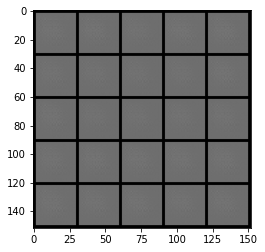

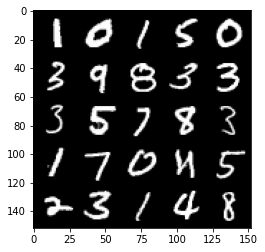

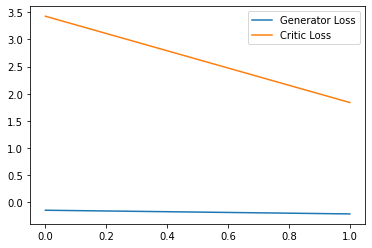

Step 100: Generator loss: 0.7865942335128784, critic loss: -1.6459528888463972


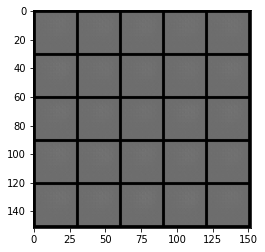

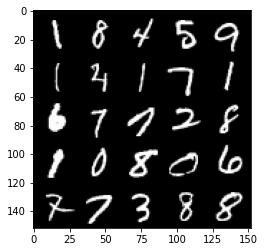

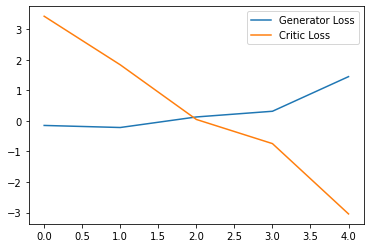

Step 150: Generator loss: 2.828724918216467, critic loss: -11.364627803802492


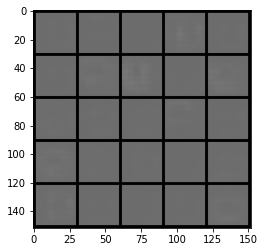

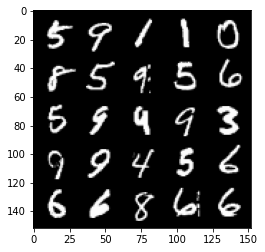

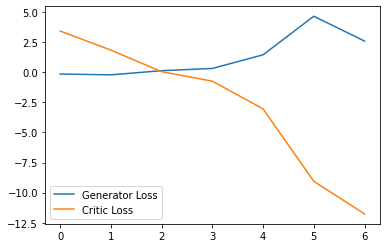

Step 200: Generator loss: -2.02913336455822, critic loss: -27.108507797241213


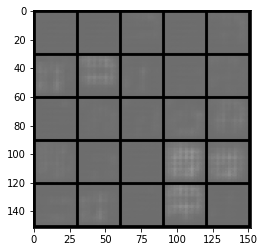

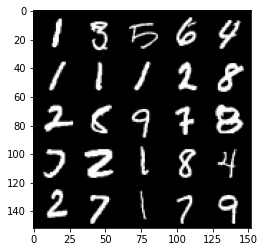

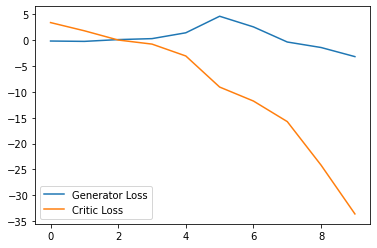

Step 250: Generator loss: -5.232412462234497, critic loss: -56.3893250732422


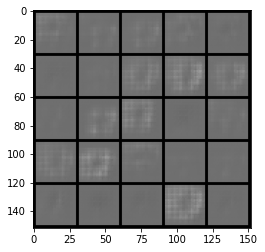

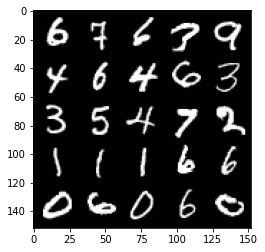

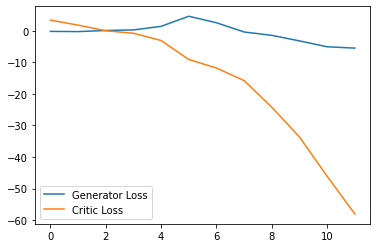

Step 300: Generator loss: -3.0619140788912773, critic loss: -97.9239244995117


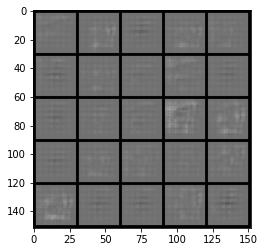

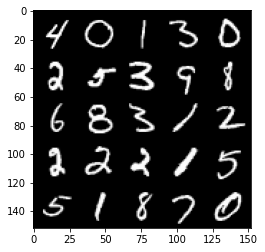

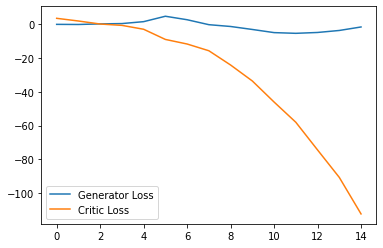

Step 350: Generator loss: -0.07531477864831686, critic loss: -143.51695660400392


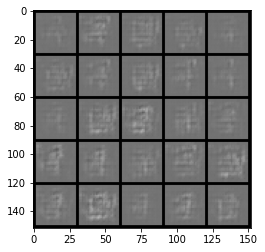

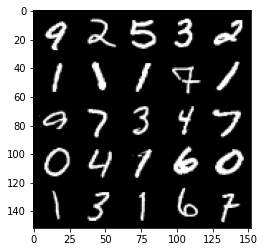

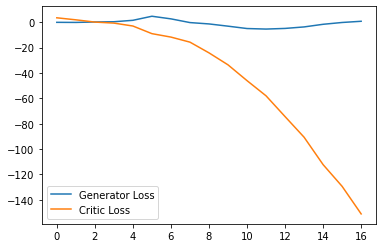

Step 400: Generator loss: -6.3734058138728145, critic loss: -160.98407748413084


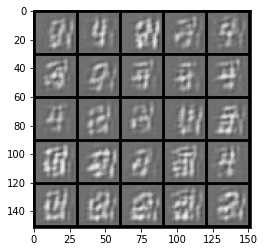

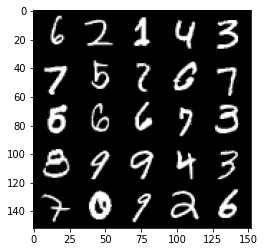

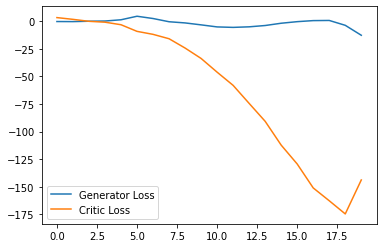

Step 450: Generator loss: -18.69518337726593, critic loss: -144.0201700210571


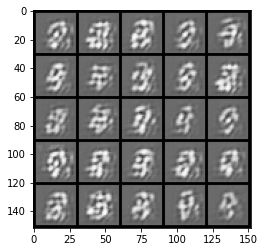

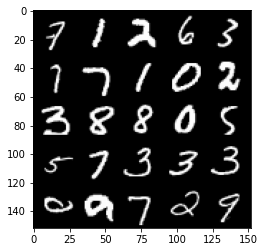

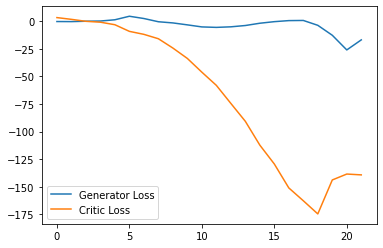

Step 500: Generator loss: 5.302884786128998, critic loss: -200.88836160278322


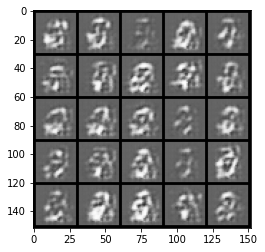

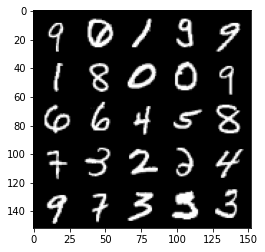

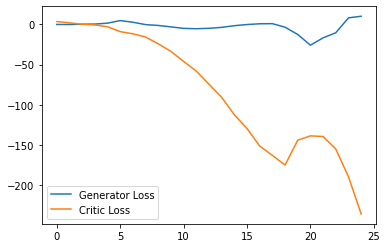

Step 550: Generator loss: 0.4451050738990307, critic loss: -279.5044146118164


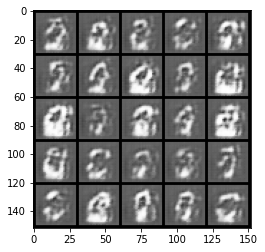

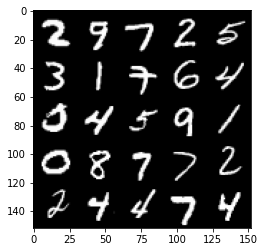

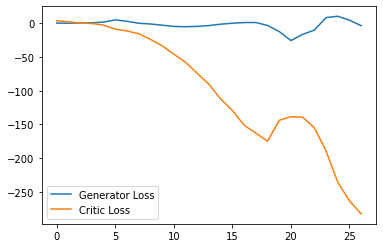

Step 600: Generator loss: -12.13273654937744, critic loss: -230.57957955932622


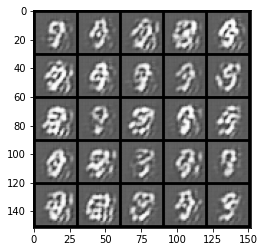

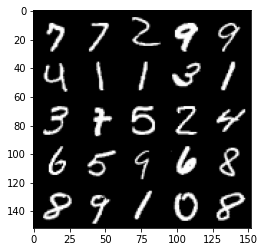

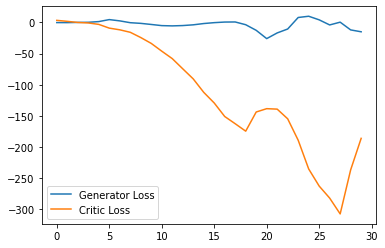

Step 650: Generator loss: -16.631300228834153, critic loss: -214.62806102752685


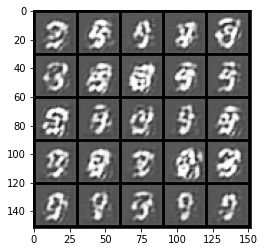

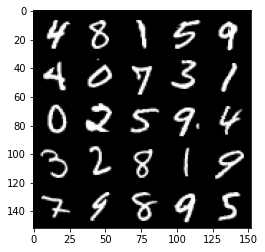

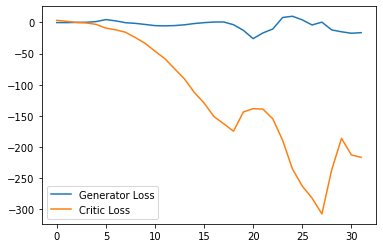

Step 700: Generator loss: -10.960956481397153, critic loss: -215.94118933105472


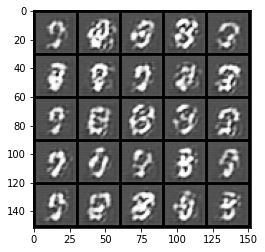

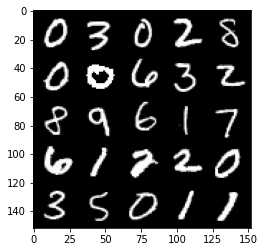

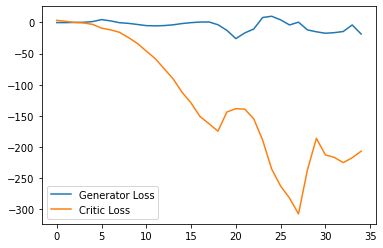

Step 750: Generator loss: -13.045820577144623, critic loss: -213.67436859130868


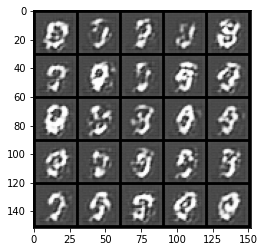

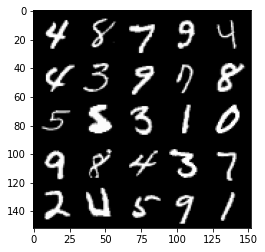

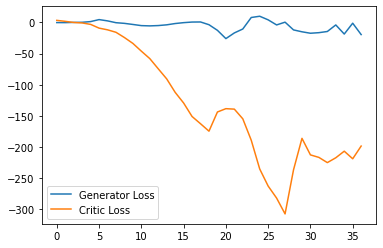

Step 800: Generator loss: -18.466661074757575, critic loss: -173.70403007507323


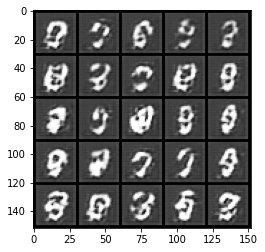

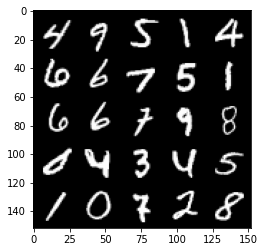

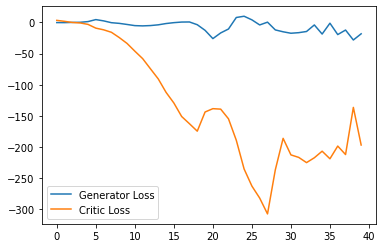

Step 850: Generator loss: -24.676140159368515, critic loss: -104.56456251525879


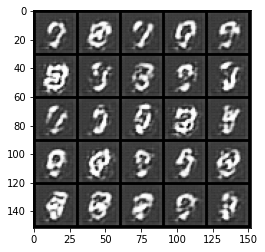

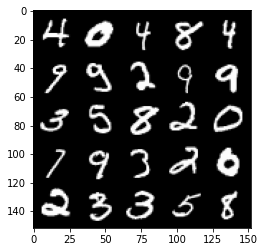

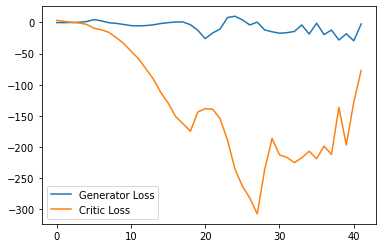

Step 900: Generator loss: -37.770577087402344, critic loss: -143.23140855407715


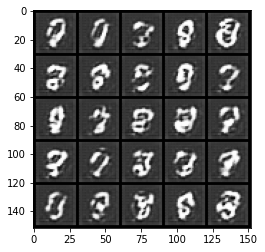

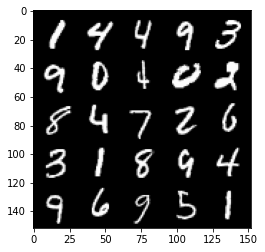

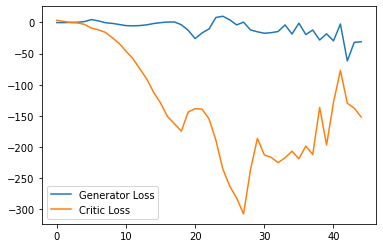

Step 950: Generator loss: -46.25075893402099, critic loss: -94.13183708953862


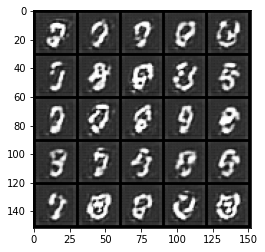

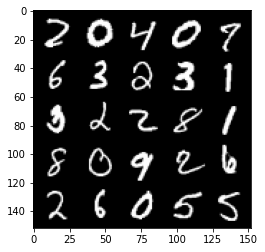

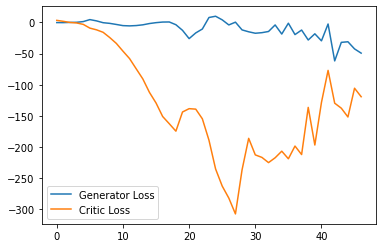

Step 1000: Generator loss: -1.0442679037153721, critic loss: 59.07665941619874


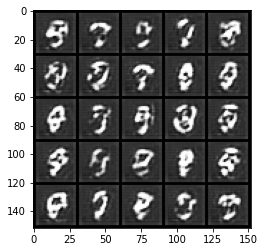

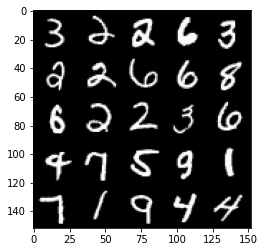

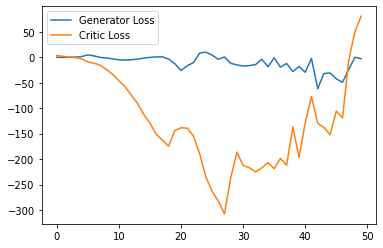

Step 1050: Generator loss: -7.436039390563965, critic loss: 64.81067906951905


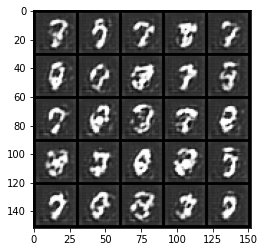

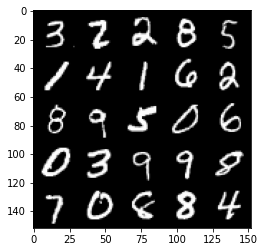

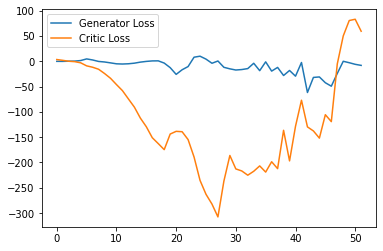

Step 1100: Generator loss: -8.280436897277832, critic loss: 26.60572557830811


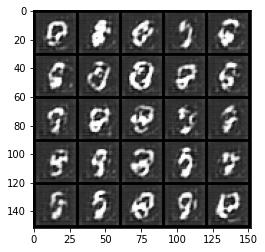

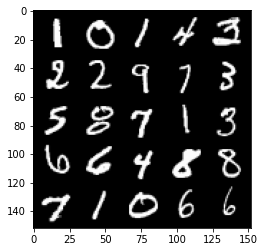

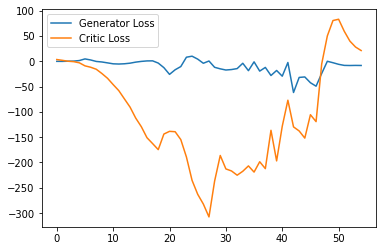

Step 1150: Generator loss: -8.41067193031311, critic loss: 14.680318515777588


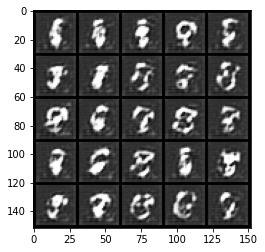

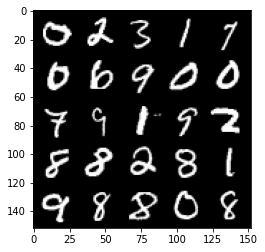

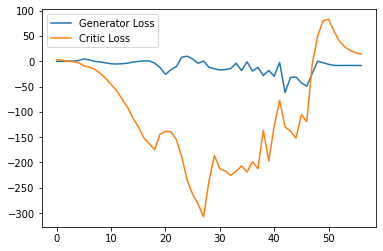

Step 1200: Generator loss: -8.518729124069214, critic loss: 10.62205194091797


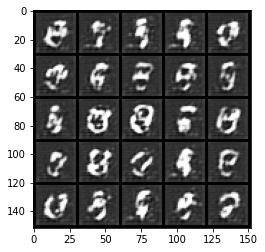

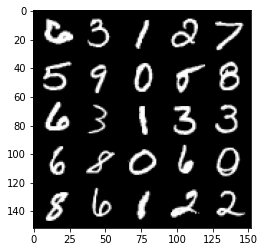

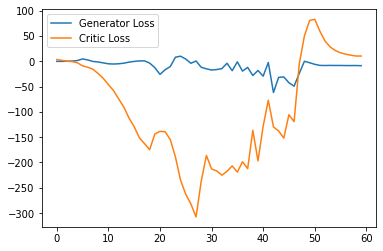

Step 1250: Generator loss: -8.934622344970704, critic loss: 10.834645399093626


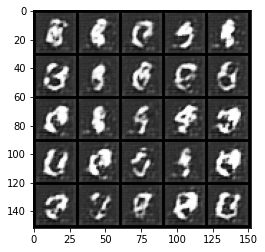

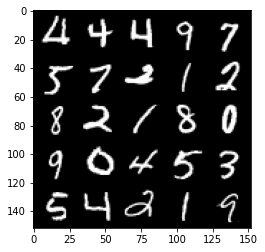

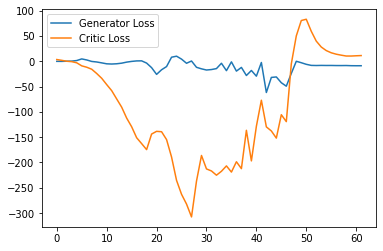

Step 1300: Generator loss: -9.053403778076172, critic loss: 10.54445083618164


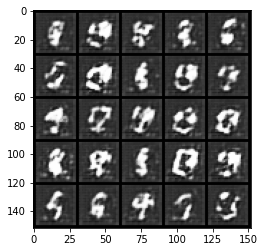

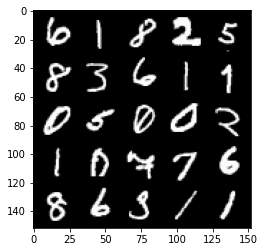

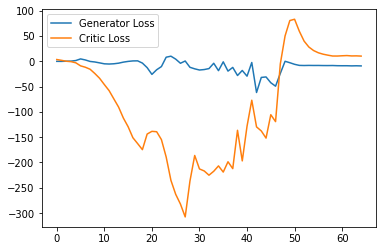

Step 1350: Generator loss: -9.404076919555663, critic loss: 9.46572822761536


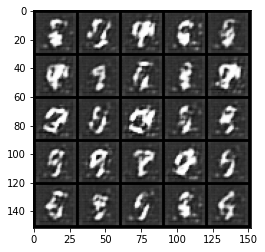

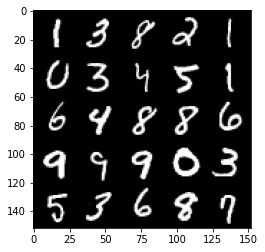

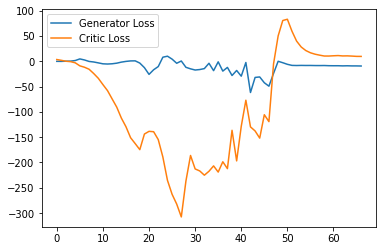

Step 1400: Generator loss: -10.209049139022827, critic loss: 6.9927723121643055


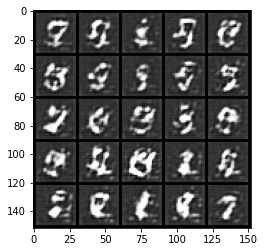

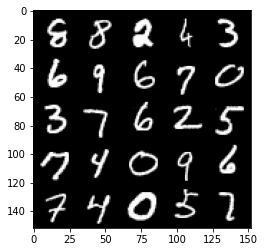

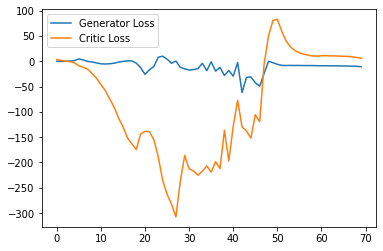

Step 1450: Generator loss: -10.06713749885559, critic loss: 2.7185344409942616


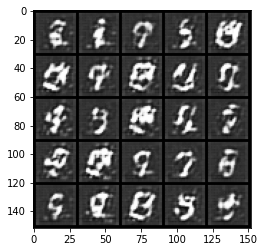

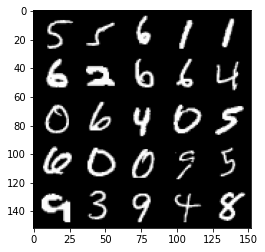

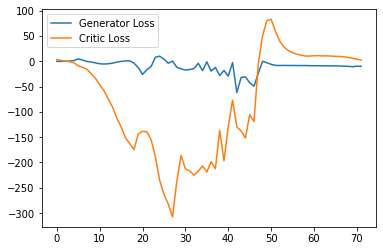

Step 1500: Generator loss: -10.126048164367676, critic loss: -1.0339348354339597


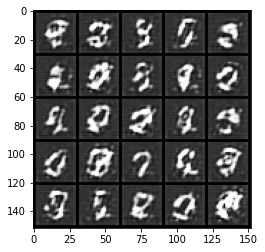

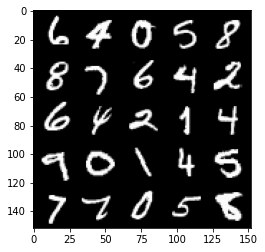

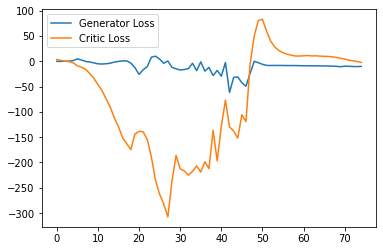

Step 1550: Generator loss: -10.084412956237793, critic loss: -3.8770852127075197


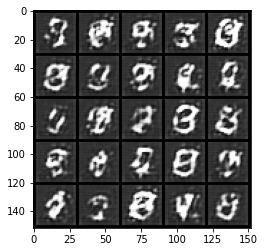

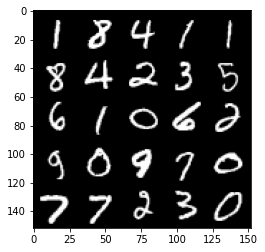

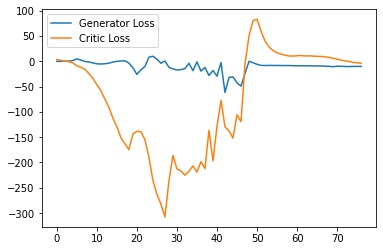

Step 1600: Generator loss: -9.676663370132447, critic loss: -6.992429395675658


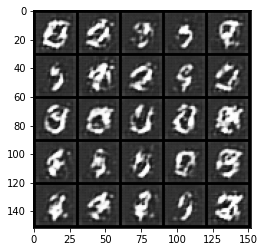

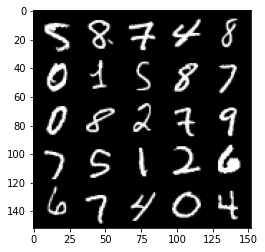

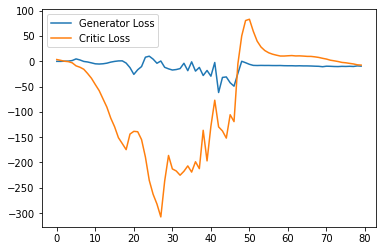

Step 1650: Generator loss: -9.482301750183105, critic loss: -9.202550361633302


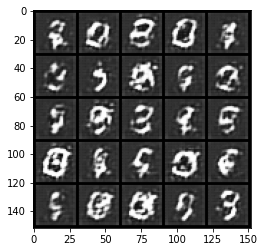

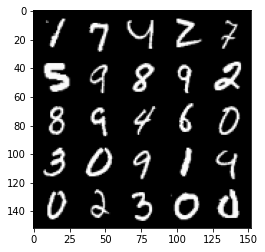

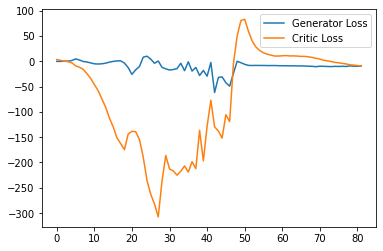

Step 1700: Generator loss: -9.571049308776855, critic loss: -10.950691646575926


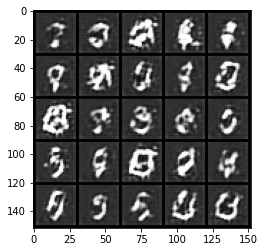

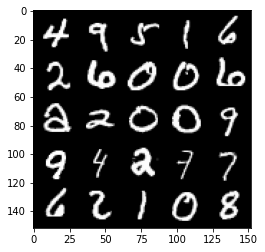

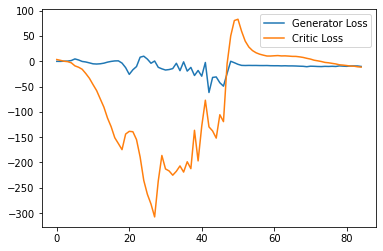

Step 1750: Generator loss: -9.800691208839417, critic loss: -13.672022426605224


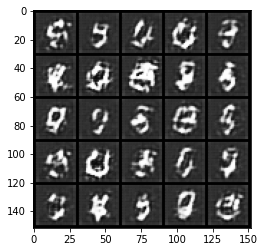

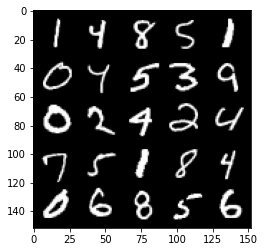

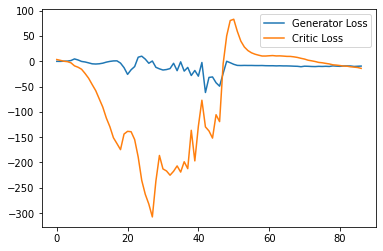

Step 1800: Generator loss: -8.467924724221229, critic loss: -16.01551348876953


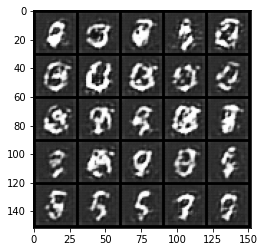

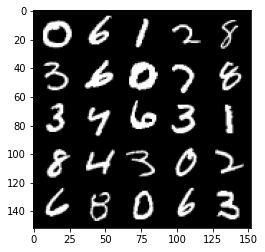

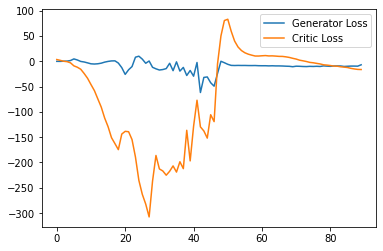

Step 1850: Generator loss: -8.550509243011474, critic loss: -17.879624109268192


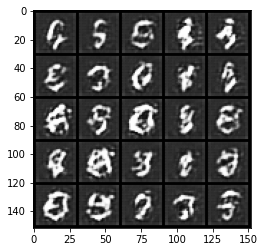

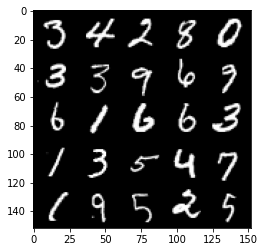

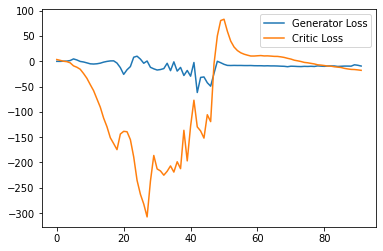

Step 1900: Generator loss: -7.181920095682144, critic loss: -17.772558359146117


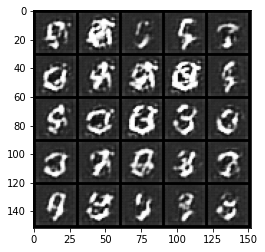

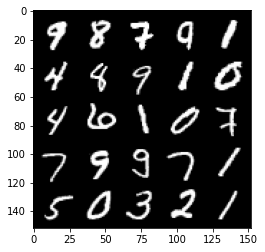

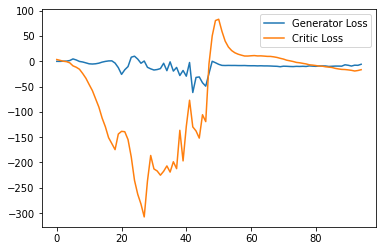

Step 1950: Generator loss: -7.251278371810913, critic loss: -18.36509766387939


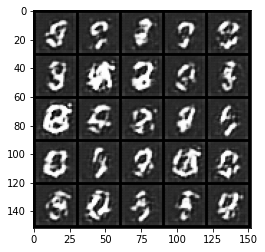

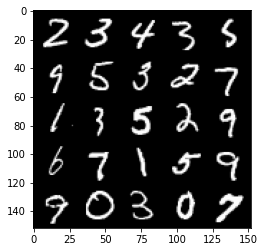

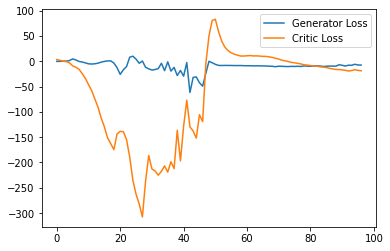

Step 2000: Generator loss: -6.99229611158371, critic loss: -14.833729950904845


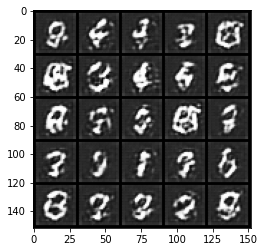

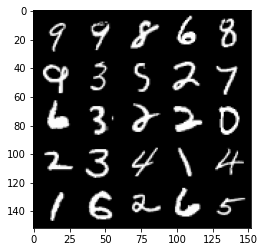

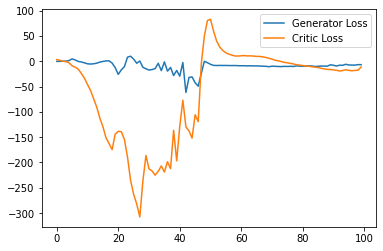

Step 2050: Generator loss: -8.163530626296996, critic loss: -15.281611026763919


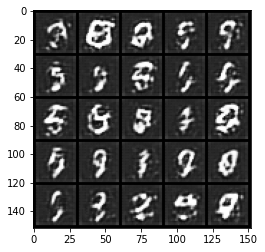

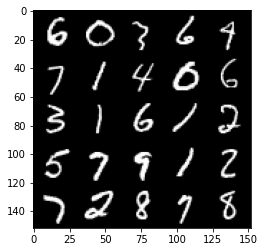

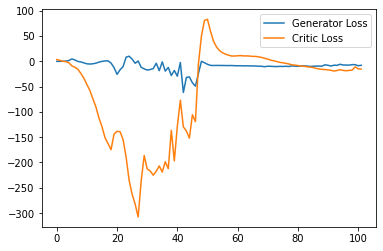

Step 2100: Generator loss: -7.15901819229126, critic loss: -16.223534294128417


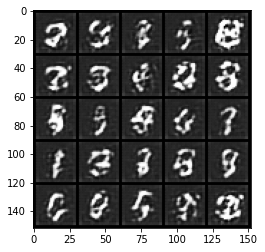

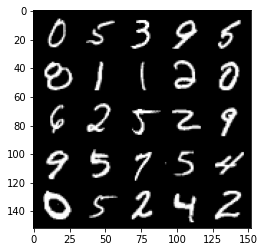

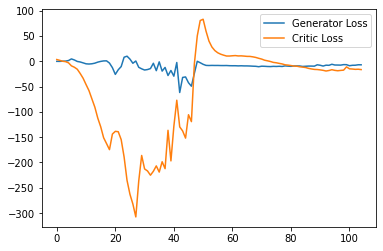

Step 2150: Generator loss: -7.0488921910524365, critic loss: -16.876438100814813


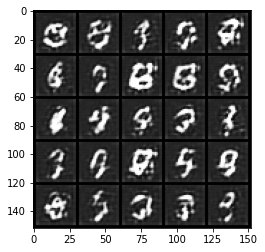

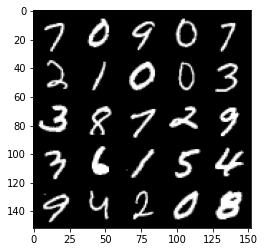

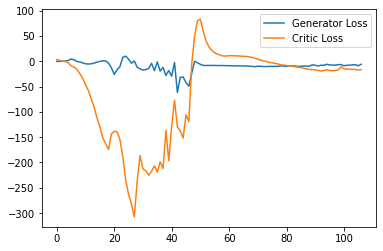

Step 2200: Generator loss: -6.892155463695526, critic loss: -17.79504201316833


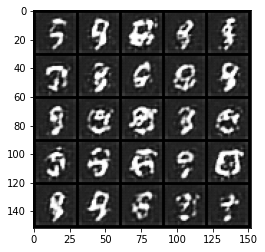

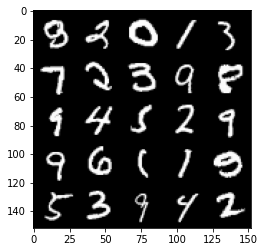

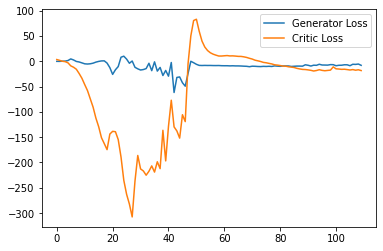

Step 2250: Generator loss: -7.965768115222454, critic loss: -17.58916937923431


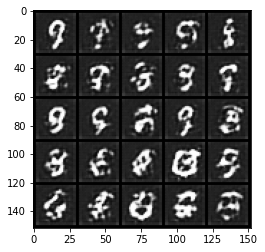

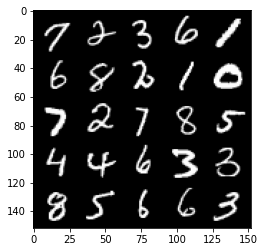

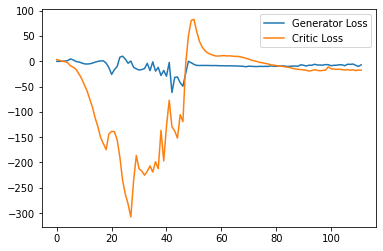

Step 2300: Generator loss: -7.183546395301819, critic loss: -9.811425484180448


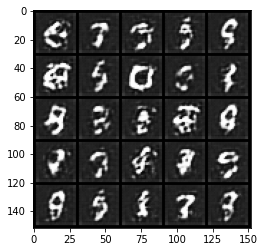

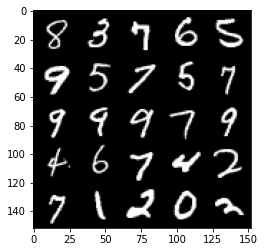

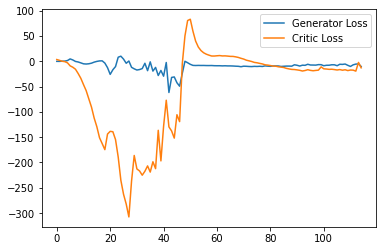

Step 2350: Generator loss: -6.471021480560303, critic loss: -2.101779076576233


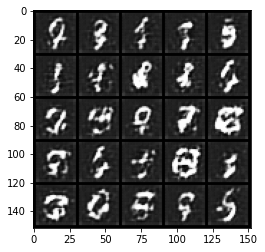

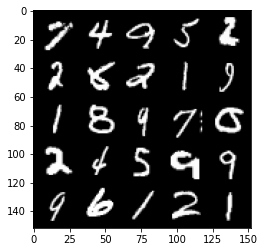

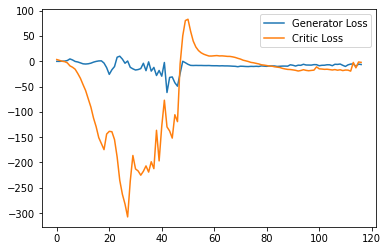

Step 2400: Generator loss: -12.652469778060913, critic loss: -15.434488096237187


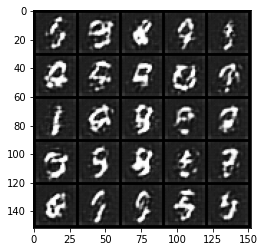

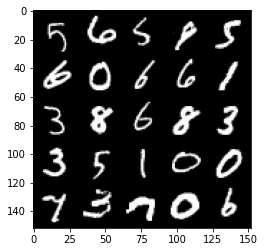

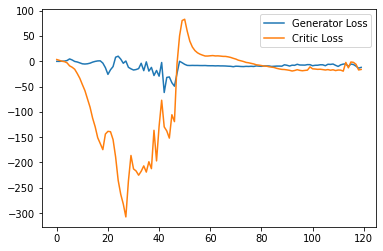

Step 2450: Generator loss: -12.400864760875702, critic loss: -16.24032045173645


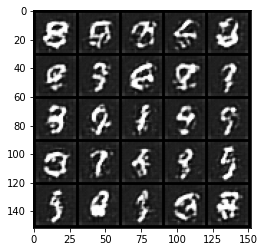

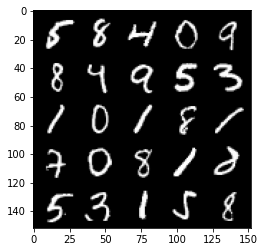

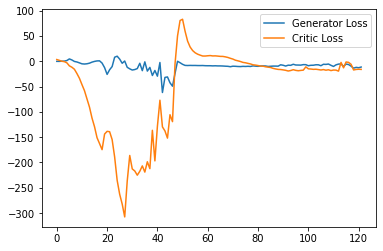

Step 2500: Generator loss: -8.957154130935669, critic loss: -8.795505773067473


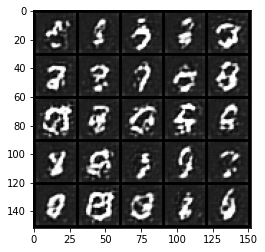

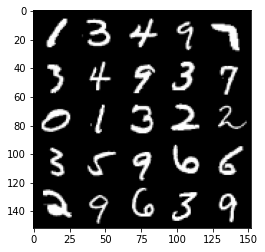

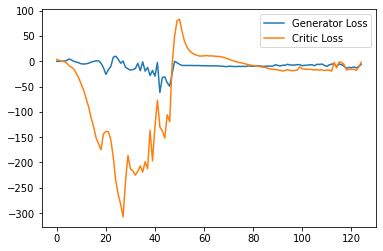

Step 2550: Generator loss: -10.774468393325806, critic loss: -6.153461034774778


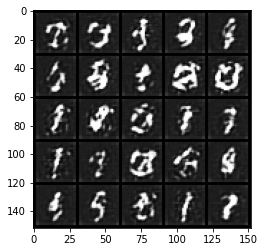

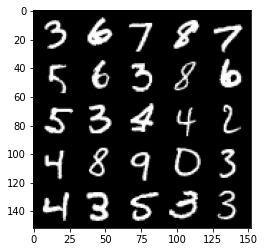

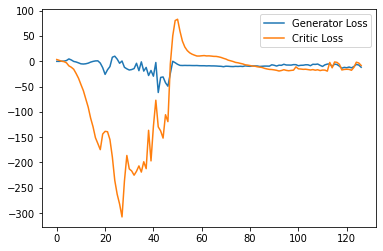

Step 2600: Generator loss: -8.500064678192139, critic loss: -1.9977570452690125


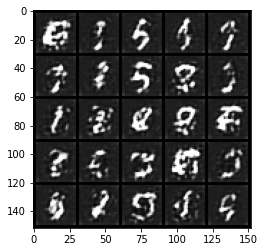

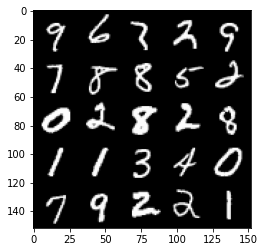

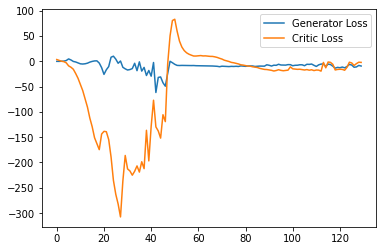

Step 2650: Generator loss: -13.155023136138915, critic loss: -9.082474369049072


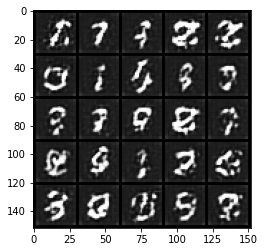

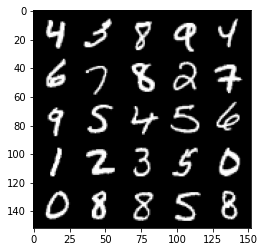

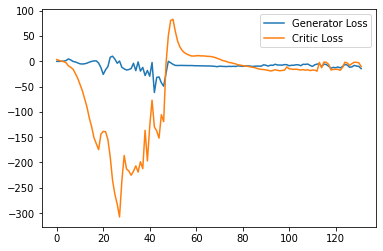

Step 2700: Generator loss: -11.669651746749878, critic loss: -12.670292538642881


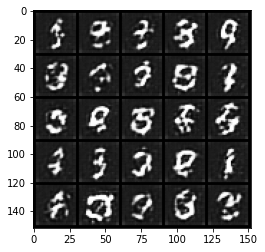

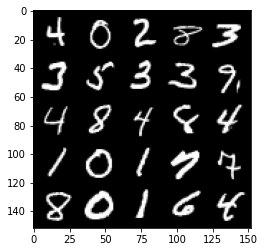

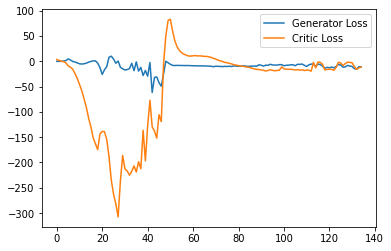

Step 2750: Generator loss: -9.236843295097351, critic loss: -11.00005115890503


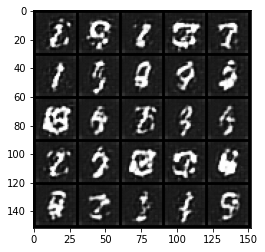

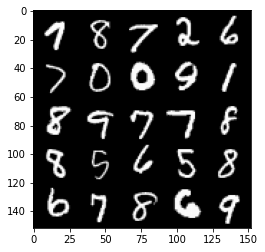

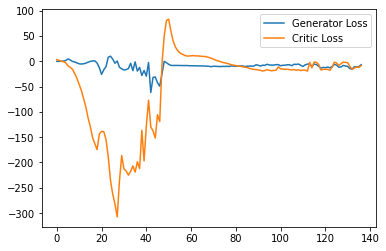

Step 2800: Generator loss: -12.930137839317322, critic loss: -15.303617096900943


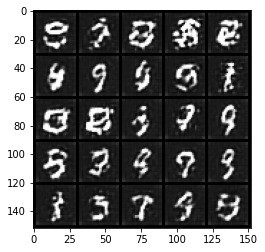

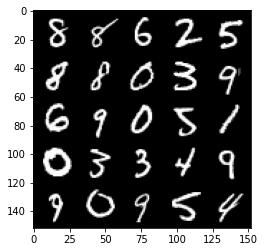

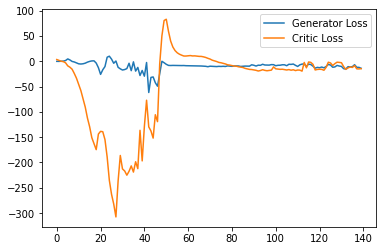

Step 2850: Generator loss: -10.125235247612, critic loss: -13.547313101768498


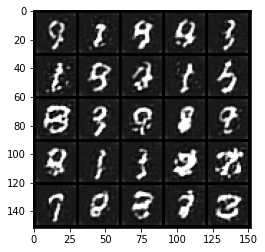

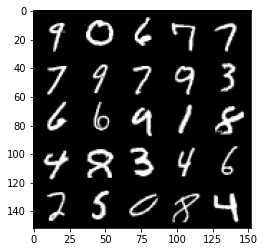

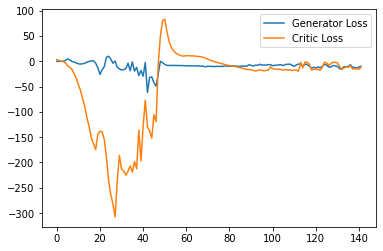

Step 2900: Generator loss: -8.674877600669861, critic loss: -9.735619100570677


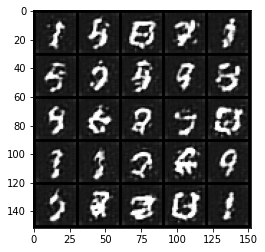

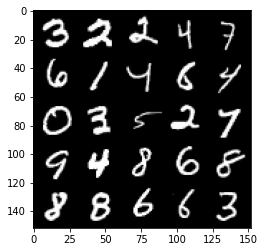

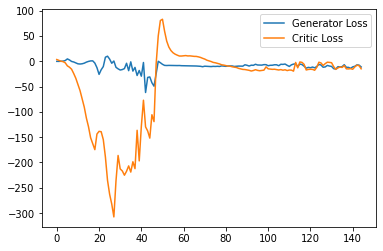

Step 2950: Generator loss: -10.388113459348679, critic loss: -12.035283081054683


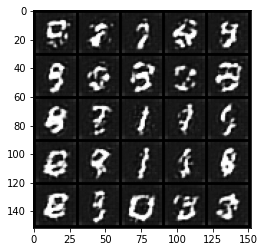

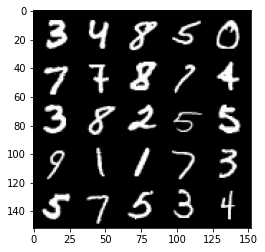

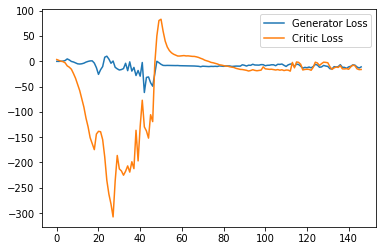

Step 3000: Generator loss: -6.963101825714111, critic loss: -2.485630291938782


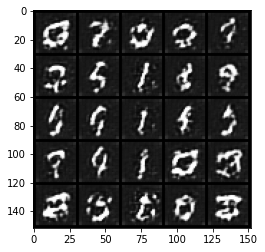

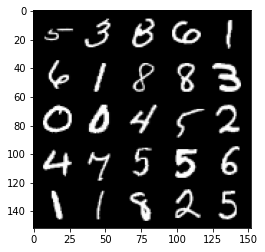

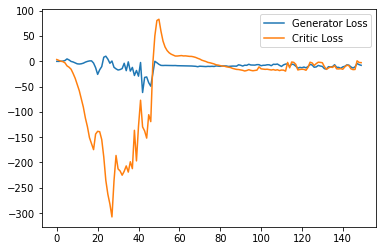

Step 3050: Generator loss: -11.891127681732177, critic loss: -6.390333600044249


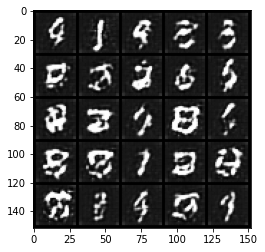

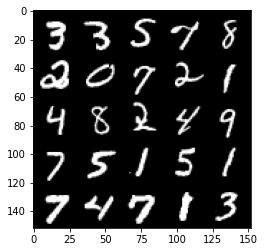

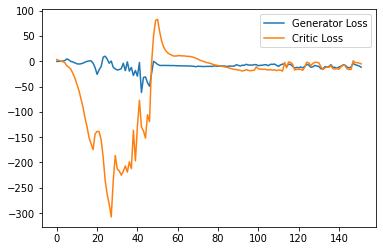

Step 3100: Generator loss: -16.464475212097167, critic loss: -15.95549674510956


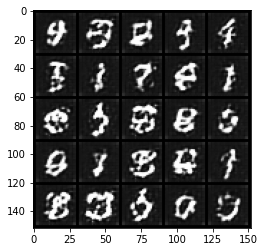

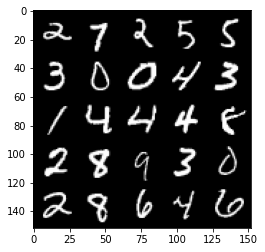

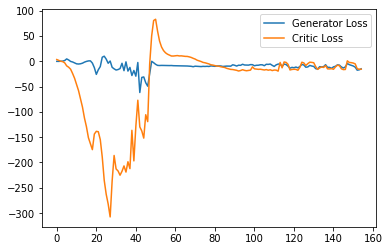

Step 3150: Generator loss: -9.289050369262695, critic loss: -6.933850435256956


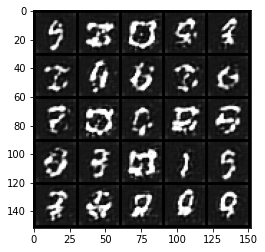

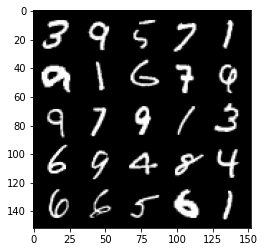

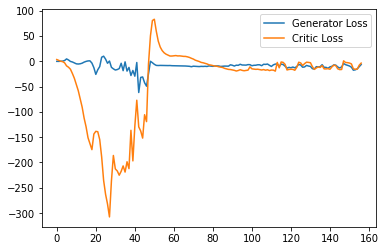

Step 3200: Generator loss: -16.369563398361205, critic loss: -15.375222496986385


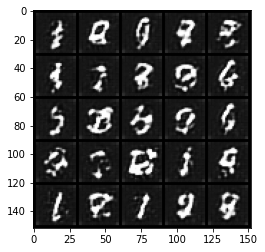

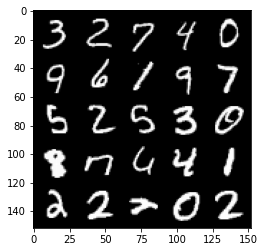

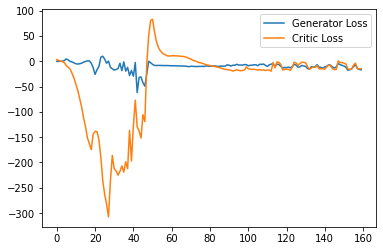

Step 3250: Generator loss: -9.080971145629883, critic loss: -4.144281525611877


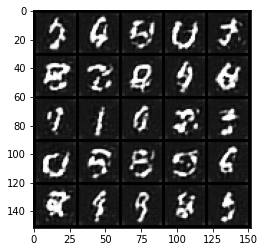

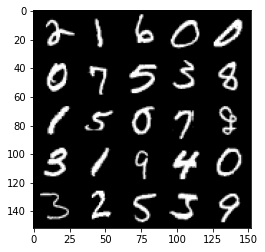

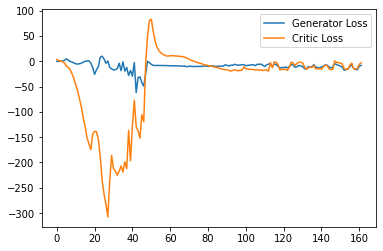

Step 3300: Generator loss: -16.548734264373778, critic loss: -14.2781329369545


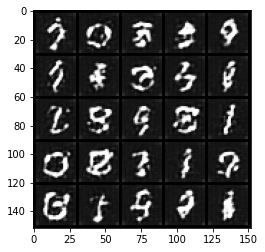

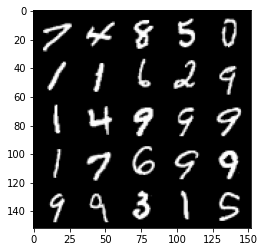

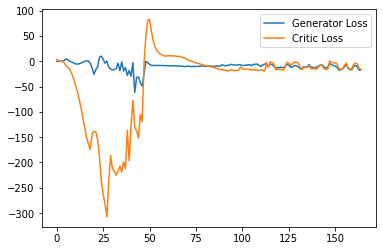

Step 3350: Generator loss: -14.433388957977295, critic loss: -13.008308204650875


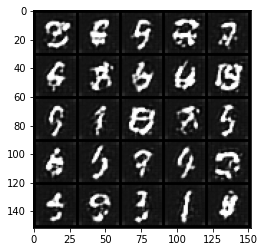

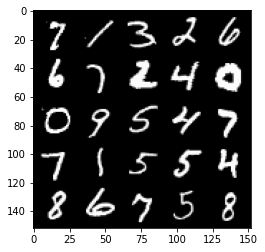

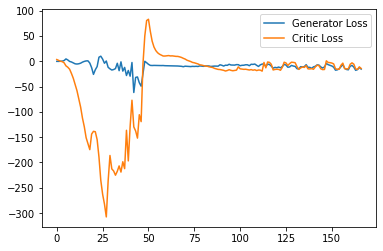

Step 3400: Generator loss: -13.287921152114869, critic loss: -15.946898540973661


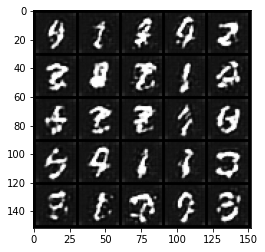

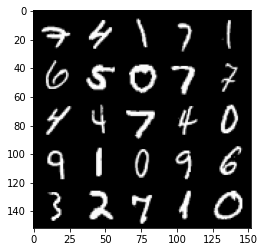

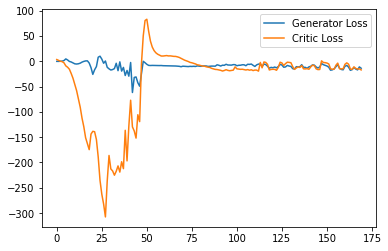

Step 3450: Generator loss: -10.312031421661377, critic loss: -9.957081536293028


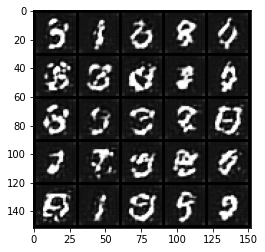

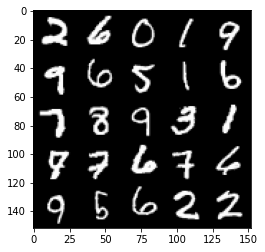

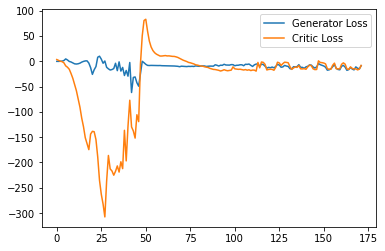

Step 3500: Generator loss: -10.455159881114959, critic loss: -9.473074698448182


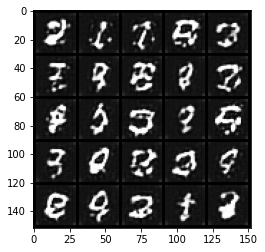

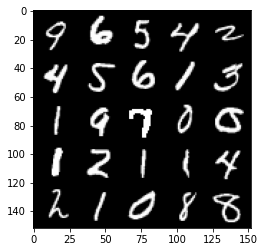

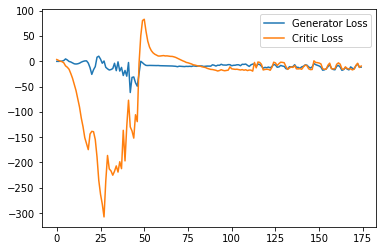

Step 3550: Generator loss: -6.623102531433106, critic loss: -3.345234666824341


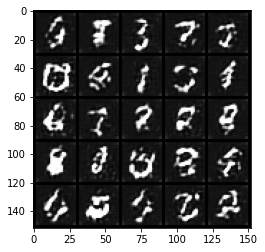

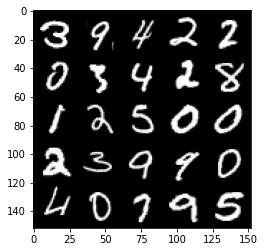

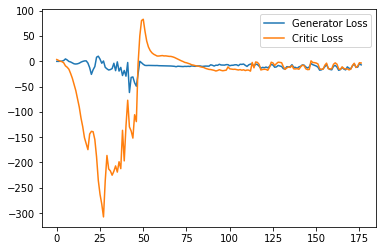

Step 3600: Generator loss: -15.044821071624757, critic loss: -14.410059076309203


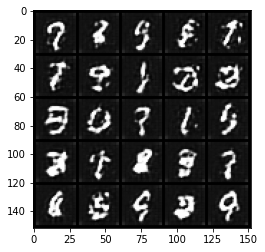

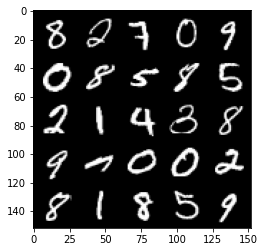

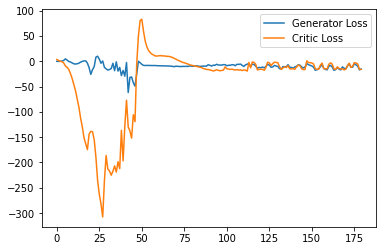

Step 3650: Generator loss: -9.39902412891388, critic loss: -5.407375923871995


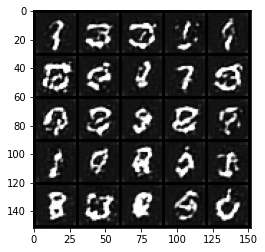

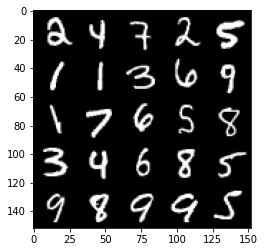

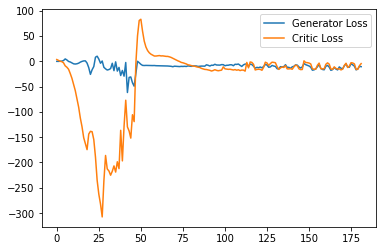

Step 3700: Generator loss: -6.681734075546265, critic loss: -2.5665014538764956


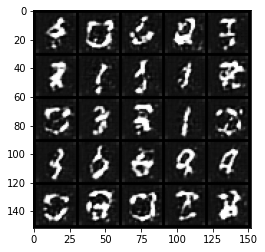

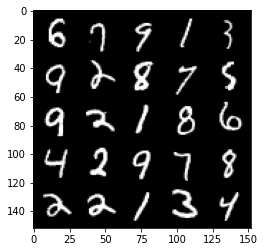

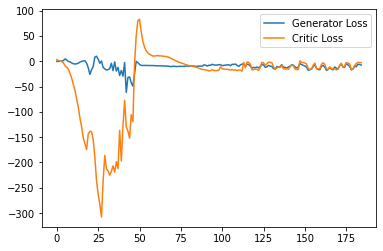

Step 3750: Generator loss: -11.568487586975097, critic loss: -6.030041780471802


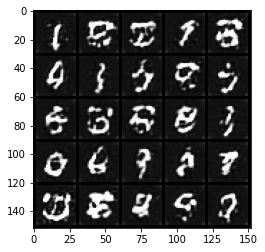

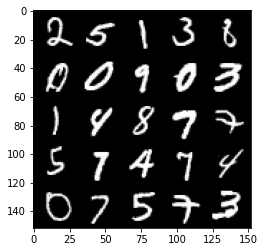

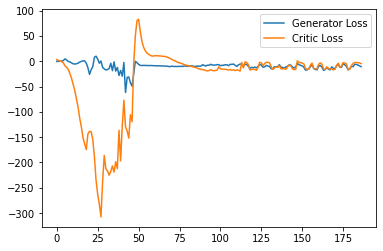

Step 3800: Generator loss: -10.017727537155151, critic loss: -6.791830808639526


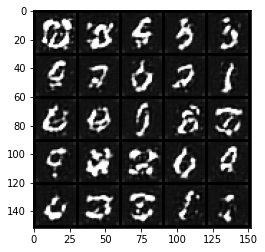

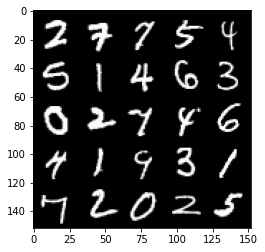

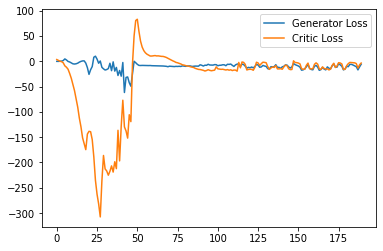

Step 3850: Generator loss: -14.438726530075073, critic loss: -14.479638095855712


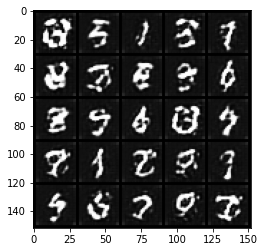

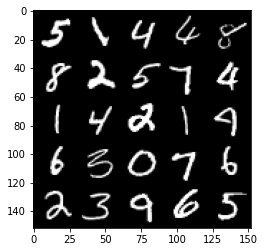

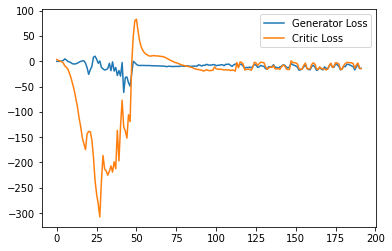

Step 3900: Generator loss: -11.69409562855959, critic loss: -14.514135344982144


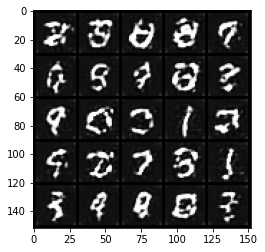

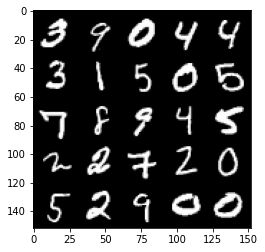

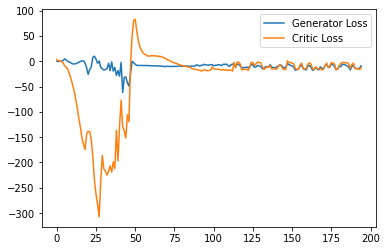

Step 3950: Generator loss: -8.258119230270387, critic loss: -4.98394772052765


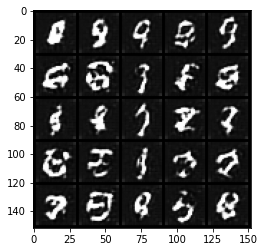

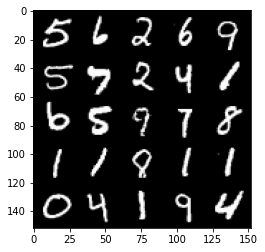

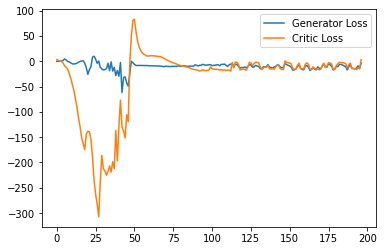

Step 4000: Generator loss: -6.926359701156616, critic loss: -2.2872308101654046


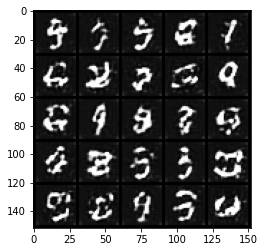

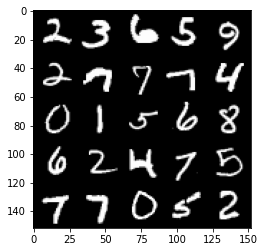

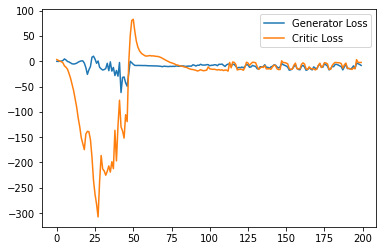

Step 4050: Generator loss: -9.010184364318848, critic loss: -2.8401476526260376


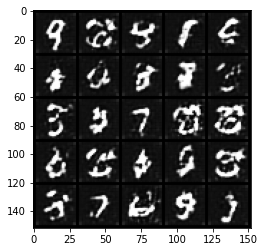

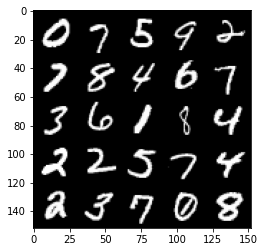

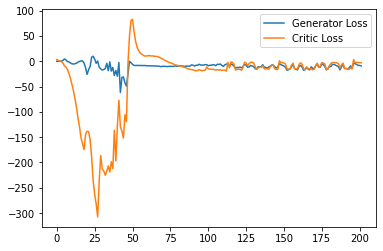

Step 4100: Generator loss: -14.33965181350708, critic loss: -8.614504294395447


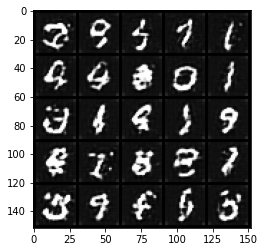

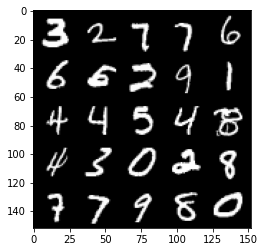

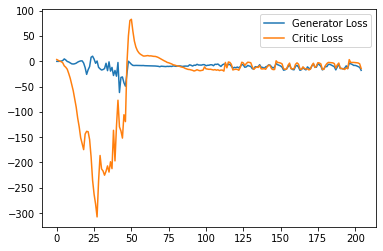

Step 4150: Generator loss: -10.080616798400879, critic loss: -4.498720017671586


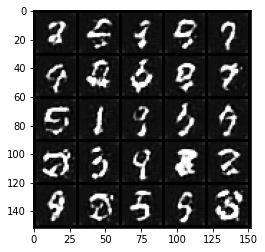

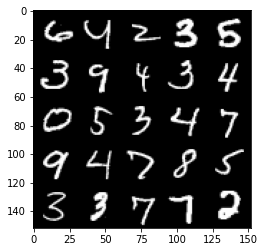

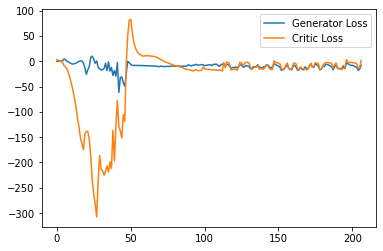

Step 4200: Generator loss: -7.896771049499511, critic loss: -2.598293525695802


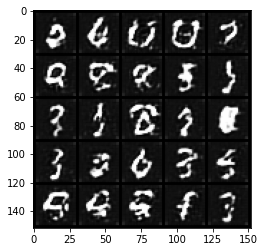

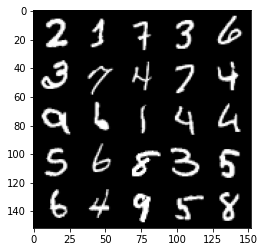

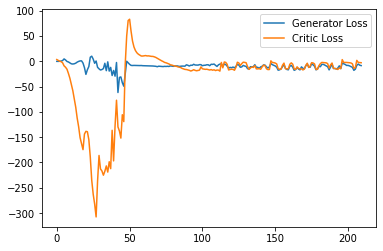

Step 4250: Generator loss: -12.698798027038574, critic loss: -5.70222958278656


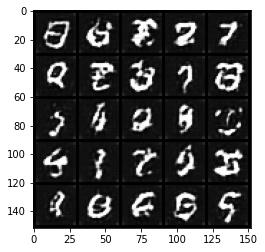

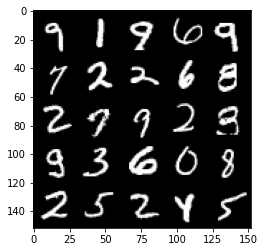

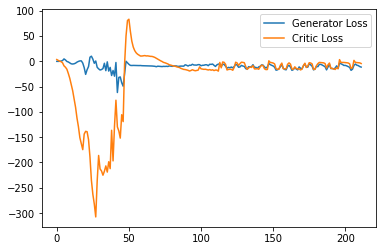

Step 4300: Generator loss: -12.73994533240795, critic loss: -9.200313083648684


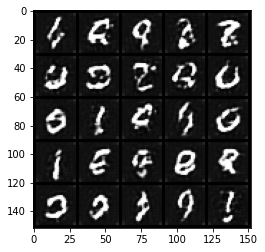

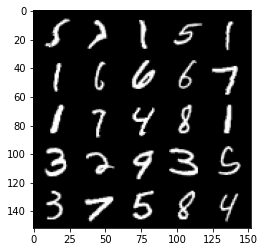

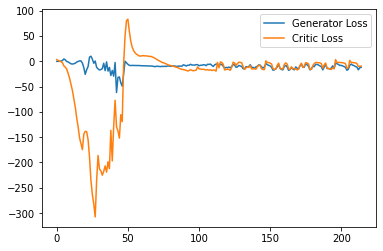

Step 4350: Generator loss: -14.15968789100647, critic loss: -9.308713847637176


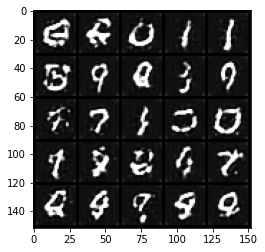

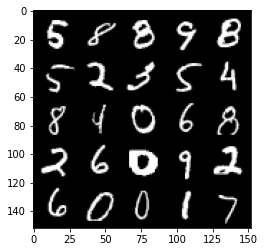

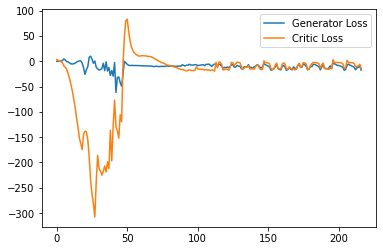

Step 4400: Generator loss: -8.034483718872071, critic loss: -1.9556354765892028


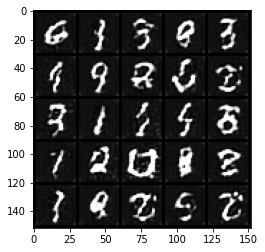

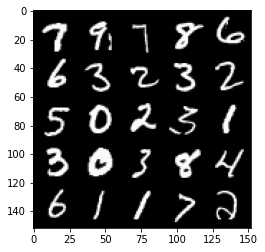

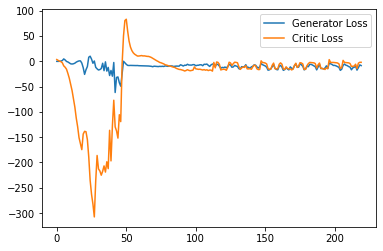

Step 4450: Generator loss: -10.182898826599121, critic loss: -2.443886260032654


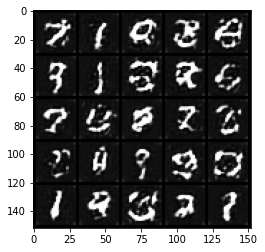

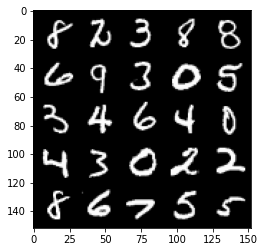

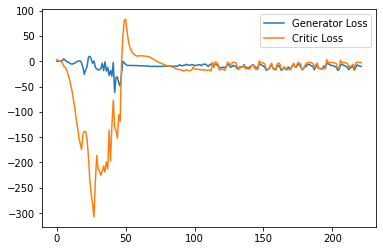

Step 4500: Generator loss: -13.762620906829834, critic loss: -5.5095127096176135


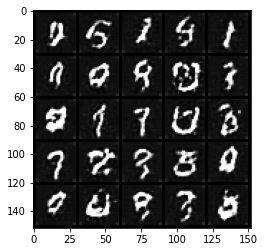

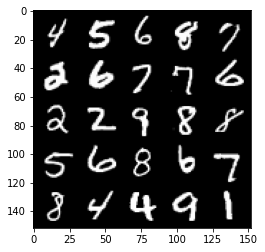

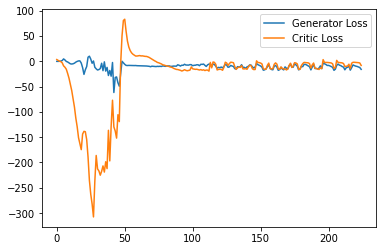

Step 4550: Generator loss: -16.09101587295532, critic loss: -8.990457978963851


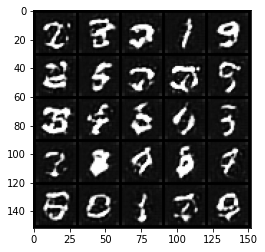

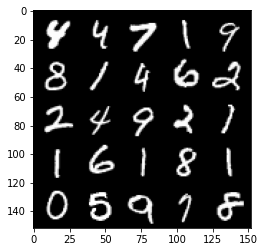

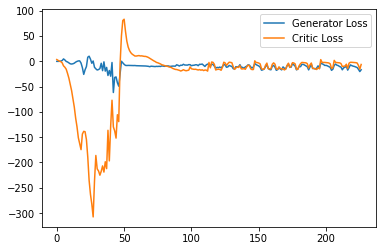

Step 4600: Generator loss: -9.007684831619263, critic loss: -2.3672862968444823


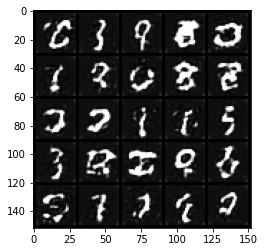

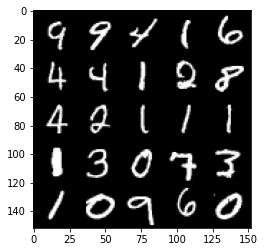

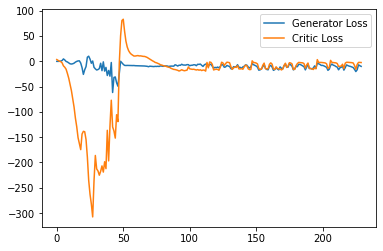

Step 4650: Generator loss: -12.813432788848877, critic loss: -4.559819496154785


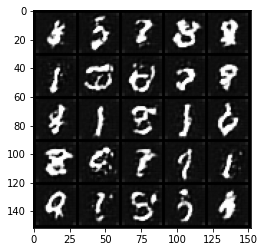

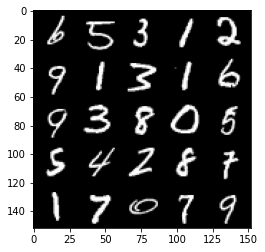

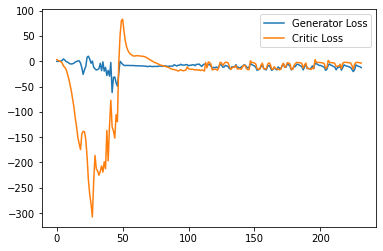

Step 4700: Generator loss: -14.141188163757324, critic loss: -7.97221873807907


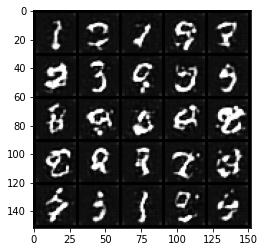

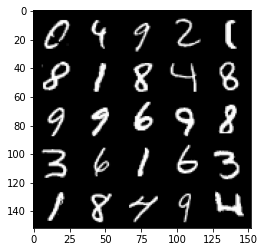

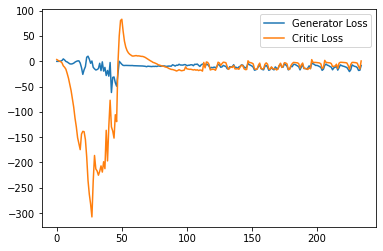

Step 4750: Generator loss: -12.191993389129639, critic loss: -4.139442817687987


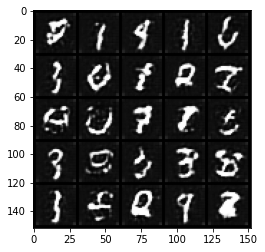

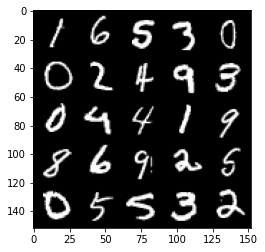

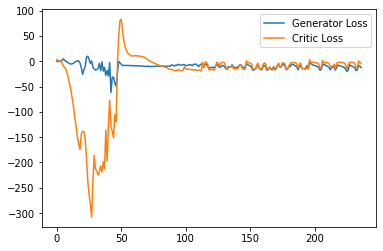

Step 4800: Generator loss: -18.34514513015747, critic loss: -13.606070957660675


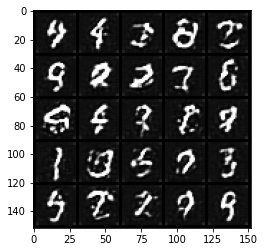

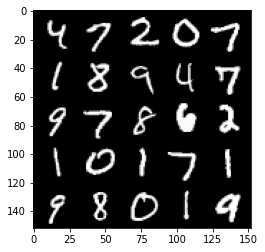

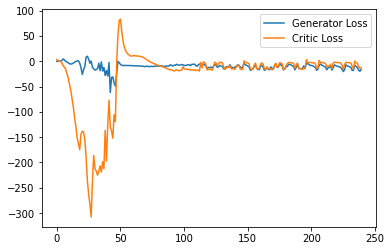

Step 4850: Generator loss: -16.826503458023073, critic loss: -14.580878637790674


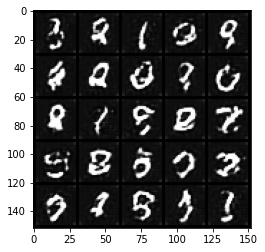

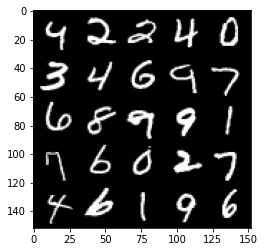

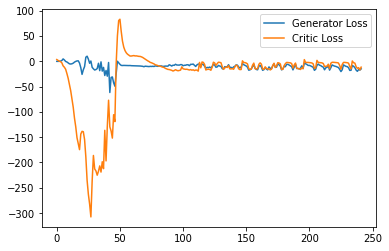

Step 4900: Generator loss: -18.170172882080077, critic loss: -10.945130173683161


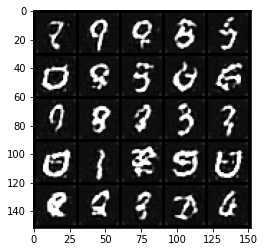

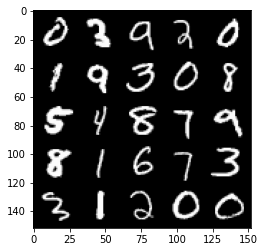

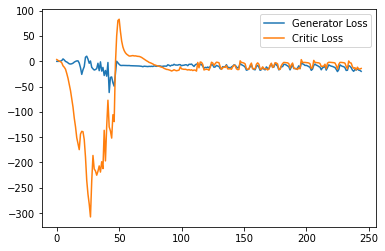

Step 4950: Generator loss: -10.701319198608399, critic loss: -1.989877484321594


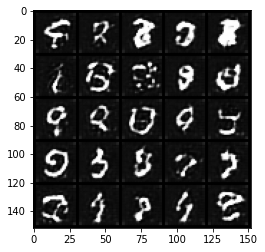

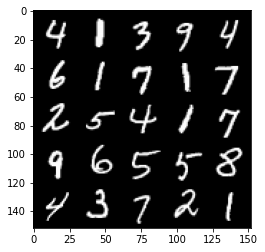

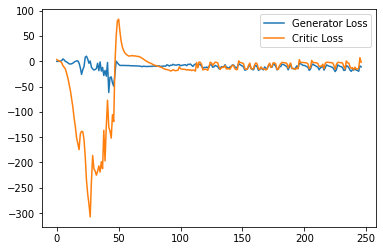

Step 5000: Generator loss: -14.201634578704834, critic loss: -2.1143829531669613


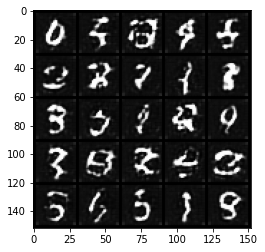

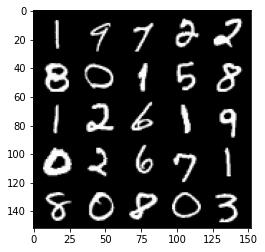

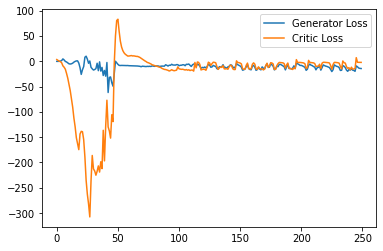

Step 5050: Generator loss: -16.24870735168457, critic loss: -2.42405357837677


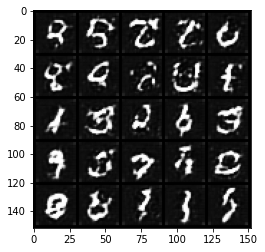

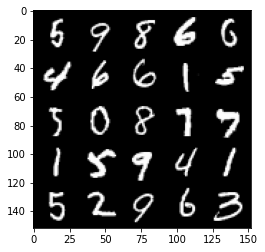

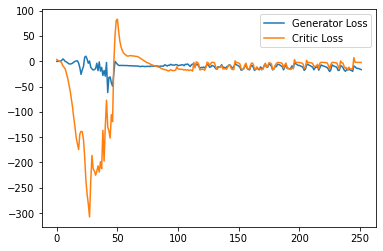

Step 5100: Generator loss: -16.95802541732788, critic loss: -3.3384968709945677


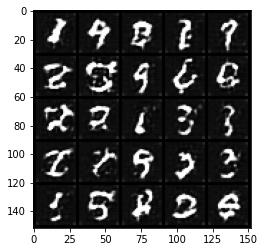

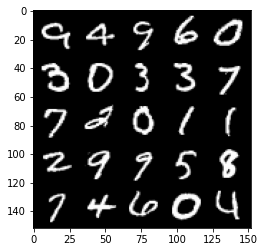

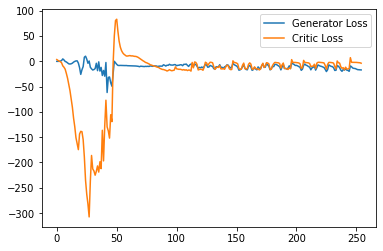

Step 5150: Generator loss: -18.178432674407958, critic loss: -5.932737384796144


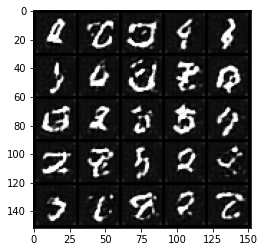

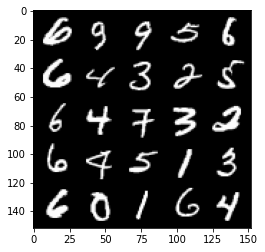

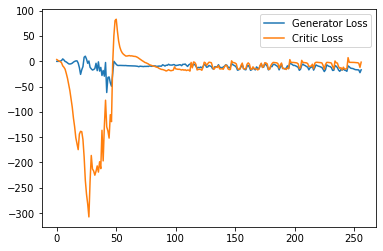

Step 5200: Generator loss: -14.813614826202393, critic loss: -2.5718460674285883


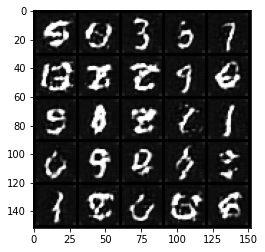

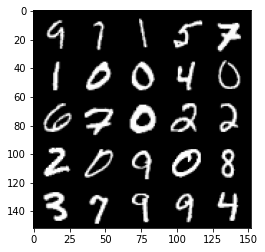

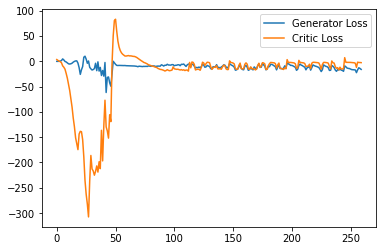

Step 5250: Generator loss: -21.480286445617676, critic loss: -3.2518318605422984


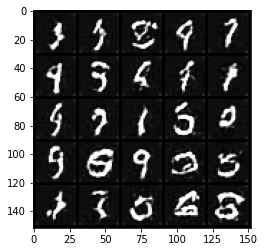

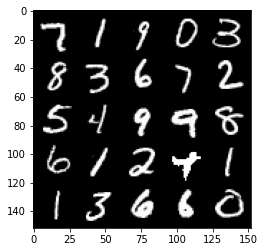

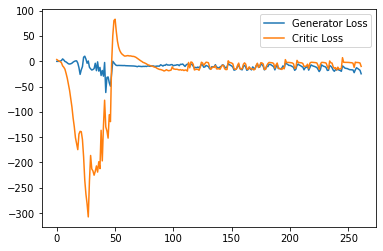

Step 5300: Generator loss: -15.580425262451172, critic loss: -1.7421270780563347


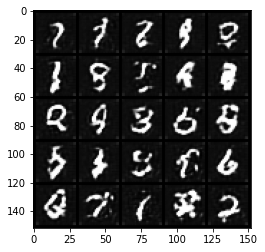

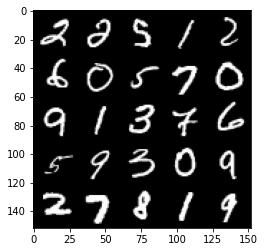

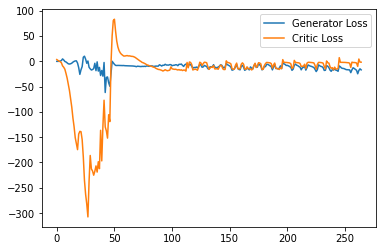

Step 5350: Generator loss: -18.93815082550049, critic loss: -1.8859124426841734


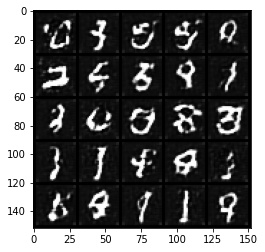

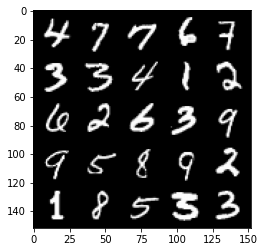

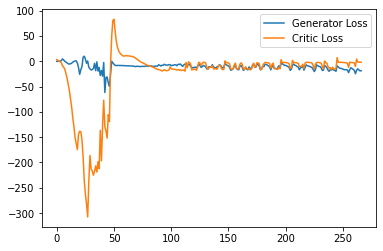

Step 5400: Generator loss: -20.2495414352417, critic loss: -2.311702588081359


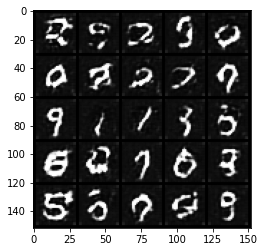

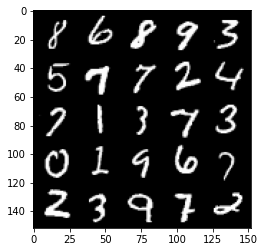

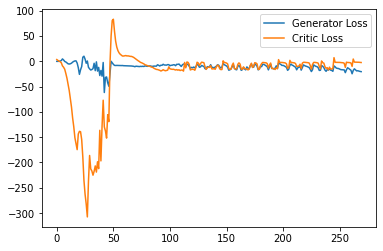

Step 5450: Generator loss: -21.17935733795166, critic loss: -3.185592210769653


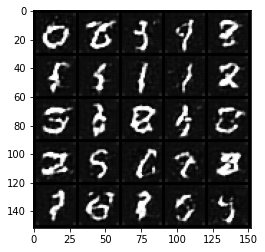

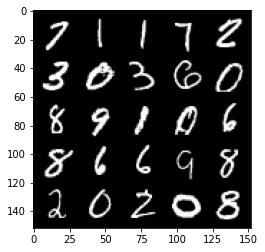

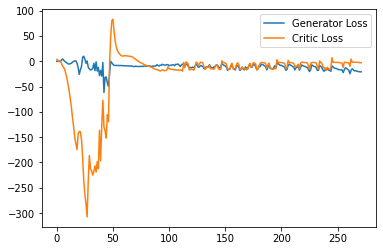

Step 5500: Generator loss: -24.37367778778076, critic loss: -9.41698754644394


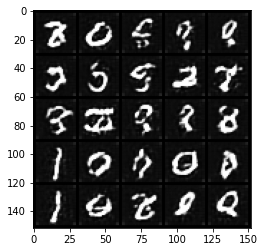

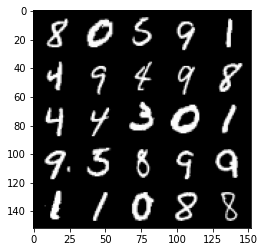

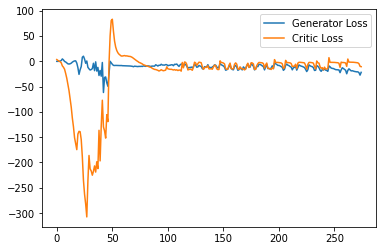

Step 5550: Generator loss: -26.92624502182007, critic loss: -14.312186826229093


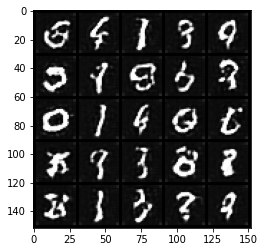

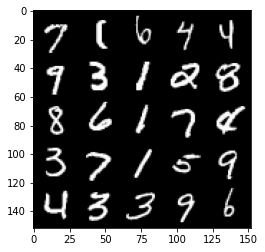

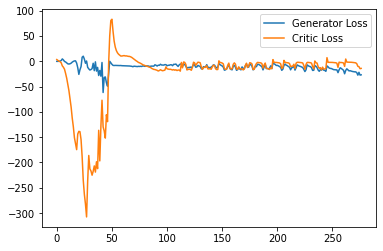

Step 5600: Generator loss: -22.816656131744384, critic loss: -6.940711803913116


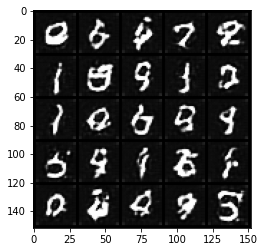

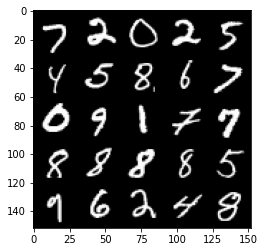

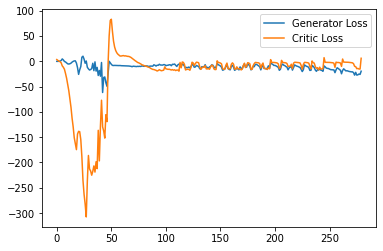

Step 5650: Generator loss: -16.23259080886841, critic loss: -1.7740896663665768


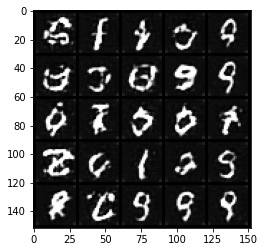

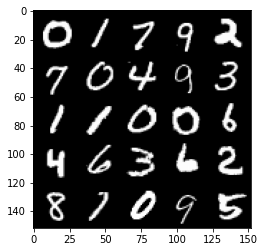

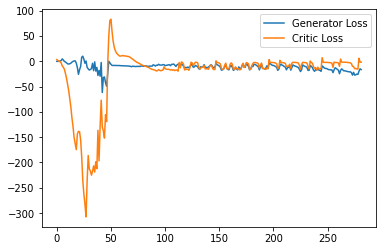

Step 5700: Generator loss: -18.865267028808592, critic loss: -1.8617282805442812


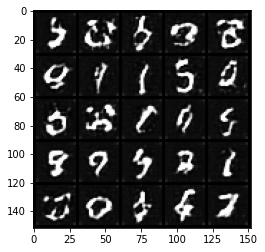

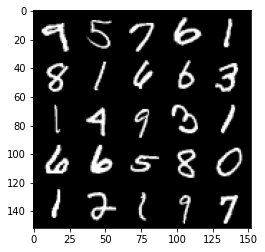

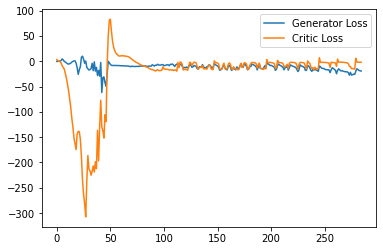

Step 5750: Generator loss: -20.620143280029296, critic loss: -1.9884567270278932


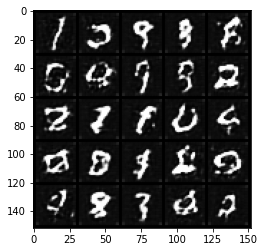

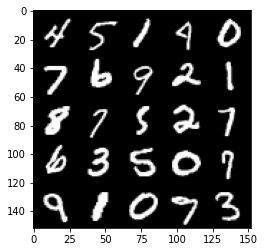

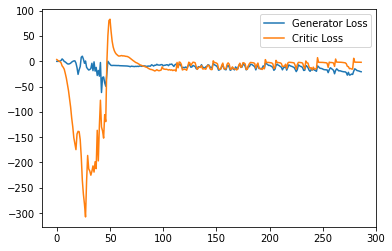

Step 5800: Generator loss: -21.371962471008302, critic loss: -2.17898437166214


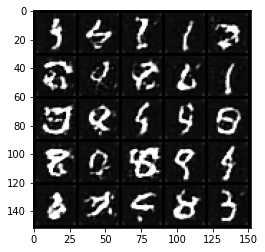

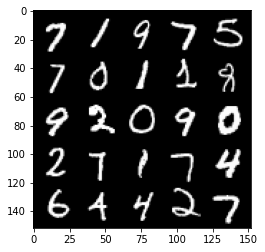

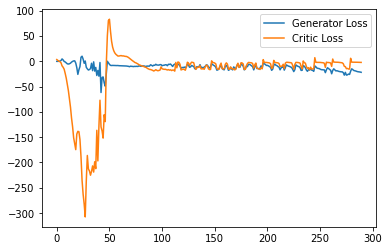

Step 5850: Generator loss: -22.32824733734131, critic loss: -2.3186073513031005


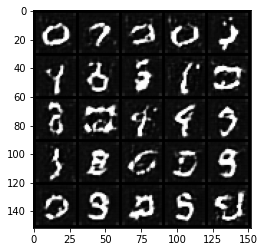

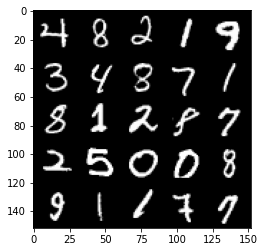

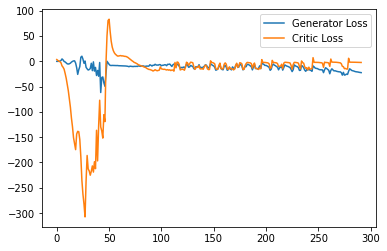

Step 5900: Generator loss: -23.37494758605957, critic loss: -2.4642255811691287


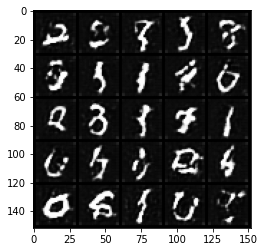

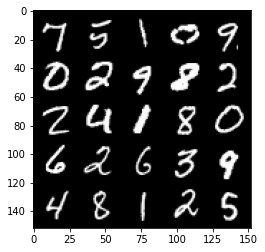

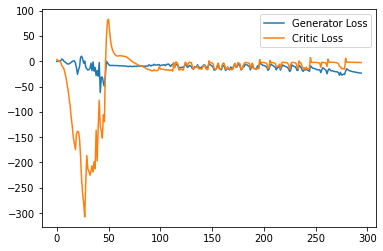

Step 5950: Generator loss: -24.324202575683593, critic loss: -2.712665196418763


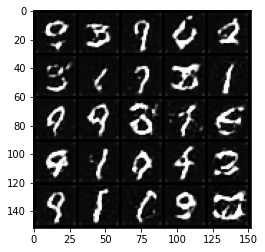

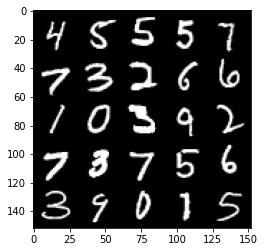

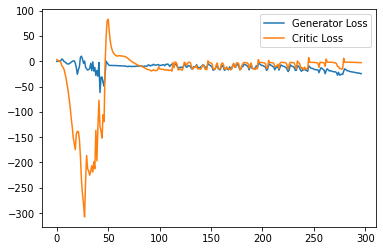

Step 6000: Generator loss: -24.97284973144531, critic loss: -2.263298971176147


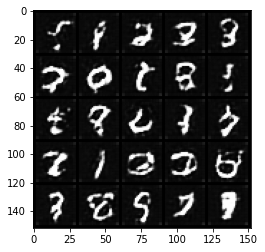

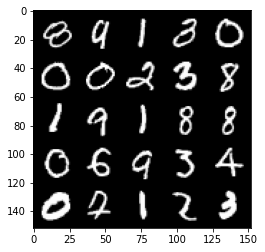

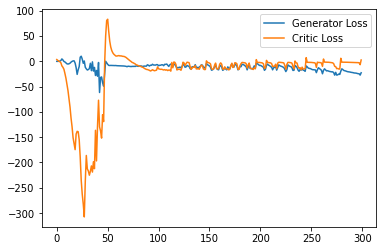

Step 6050: Generator loss: -22.94511329650879, critic loss: -1.7670043745040893


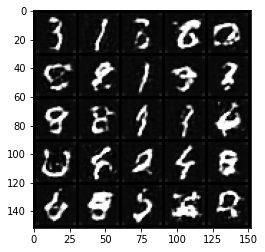

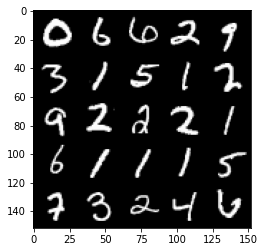

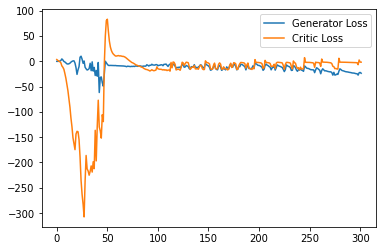

Step 6100: Generator loss: -24.259553375244142, critic loss: -2.151290876865387


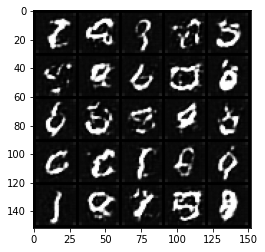

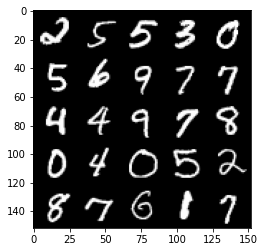

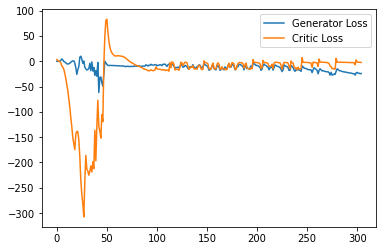

Step 6150: Generator loss: -25.14720302581787, critic loss: -2.465734275341034


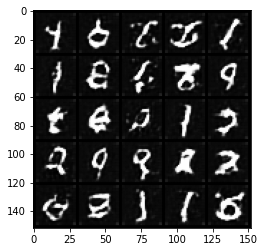

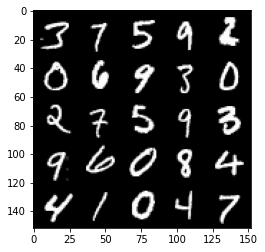

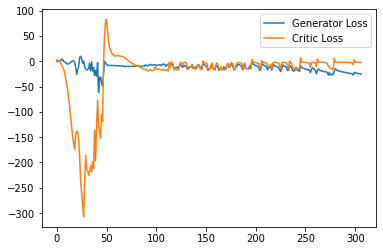

Step 6200: Generator loss: -27.756197776794433, critic loss: -6.371292318344116


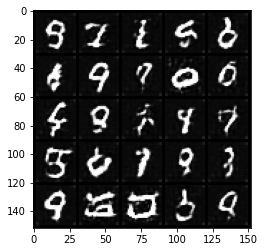

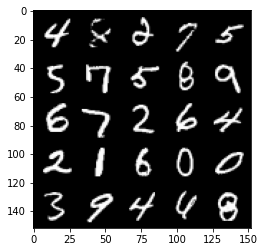

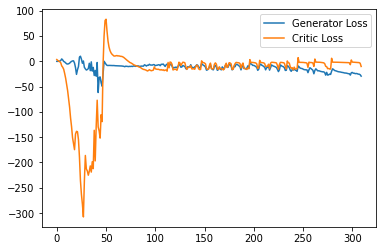

Step 6250: Generator loss: -25.329186477661132, critic loss: -4.435159801006318


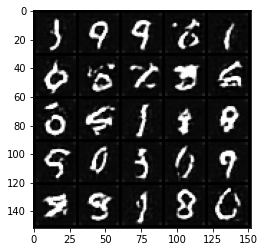

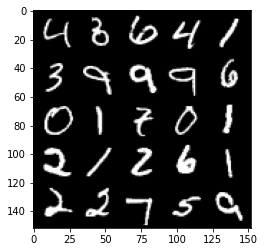

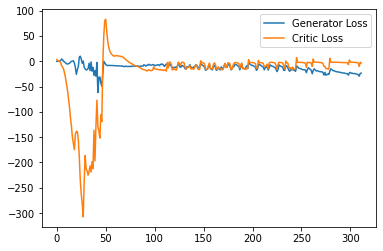

Step 6300: Generator loss: -24.71804313659668, critic loss: -6.0623638372421285


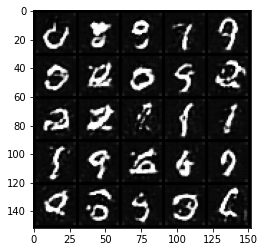

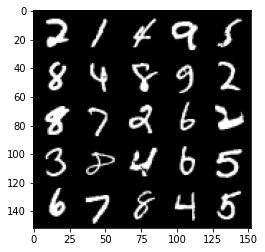

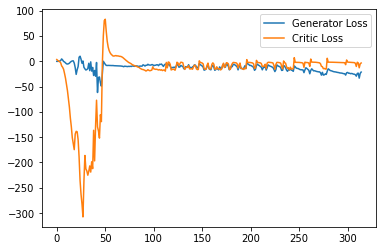

Step 6350: Generator loss: -25.294753608703612, critic loss: -6.428549413204192


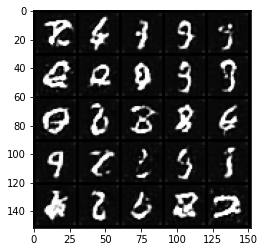

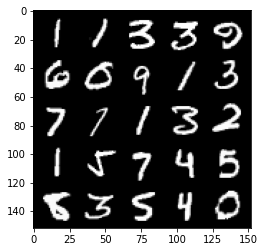

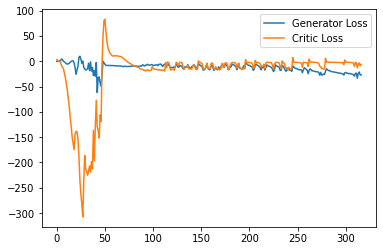

Step 6400: Generator loss: -22.716076736450194, critic loss: -2.476600144863129


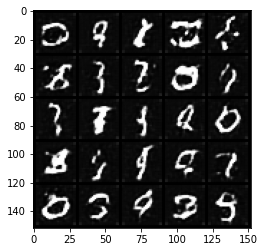

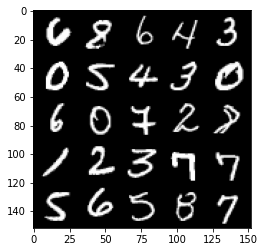

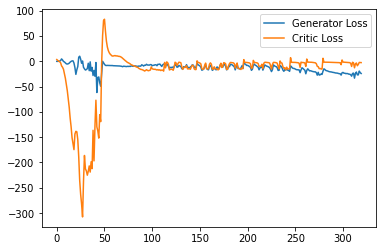

Step 6450: Generator loss: -25.629232597351074, critic loss: -3.21196496105194


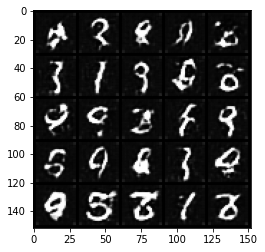

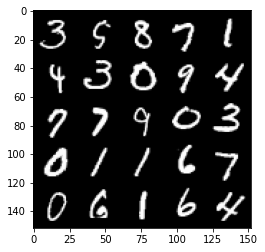

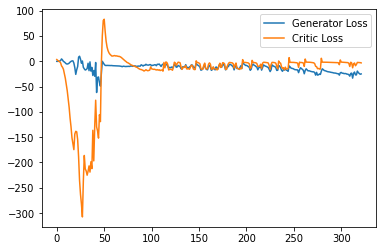

Step 6500: Generator loss: -32.19515083312988, critic loss: -11.453990478515623


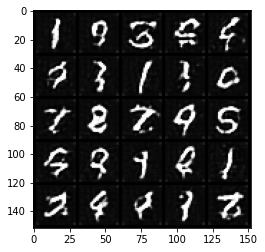

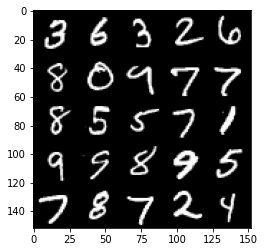

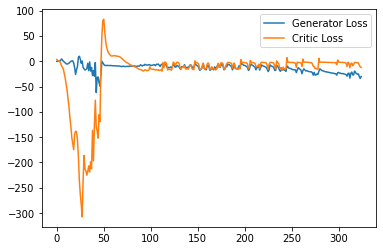

Step 6550: Generator loss: -23.799948310852052, critic loss: -4.106655461788178


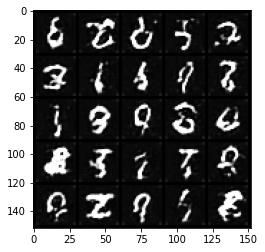

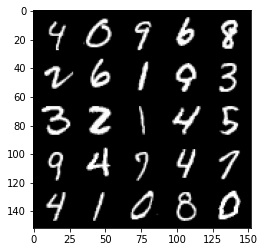

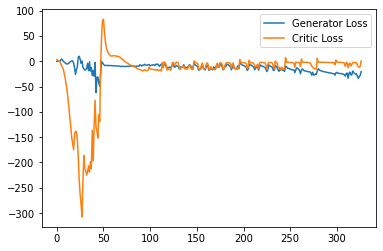

Step 6600: Generator loss: -27.81422369003296, critic loss: -7.240957269191742


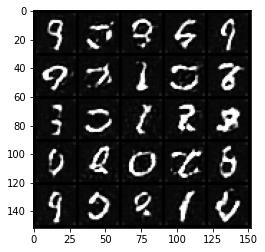

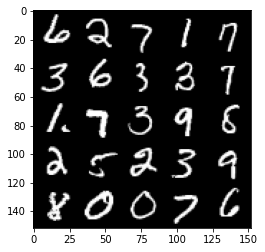

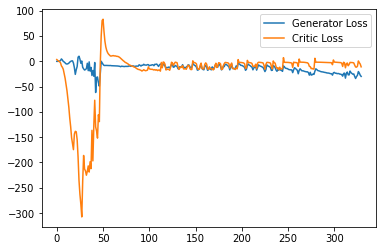

Step 6650: Generator loss: -26.00785861968994, critic loss: -6.8746826286315885


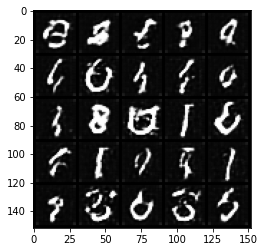

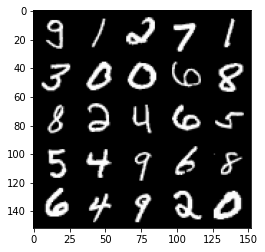

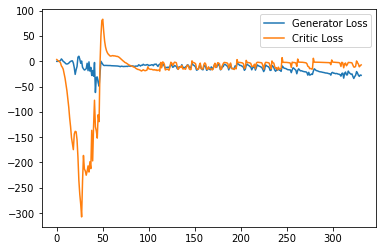

Step 6700: Generator loss: -29.20142532348633, critic loss: -13.628451153278345


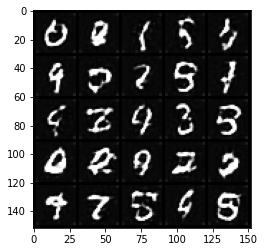

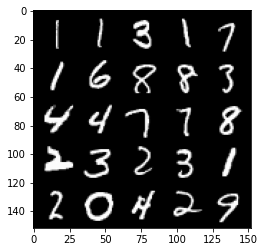

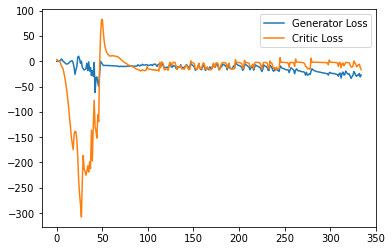

Step 6750: Generator loss: -23.933665761947633, critic loss: -2.840627802848815


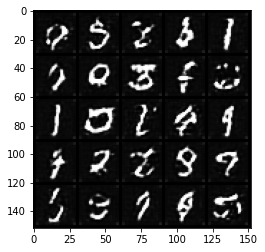

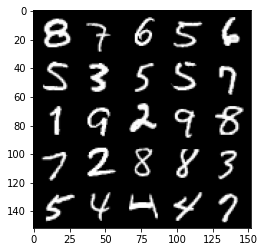

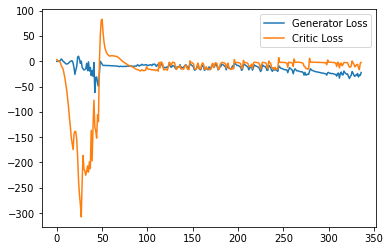

Step 6800: Generator loss: -24.529969749450682, critic loss: -4.268830322265624


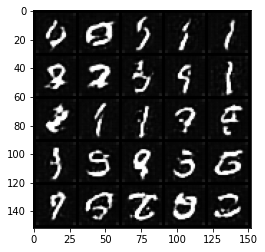

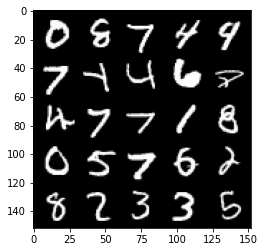

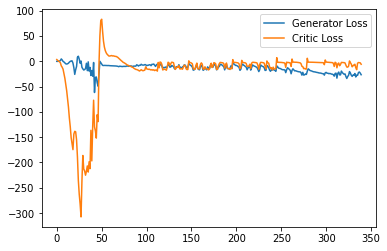

Step 6850: Generator loss: -27.238141231536865, critic loss: -10.951853328466413


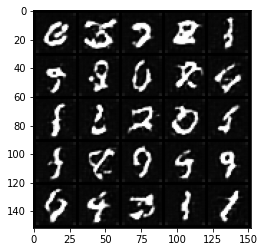

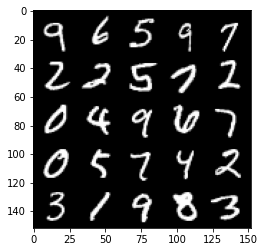

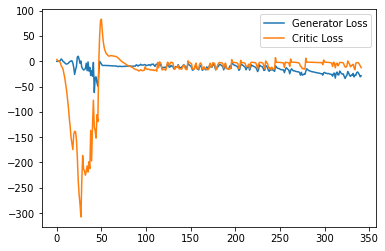

Step 6900: Generator loss: -31.135950241088867, critic loss: -11.54999393415451


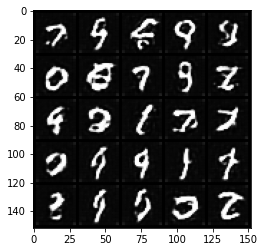

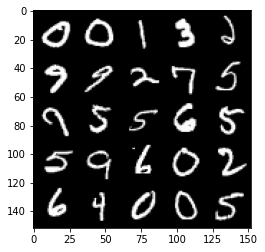

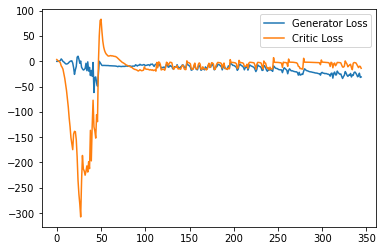

Step 6950: Generator loss: -28.130134239196778, critic loss: -12.32959316968918


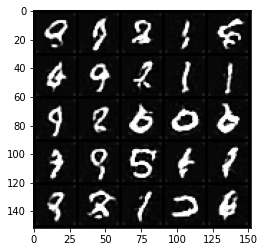

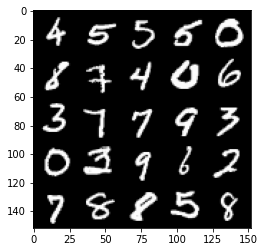

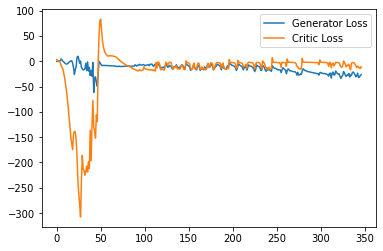

Step 7000: Generator loss: -30.381799392700195, critic loss: -14.599628147125252


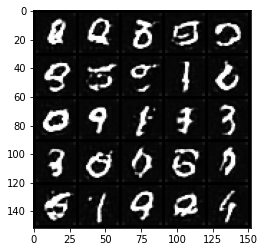

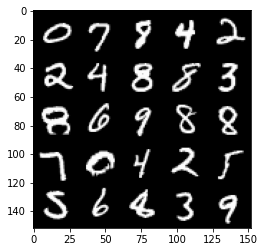

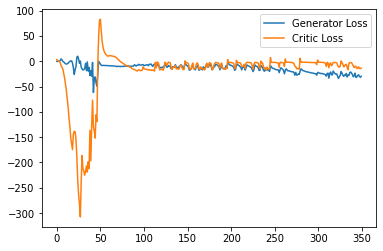

Step 7050: Generator loss: -27.14459815979004, critic loss: -11.694348352909087


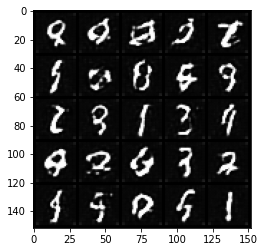

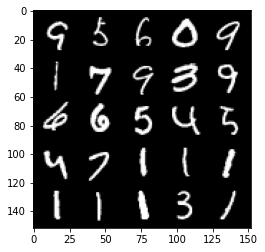

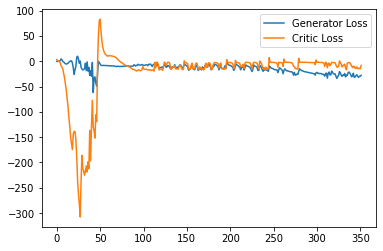

Step 7100: Generator loss: -27.05034194946289, critic loss: -11.734529308319088


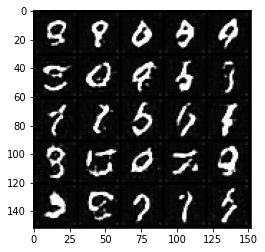

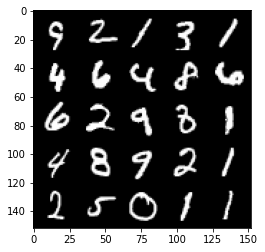

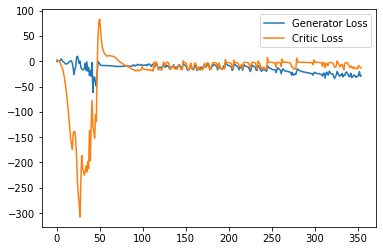

Step 7150: Generator loss: -24.431482124328614, critic loss: -4.222311807394028


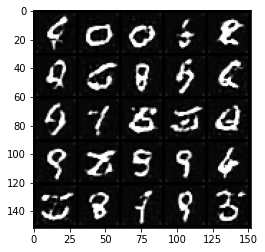

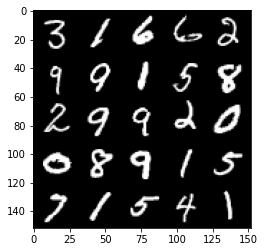

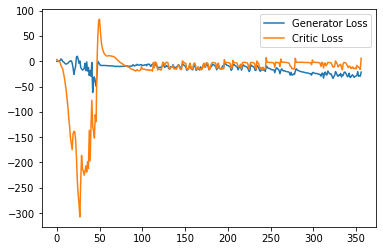

Step 7200: Generator loss: -22.000507354736328, critic loss: -2.6768445639610285


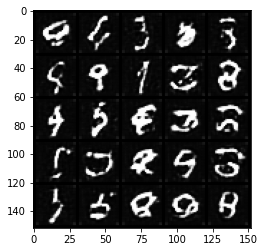

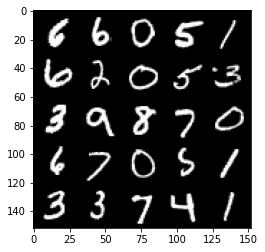

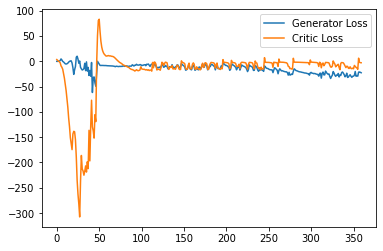

Step 7250: Generator loss: -25.056838970184327, critic loss: -6.569734021663667


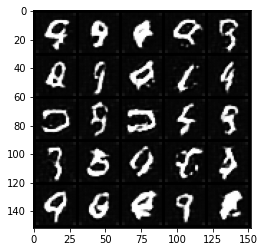

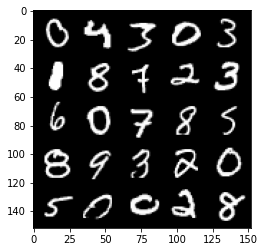

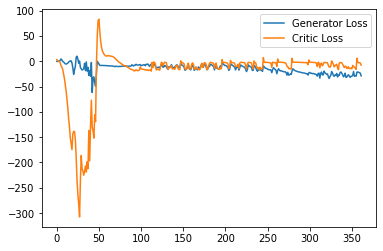

Step 7300: Generator loss: -28.847400035858154, critic loss: -11.351832704544067


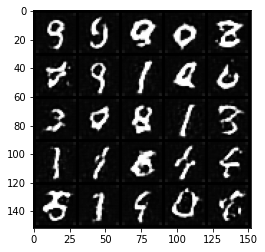

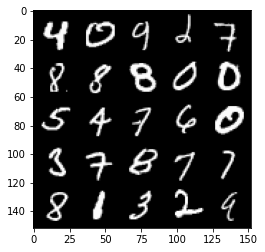

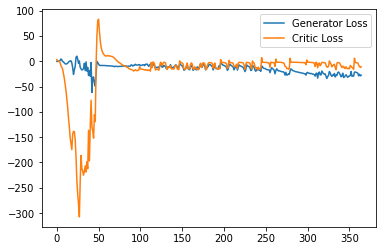

Step 7350: Generator loss: -30.570553283691407, critic loss: -13.314418782234196


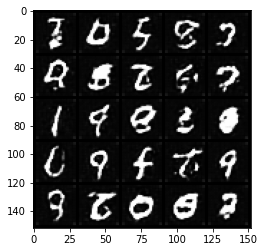

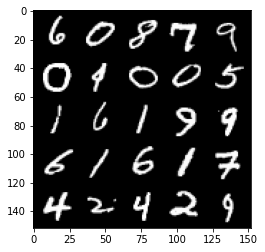

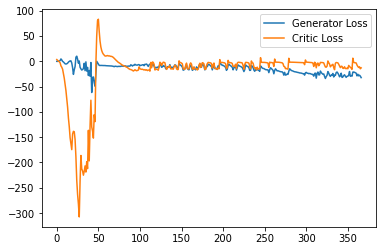

Step 7400: Generator loss: -29.407615394592284, critic loss: -13.616458607673646


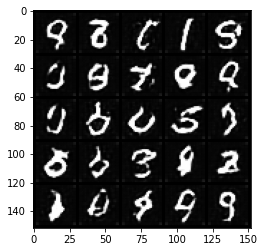

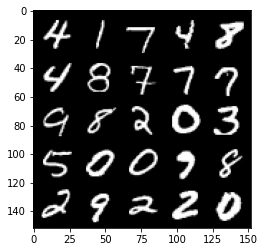

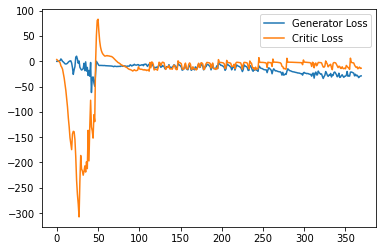

Step 7450: Generator loss: -24.99249267578125, critic loss: -11.171752951383592


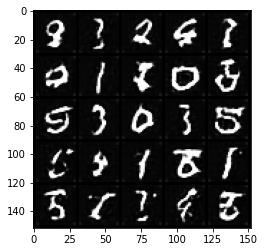

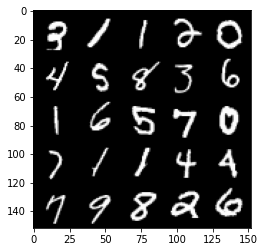

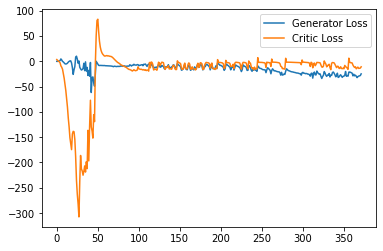

Step 7500: Generator loss: -24.619465351104736, critic loss: -9.11664715862274


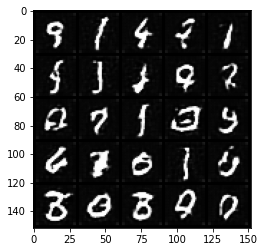

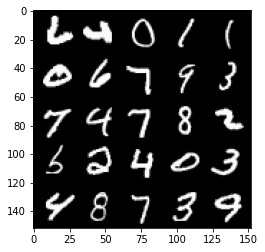

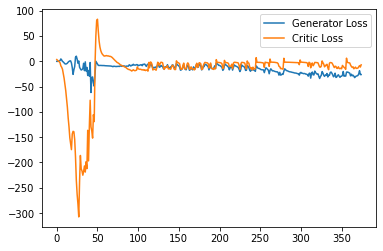

Step 7550: Generator loss: -17.02881242752075, critic loss: -2.4193150606155402


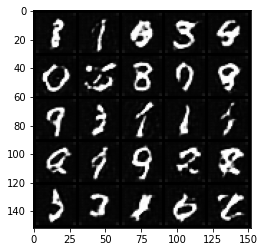

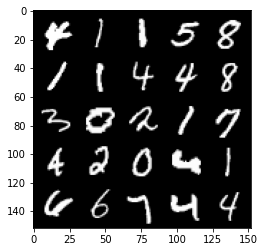

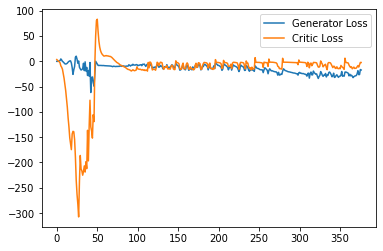

Step 7600: Generator loss: -20.339863204956053, critic loss: -3.1556282773017887


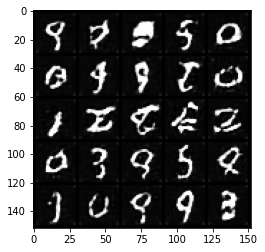

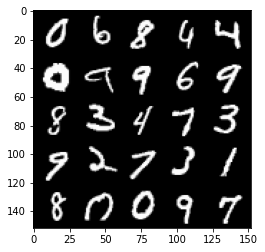

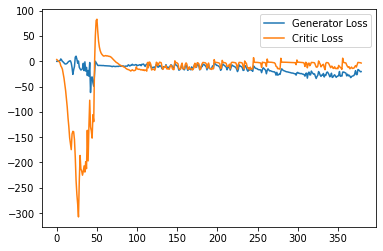

Step 7650: Generator loss: -27.75998836517334, critic loss: -12.707418509006505


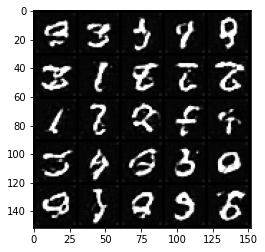

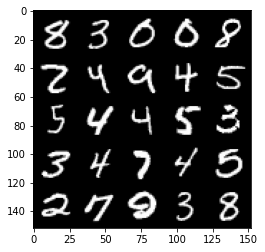

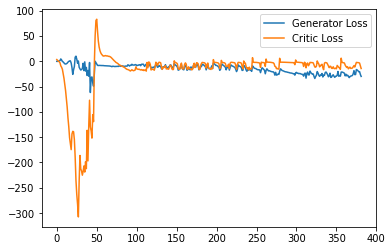

Step 7700: Generator loss: -24.998263018131254, critic loss: -10.402599789857861


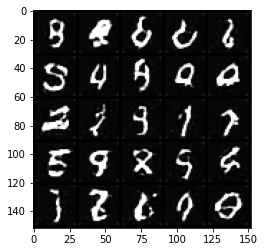

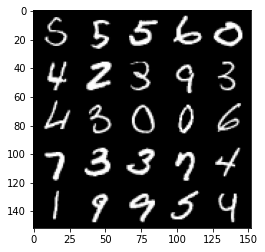

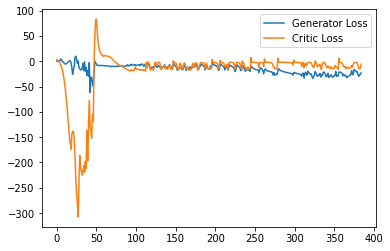

Step 7750: Generator loss: -25.536961936950682, critic loss: -11.060772547245024


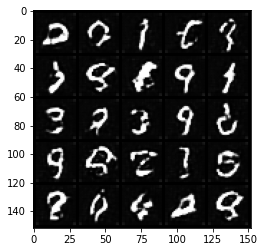

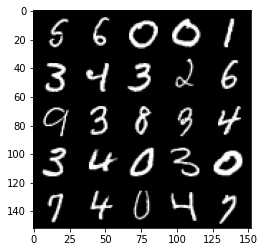

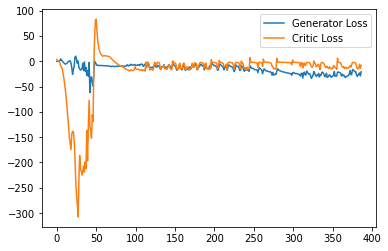

Step 7800: Generator loss: -27.80889865875244, critic loss: -14.027169514417647


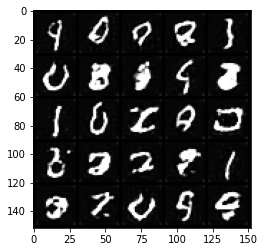

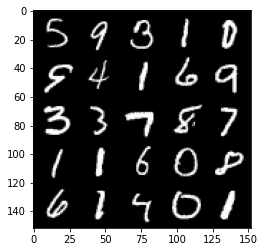

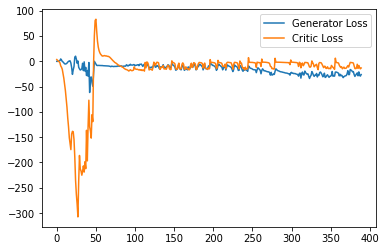

Step 7850: Generator loss: -23.2814945602417, critic loss: -13.226412172317504


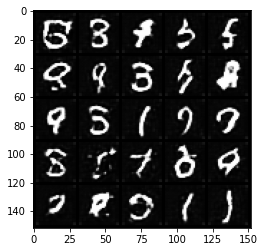

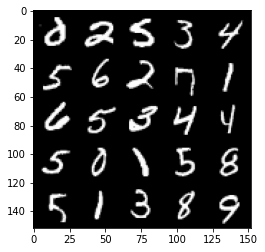

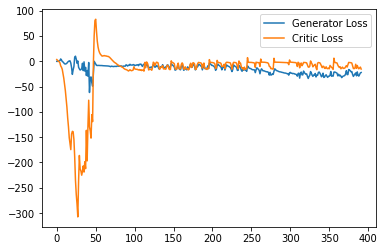

Step 7900: Generator loss: -23.824545125961304, critic loss: -13.32670589160919


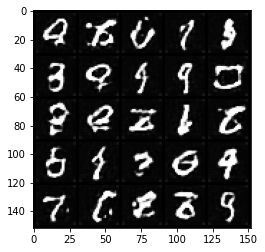

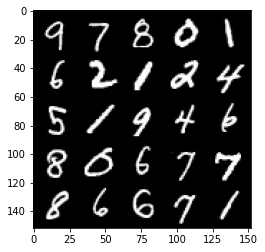

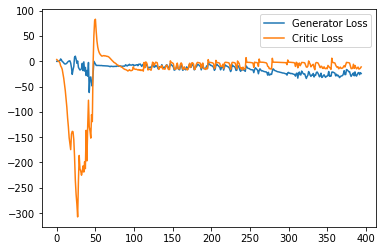

Step 7950: Generator loss: -20.99045124053955, critic loss: -0.33484245586395134


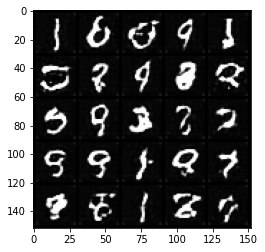

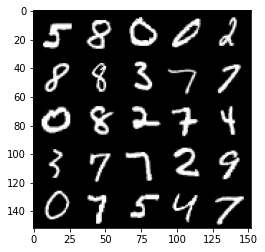

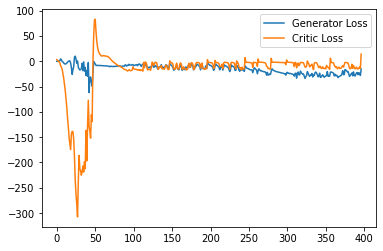

Step 8000: Generator loss: -21.062300834655762, critic loss: -2.8739517374038694


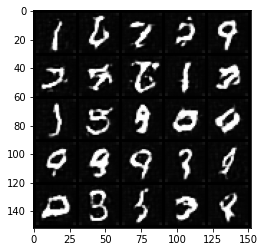

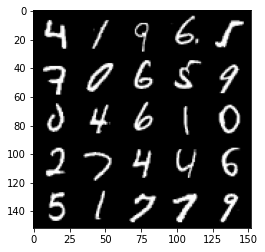

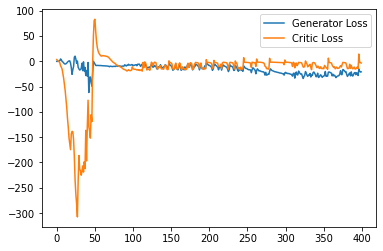

Step 8050: Generator loss: -27.070673332214355, critic loss: -11.98251930618286


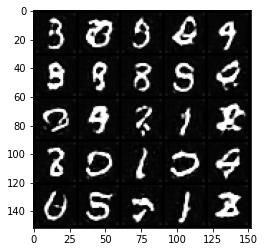

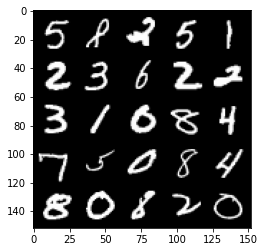

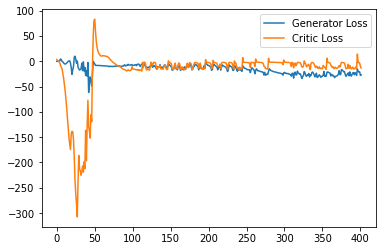

Step 8100: Generator loss: -25.738705978393554, critic loss: -14.351323496341701


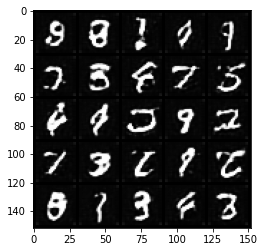

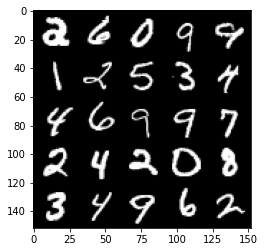

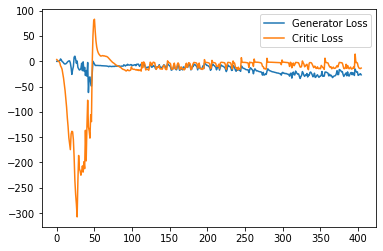

Step 8150: Generator loss: -22.486696758270263, critic loss: -12.673016369342802


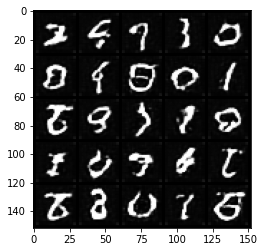

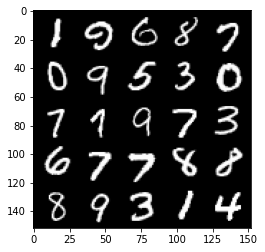

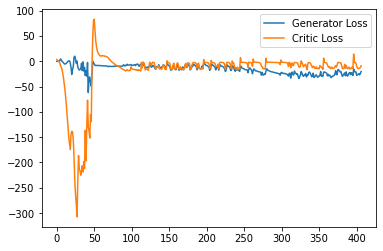

Step 8200: Generator loss: -25.157789916992186, critic loss: -9.303307491302494


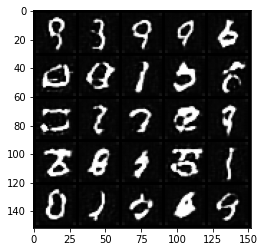

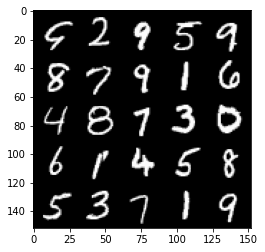

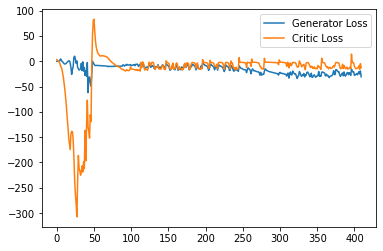

Step 8250: Generator loss: -24.837848644256592, critic loss: -12.574462710857388


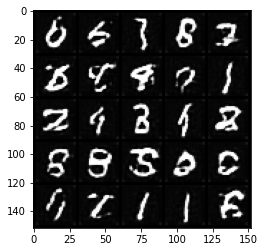

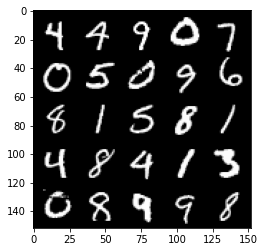

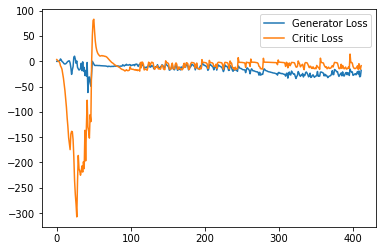

Step 8300: Generator loss: -26.98139072418213, critic loss: -12.47587275147438


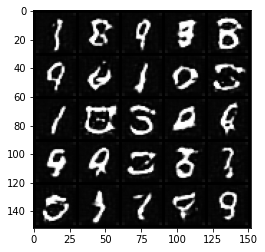

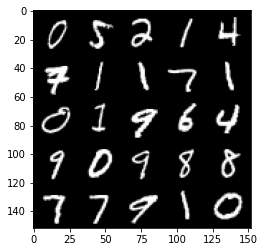

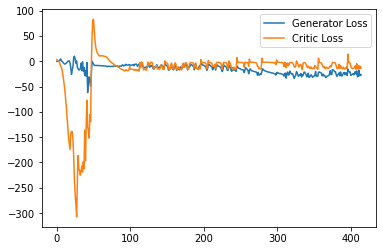

Step 8350: Generator loss: -24.638683462142943, critic loss: -12.179966104030608


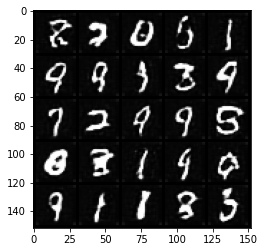

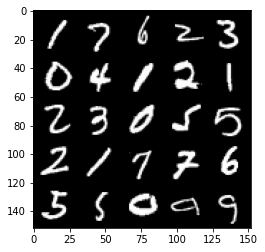

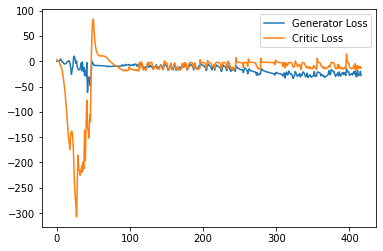

Step 8400: Generator loss: -23.616976956129076, critic loss: -11.096468677520752


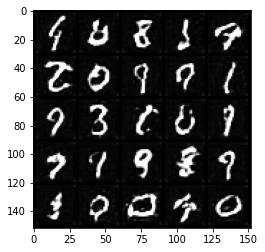

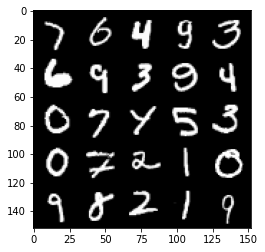

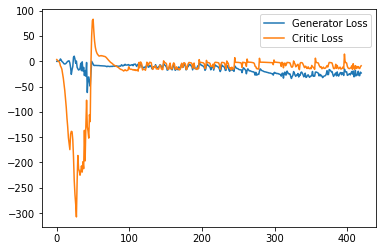

Step 8450: Generator loss: -26.211668291091918, critic loss: -14.283212135553363


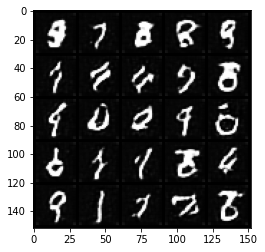

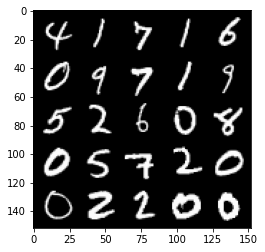

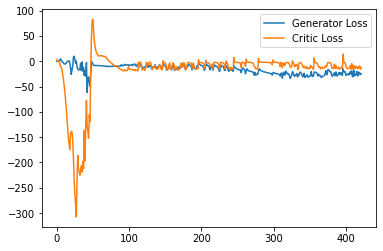

Step 8500: Generator loss: -28.357426662445068, critic loss: -14.528264132499698


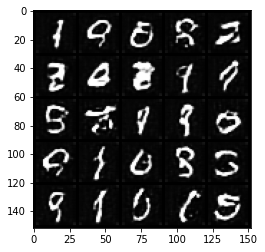

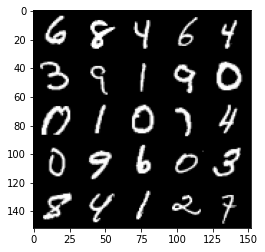

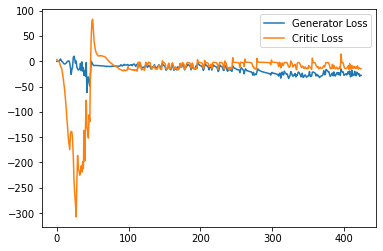

Step 8550: Generator loss: -23.208916816711426, critic loss: -5.162910497903823


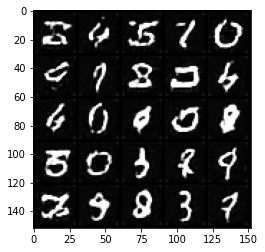

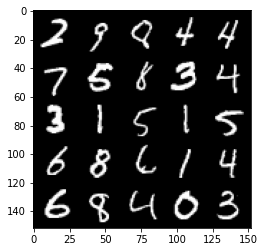

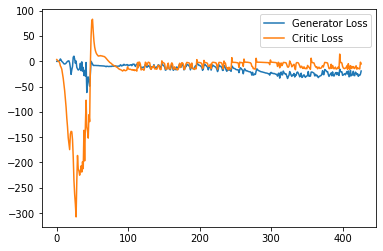

Step 8600: Generator loss: -22.07686869621277, critic loss: -8.900655539989472


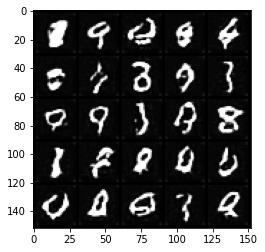

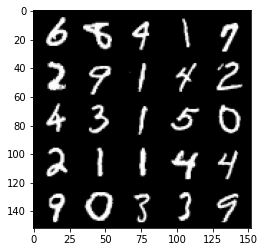

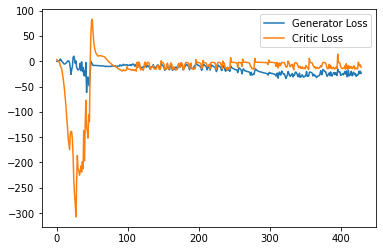

Step 8650: Generator loss: -29.71150119781494, critic loss: -12.37986610364914


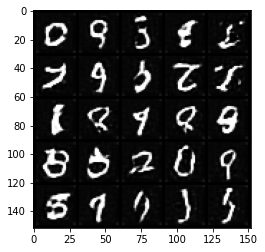

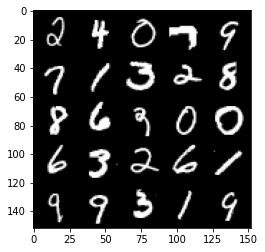

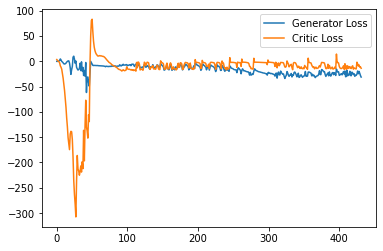

Step 8700: Generator loss: -24.682764225006103, critic loss: -10.75464013457298


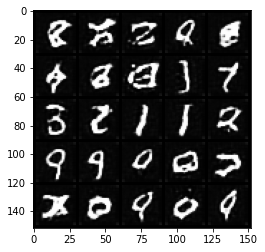

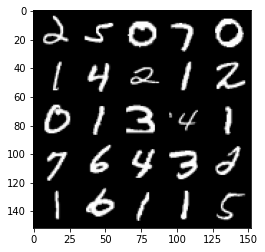

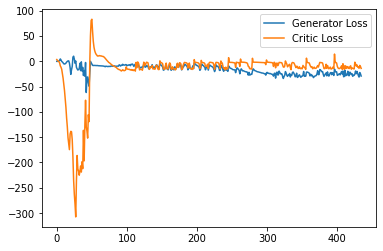

Step 8750: Generator loss: -21.162698674201966, critic loss: -10.742613234519961


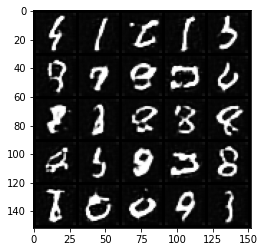

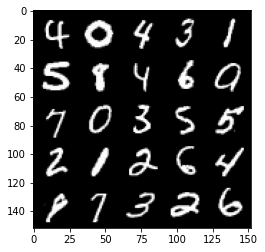

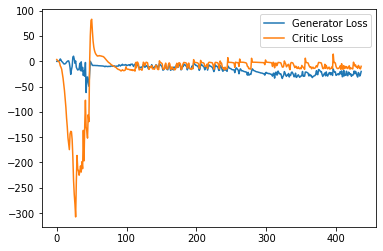

Step 8800: Generator loss: -26.49947717666626, critic loss: -12.643333884239196


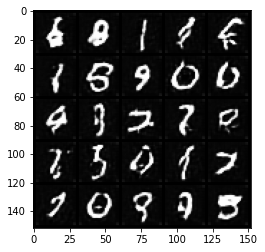

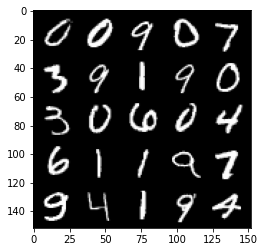

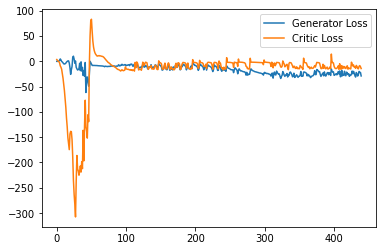

Step 8850: Generator loss: -28.845989360809327, critic loss: -15.059182605266574


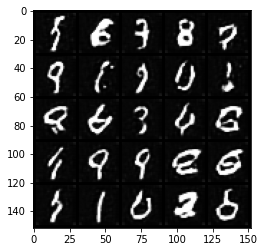

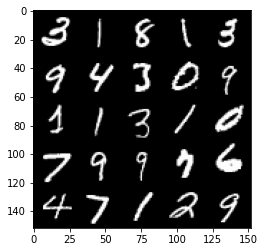

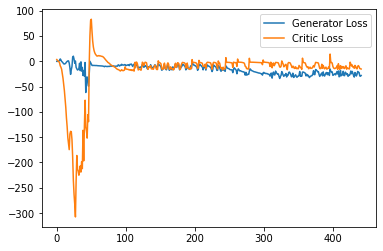

Step 8900: Generator loss: -21.233002262115477, critic loss: -4.431475445032119


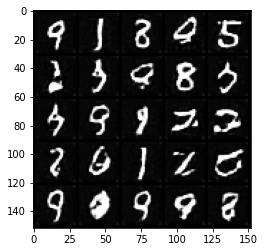

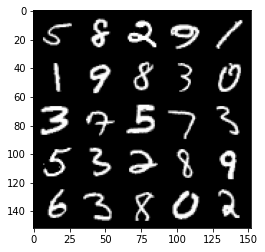

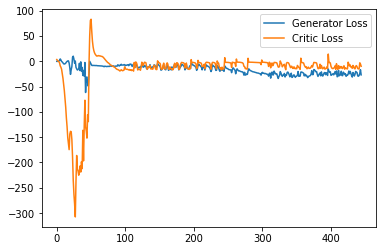

Step 8950: Generator loss: -21.043871421813964, critic loss: -10.27520726108551


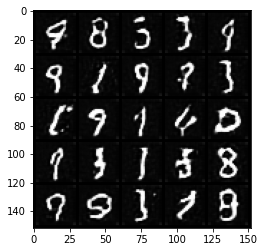

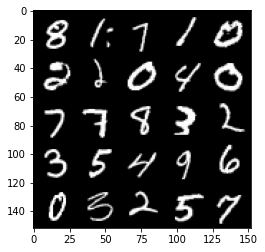

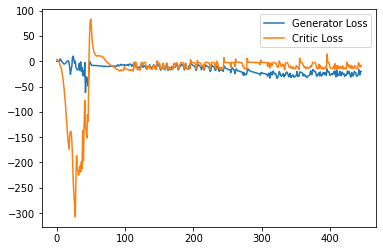

Step 9000: Generator loss: -20.705411157608033, critic loss: -8.937887486696242


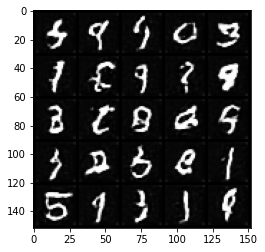

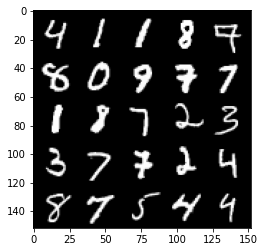

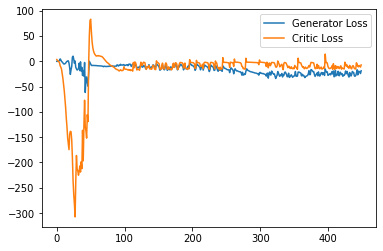

Step 9050: Generator loss: -21.56090043783188, critic loss: -4.9531120285987855


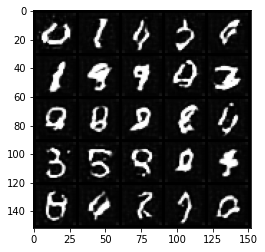

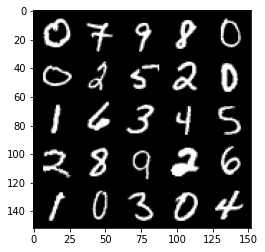

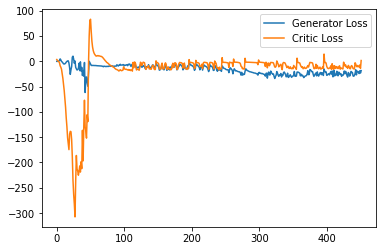

Step 9100: Generator loss: -22.436153469085692, critic loss: -9.775494661808011


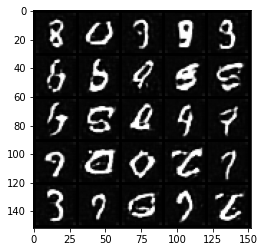

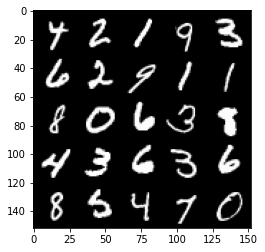

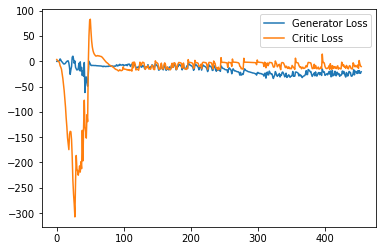

Step 9150: Generator loss: -21.783410844802855, critic loss: -12.49974832010269


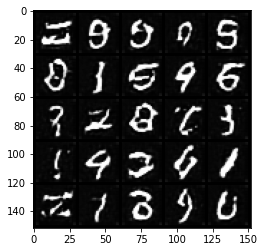

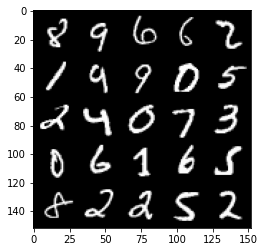

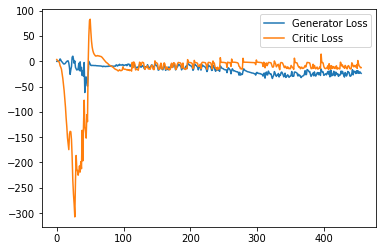

Step 9200: Generator loss: -26.269718647003174, critic loss: -14.795383238077166


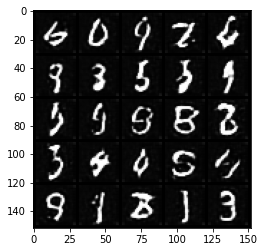

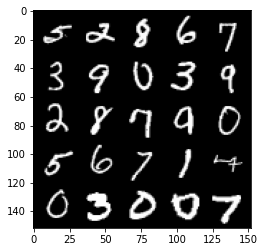

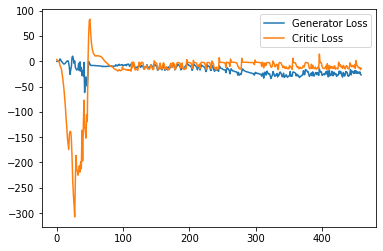

Step 9250: Generator loss: -19.4641215133667, critic loss: -11.768797671318053


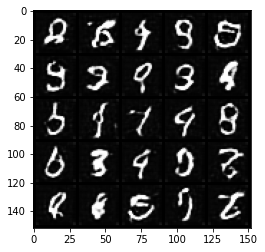

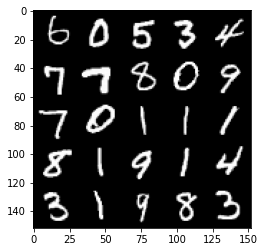

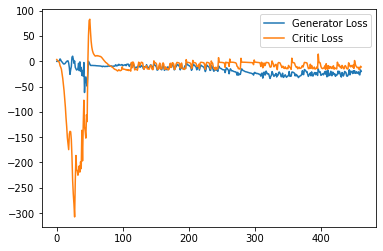

Step 9300: Generator loss: -19.346447812616827, critic loss: -10.802973278045654


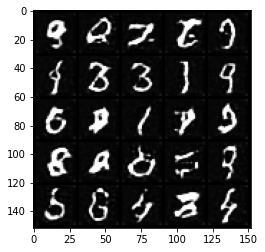

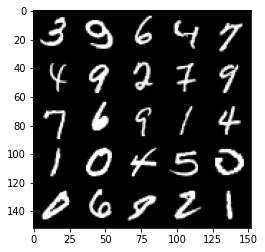

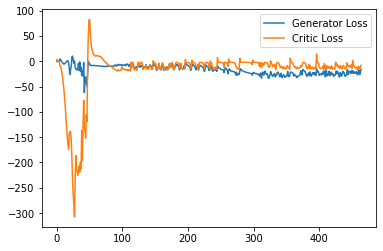

Step 9350: Generator loss: -19.1757795715332, critic loss: -6.09469960594177


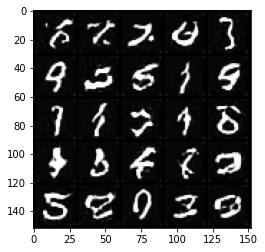

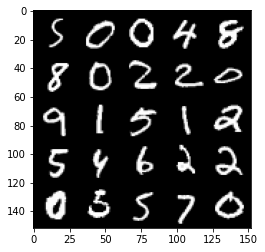

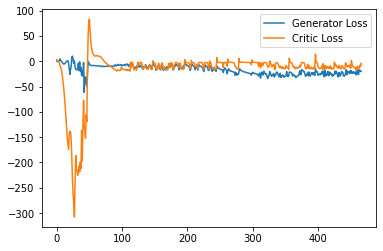

Step 9400: Generator loss: -17.951709365844728, critic loss: -4.643019512176513


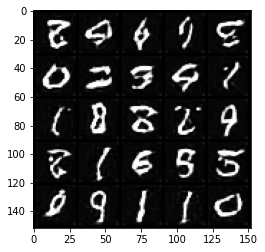

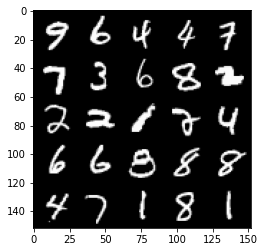

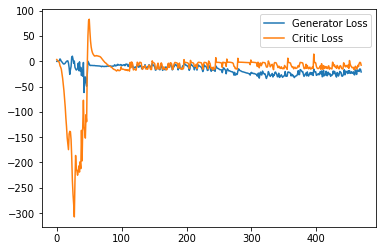

Step 9450: Generator loss: -24.3482905960083, critic loss: -14.143593703985214


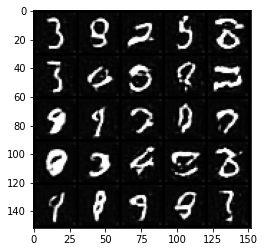

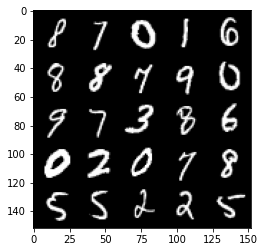

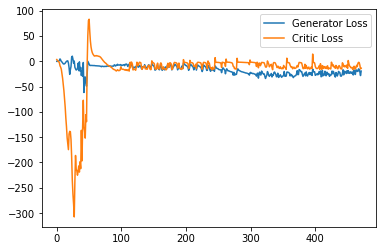

Step 9500: Generator loss: -21.39840109705925, critic loss: -13.053957439422604


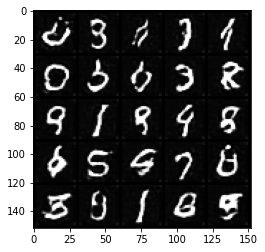

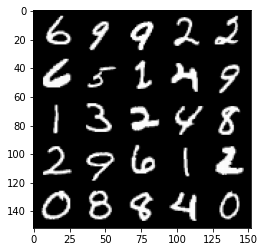

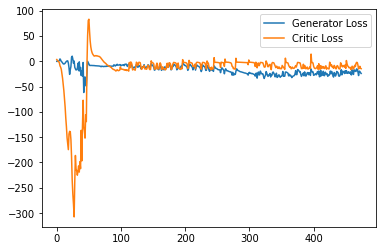

Step 9550: Generator loss: -21.342751569747925, critic loss: -9.011154652833937


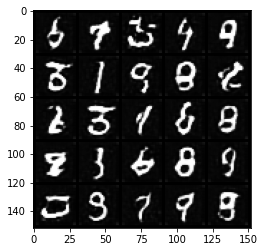

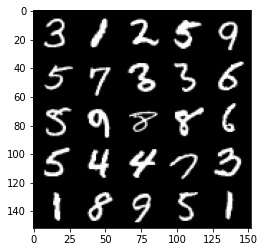

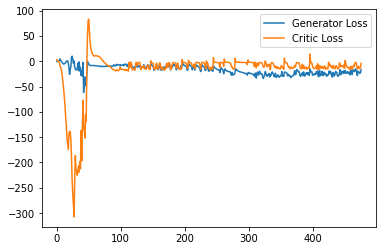

Step 9600: Generator loss: -19.421054615974427, critic loss: -12.073270892858504


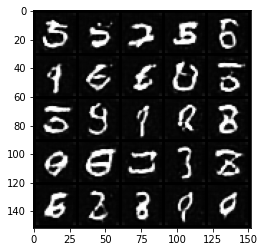

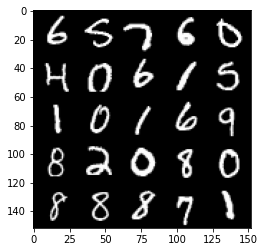

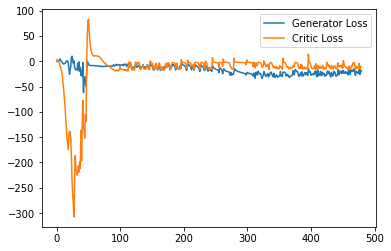

Step 9650: Generator loss: -21.328814630508422, critic loss: -11.970279099941251


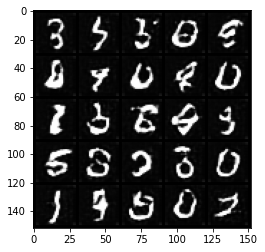

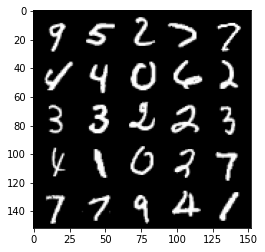

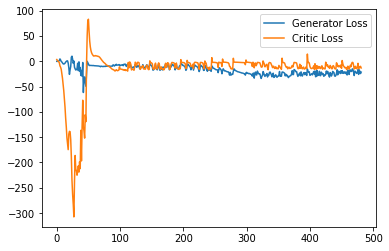

Step 9700: Generator loss: -17.08484335899353, critic loss: -6.3272800843715675


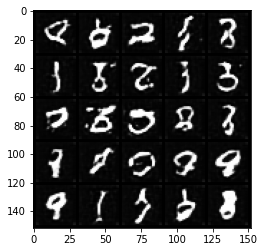

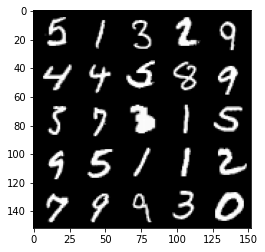

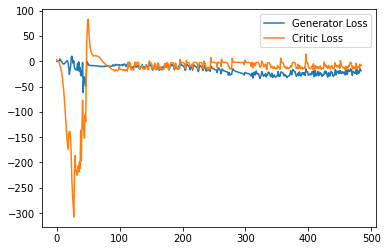

Step 9750: Generator loss: -21.31107864379883, critic loss: -6.937678353548048


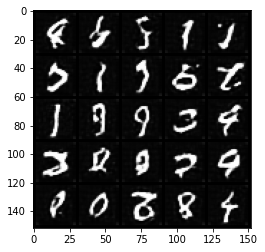

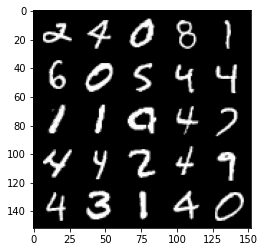

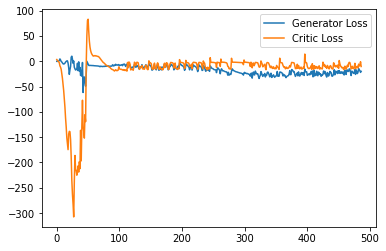

Step 9800: Generator loss: -20.24392349243164, critic loss: -12.015341160535813


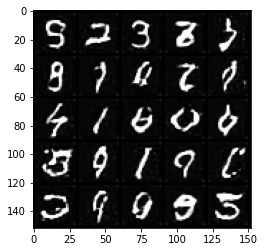

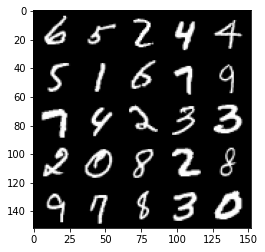

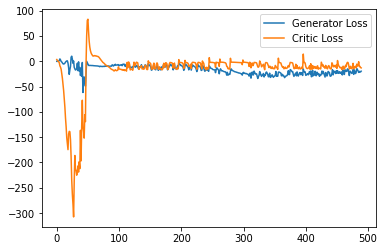

Step 9850: Generator loss: -27.952666931152343, critic loss: -13.186553383588787


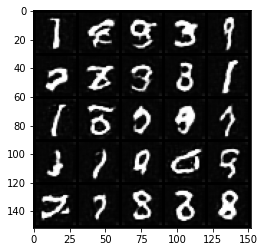

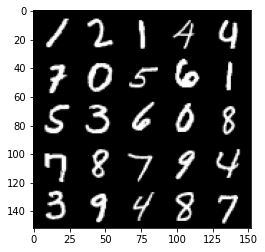

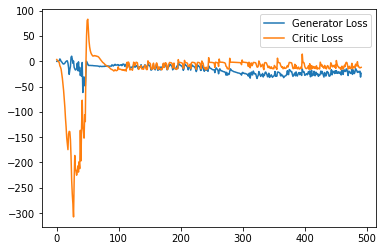

Step 9900: Generator loss: -22.280199279785155, critic loss: -13.599625795602797


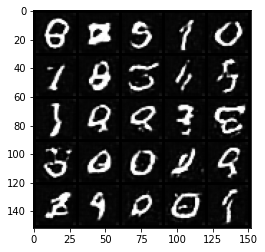

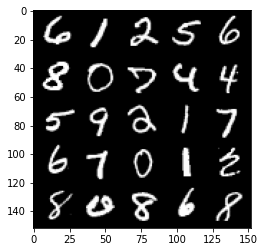

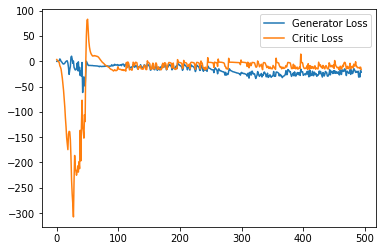

Step 9950: Generator loss: -19.075264819860458, critic loss: -13.403528077363971


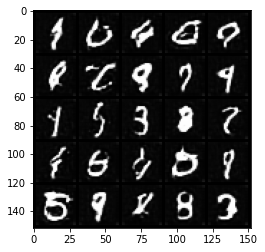

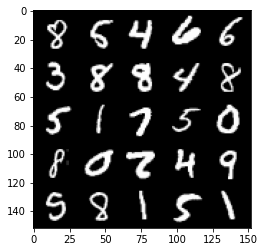

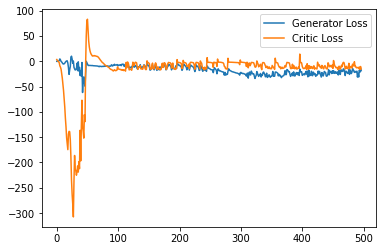

Step 10000: Generator loss: -20.818869369029997, critic loss: -6.992066911220551


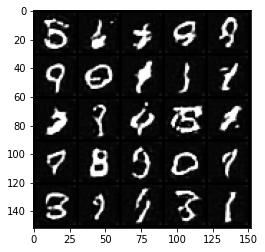

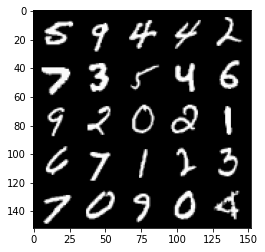

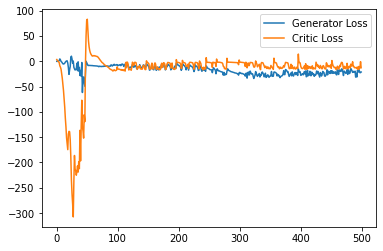

Step 10050: Generator loss: -20.47526414513588, critic loss: -12.230148049831392


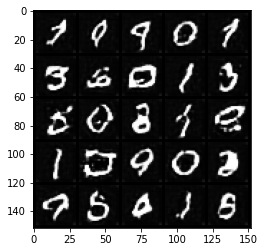

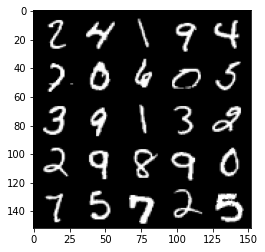

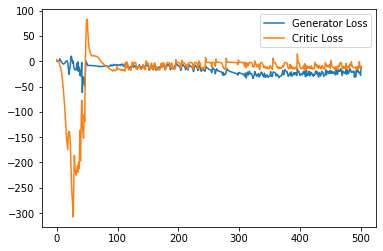

Step 10100: Generator loss: -21.465380230545996, critic loss: -13.783907381057734


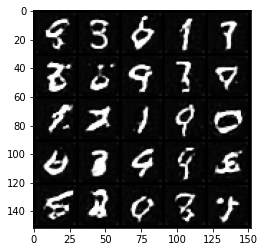

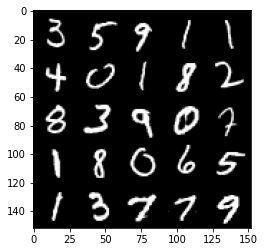

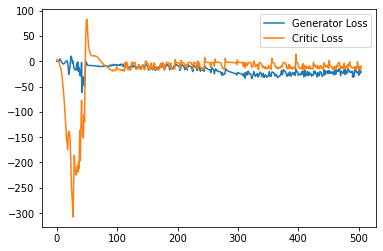

Step 10150: Generator loss: -22.27361138343811, critic loss: -14.73691390180588


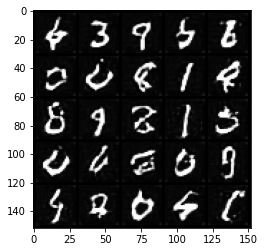

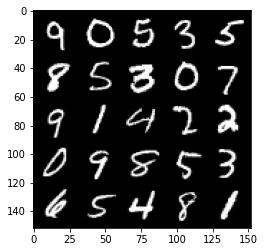

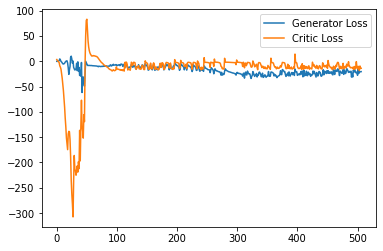

Step 10200: Generator loss: -23.39357129096985, critic loss: -12.442497295856475


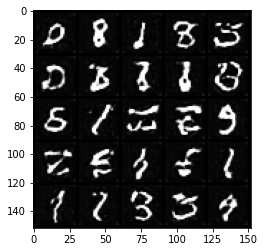

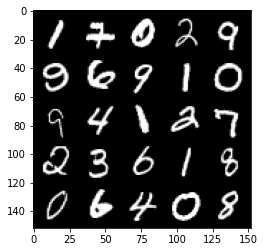

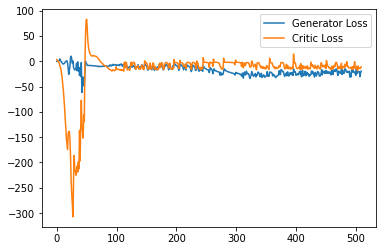

Step 10250: Generator loss: -23.768167526721953, critic loss: -14.436197373867033


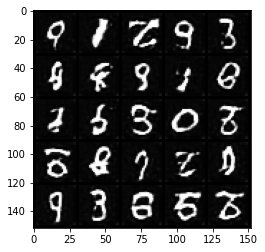

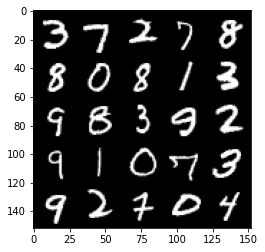

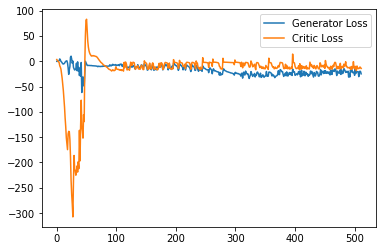

Step 10300: Generator loss: -25.194247102737428, critic loss: -13.880419167041778


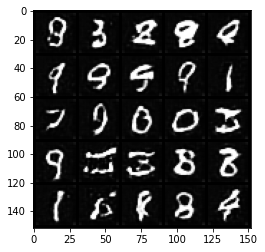

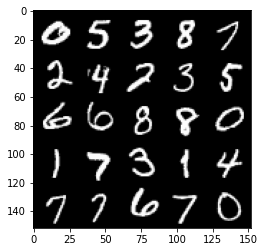

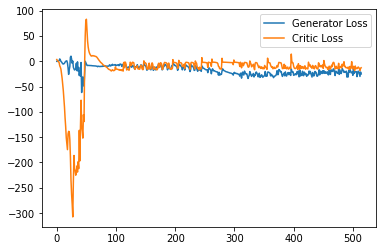

Step 10350: Generator loss: -21.992981910705566, critic loss: -14.267436882019044


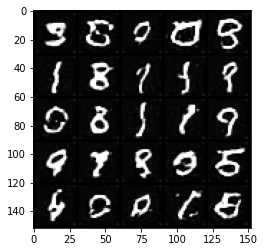

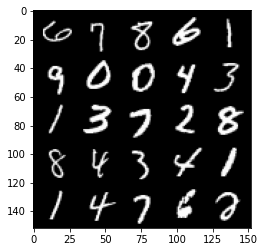

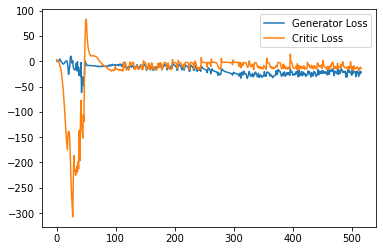

Step 10400: Generator loss: -19.78709237098694, critic loss: -6.5744169793128995


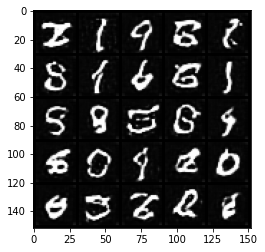

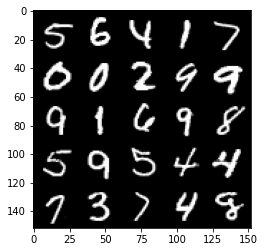

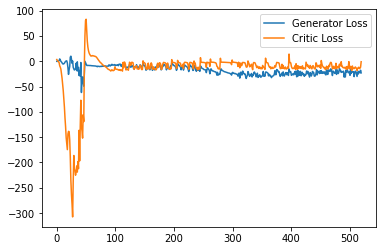

Step 10450: Generator loss: -19.677719249725342, critic loss: -5.432921253919601


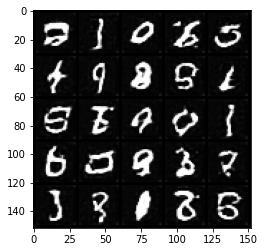

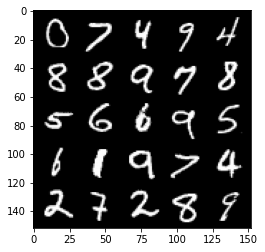

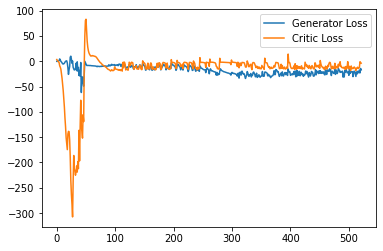

Step 10500: Generator loss: -20.76941735982895, critic loss: -12.15487936878204


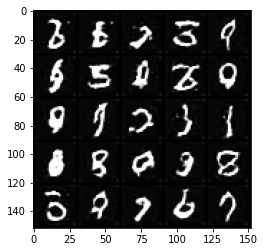

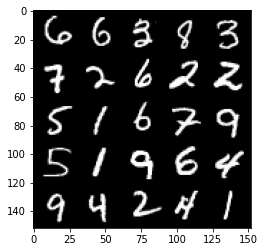

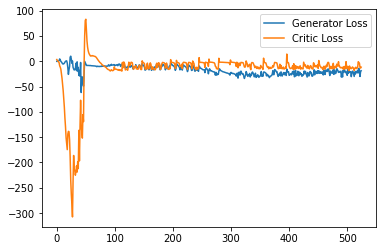

Step 10550: Generator loss: -17.797904266119005, critic loss: -7.164054259300232


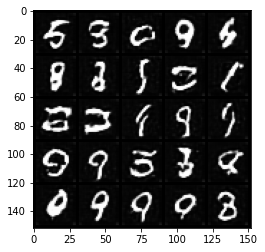

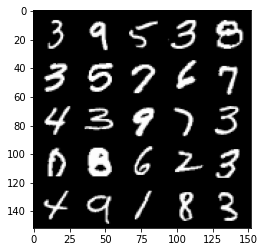

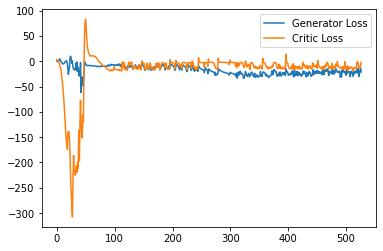

Step 10600: Generator loss: -17.86823579788208, critic loss: -9.551566545009614


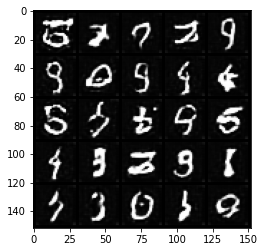

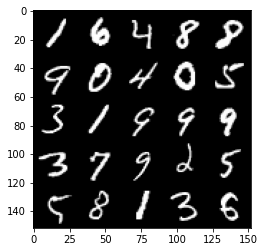

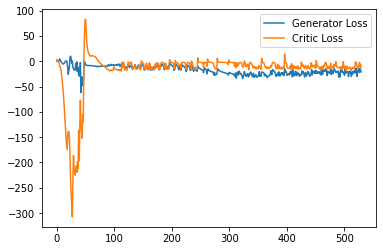

Step 10650: Generator loss: -21.39004326581955, critic loss: -14.68328377389908


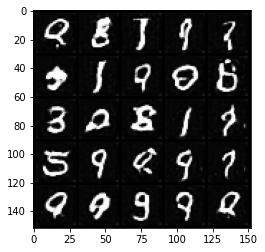

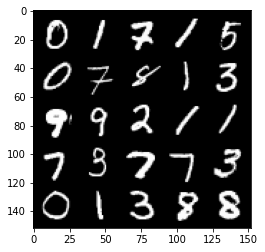

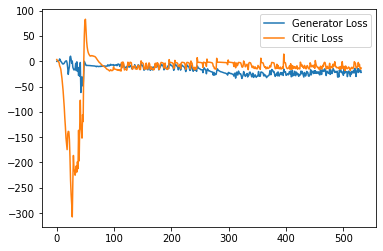

Step 10700: Generator loss: -16.77677690267563, critic loss: -10.93903531551361


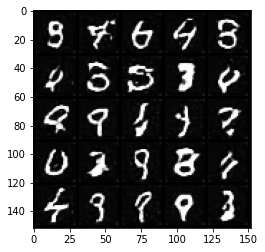

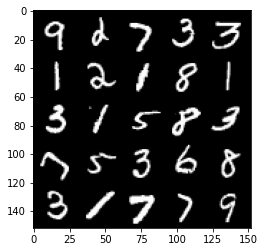

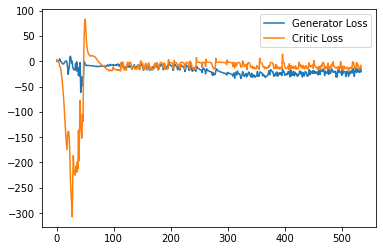

Step 10750: Generator loss: -17.141066217422484, critic loss: -11.096319418907164


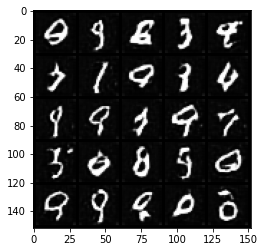

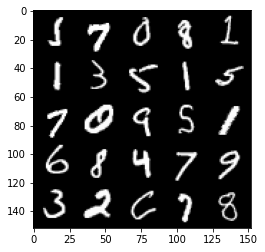

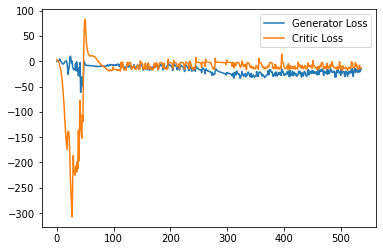

Step 10800: Generator loss: -19.29737272262573, critic loss: -10.8642656416893


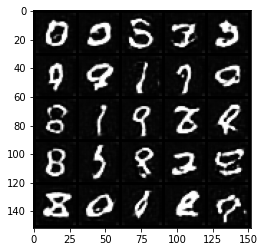

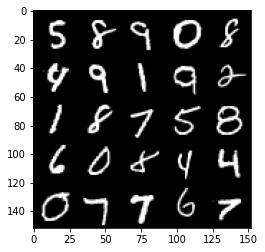

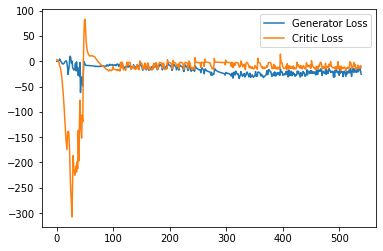

Step 10850: Generator loss: -21.57081557273865, critic loss: -17.552845356225973


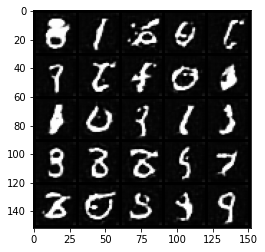

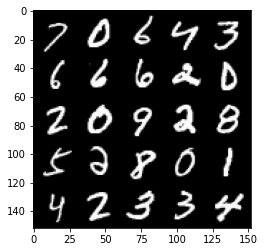

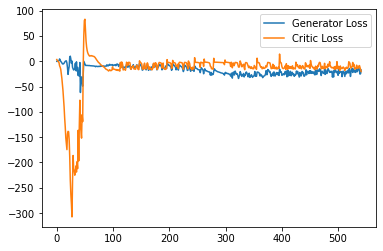

Step 10900: Generator loss: -20.394424809217455, critic loss: -14.166346343040466


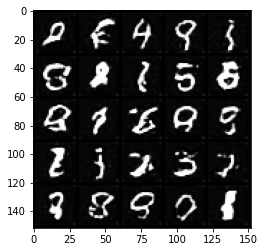

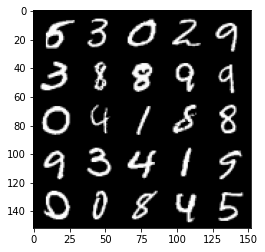

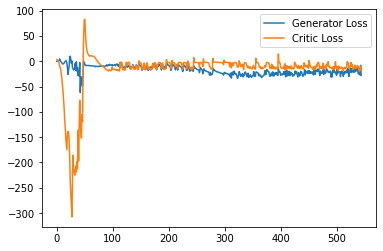

Step 10950: Generator loss: -18.489376544952393, critic loss: -8.572262940645217


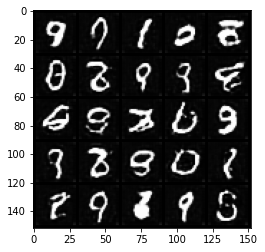

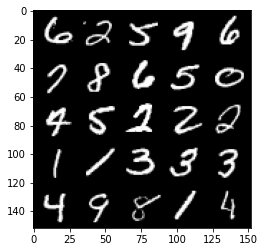

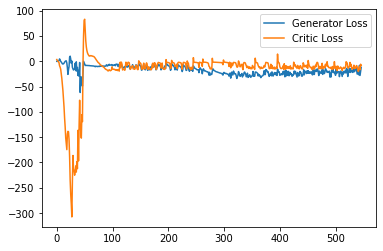

Step 11000: Generator loss: -18.63556289076805, critic loss: -12.115485634803772


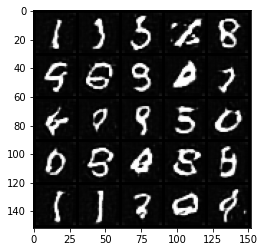

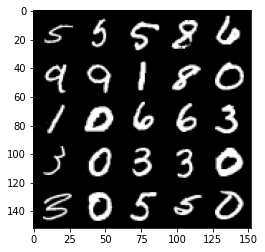

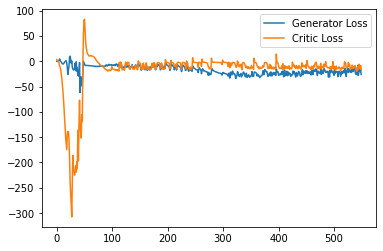

Step 11050: Generator loss: -14.022819819450378, critic loss: -11.845672486782078


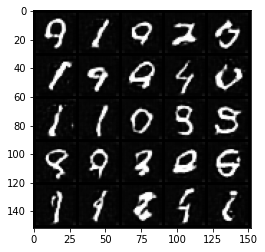

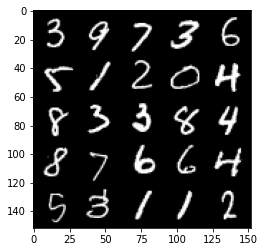

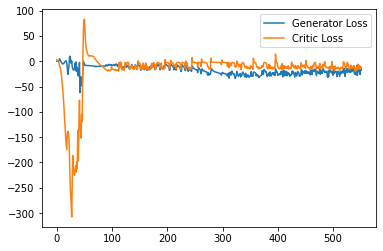

Step 11100: Generator loss: -15.716458604335784, critic loss: -13.408742989778519


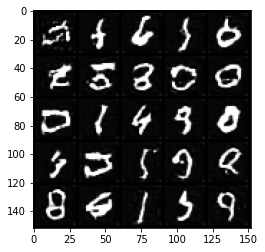

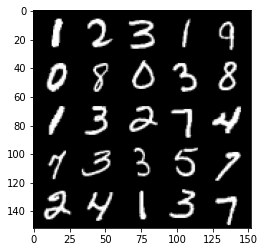

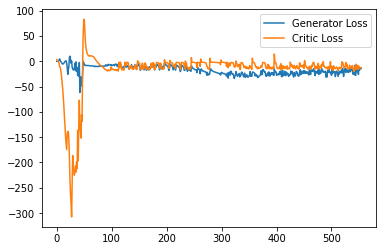

Step 11150: Generator loss: -19.488581705093384, critic loss: -10.696890504360196


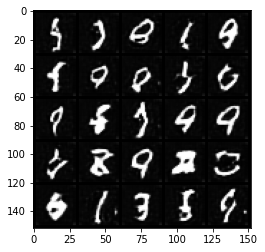

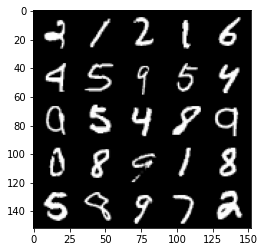

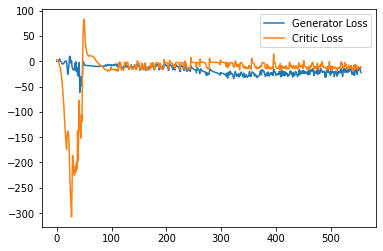

Step 11200: Generator loss: -14.873411445617675, critic loss: -2.4007613401412966


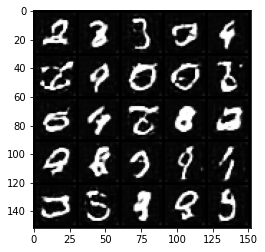

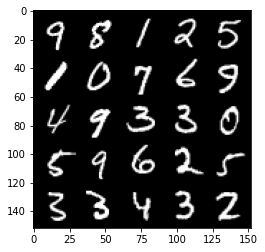

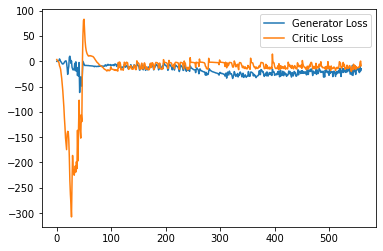

Step 11250: Generator loss: -20.607387681007385, critic loss: -9.71464219403267


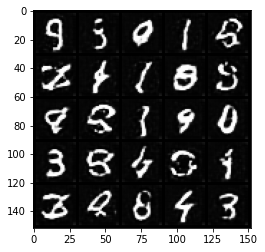

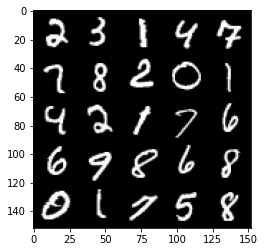

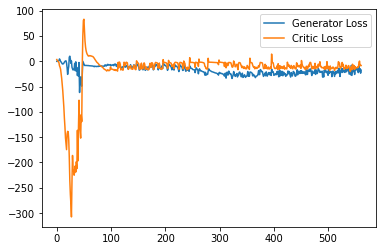

Step 11300: Generator loss: -19.902222655415535, critic loss: -14.45762673163414


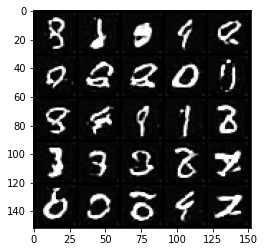

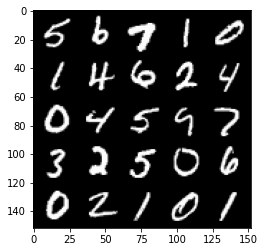

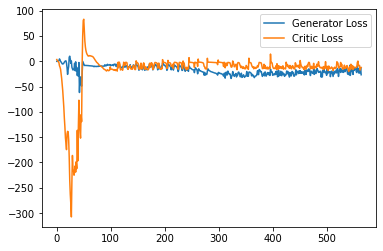

Step 11350: Generator loss: -17.043858527243138, critic loss: -12.805810559511187


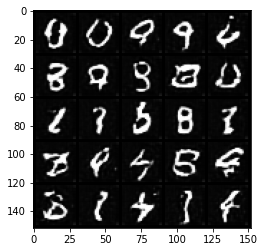

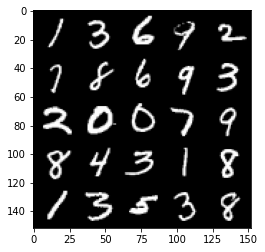

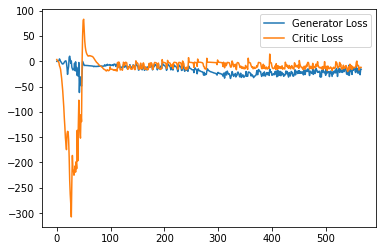

Step 11400: Generator loss: -21.934693102836608, critic loss: -16.96528635883332


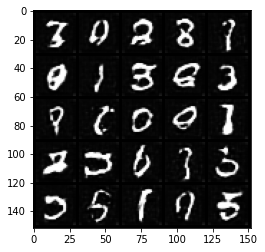

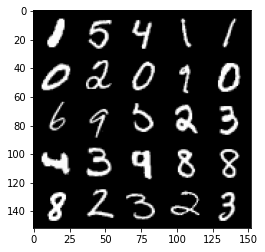

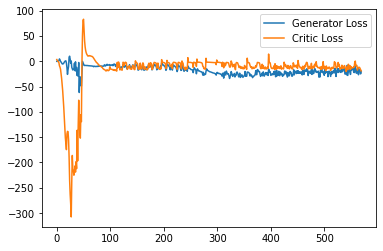

Step 11450: Generator loss: -17.164007037878036, critic loss: -12.868275219440461


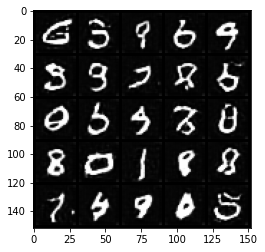

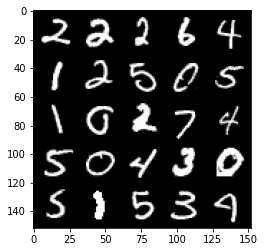

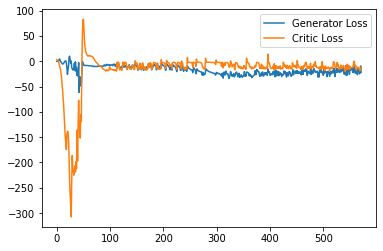

Step 11500: Generator loss: -11.765146558880806, critic loss: -8.953886598110198


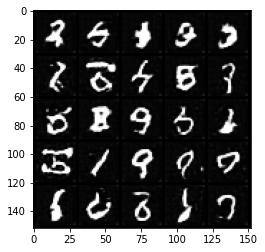

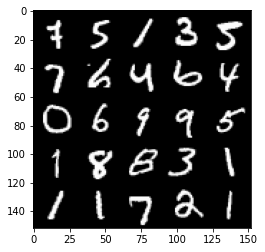

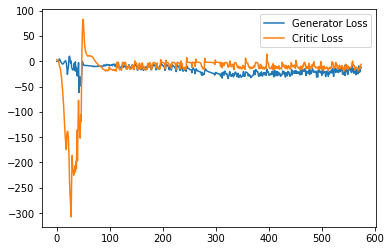

Step 11550: Generator loss: -19.87276947706938, critic loss: -14.301268098354342


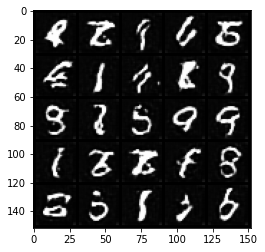

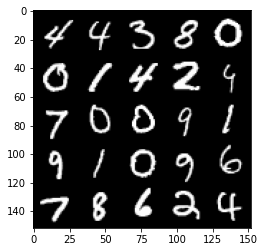

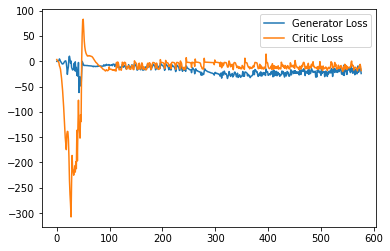

Step 11600: Generator loss: -13.365128781795502, critic loss: -12.957114733219148


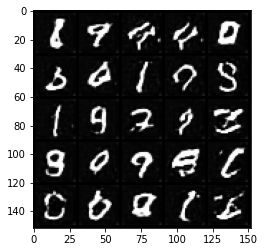

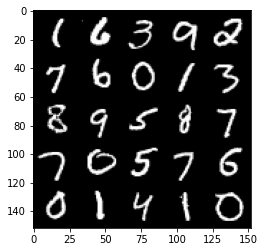

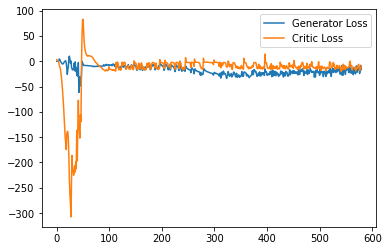

Step 11650: Generator loss: -15.733937567472458, critic loss: -11.63612732887268


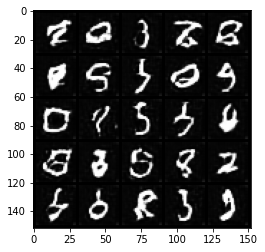

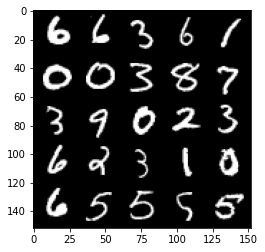

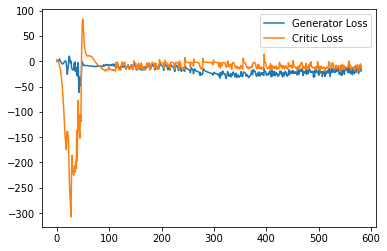

Step 11700: Generator loss: -15.0045563185215, critic loss: -14.845802651882172


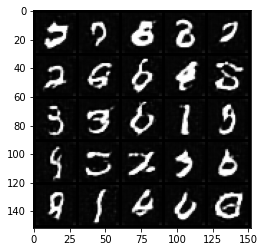

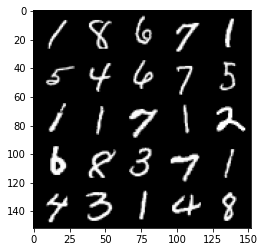

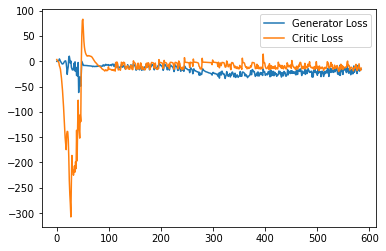

Step 11750: Generator loss: -12.102334420681, critic loss: -7.659818064928053


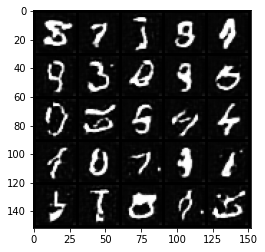

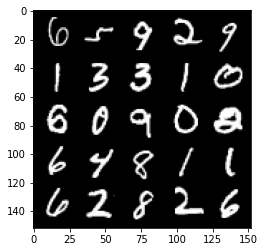

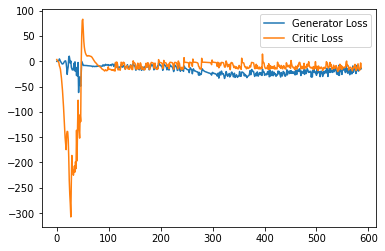

Step 11800: Generator loss: -12.933160161972046, critic loss: -11.945808050394055


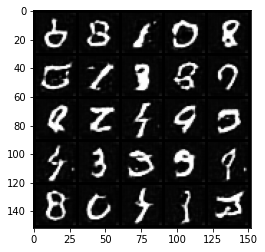

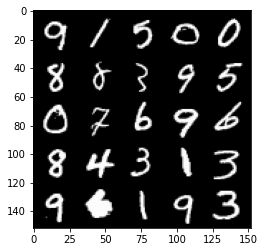

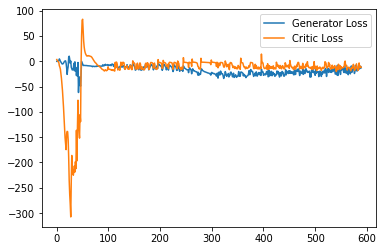

Step 11850: Generator loss: -16.623103243112563, critic loss: -16.569454404115685


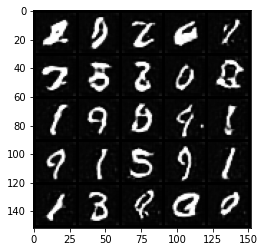

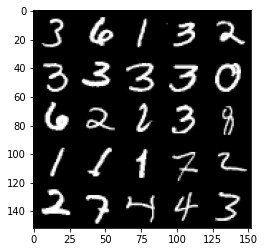

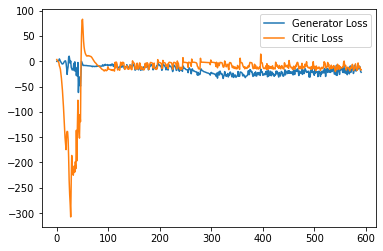

Step 11900: Generator loss: -13.49355344504118, critic loss: -9.487259955286982


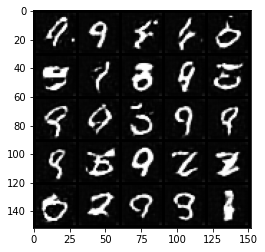

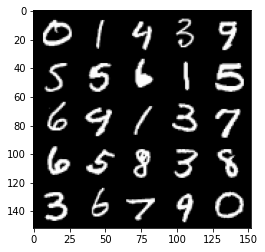

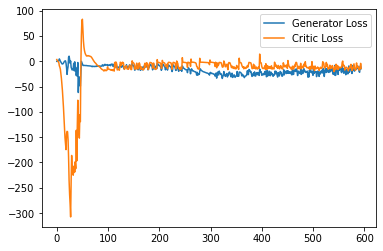

Step 11950: Generator loss: -13.066776690483094, critic loss: -9.723333435297013


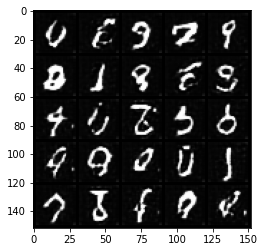

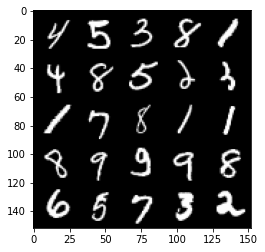

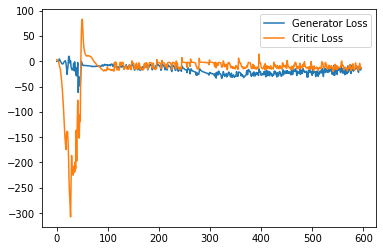

Step 12000: Generator loss: -17.551060161590577, critic loss: -14.307787099838258


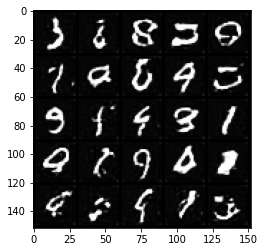

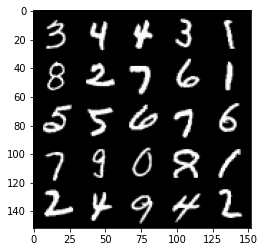

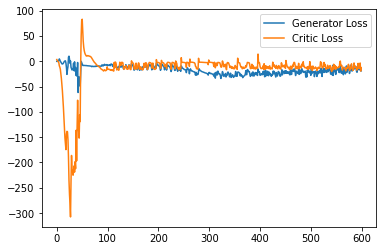

Step 12050: Generator loss: -11.676541598141194, critic loss: -11.681765317201615


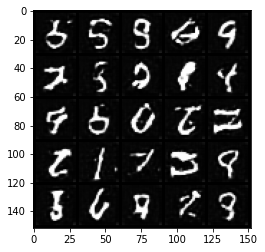

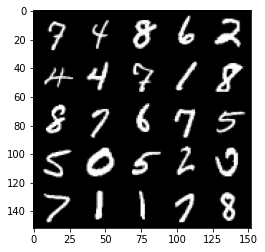

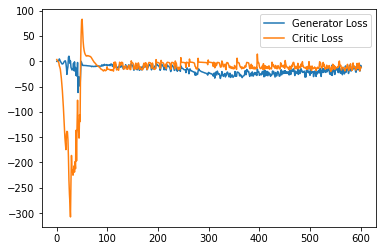

Step 12100: Generator loss: -11.848191139698029, critic loss: -3.7430661137104018


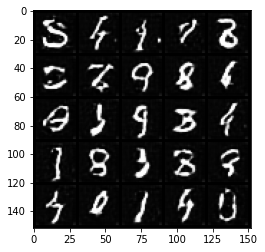

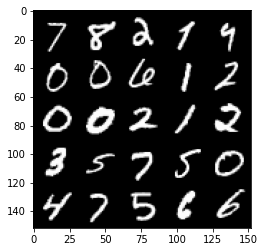

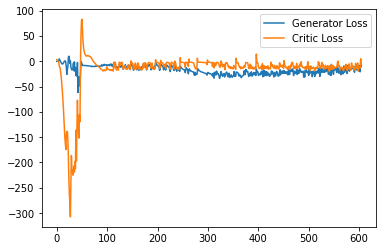

Step 12150: Generator loss: -10.970548718720675, critic loss: -9.134448588013647


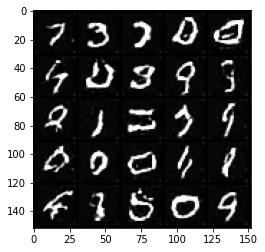

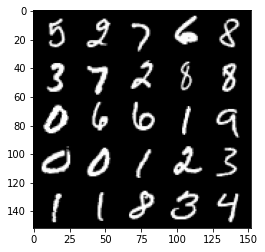

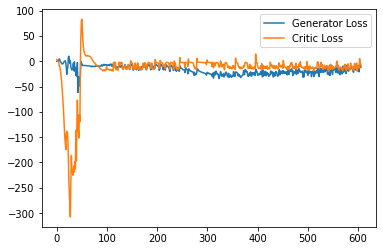

Step 12200: Generator loss: -13.16424477726221, critic loss: -8.706185840368274


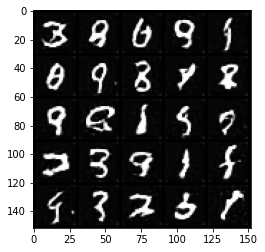

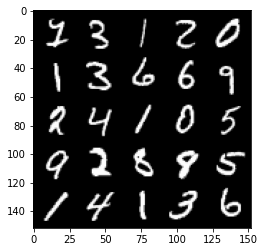

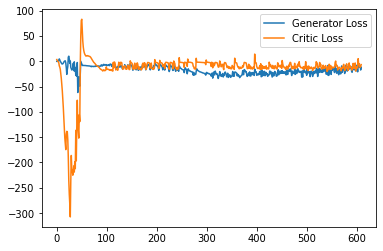

Step 12250: Generator loss: -16.59382342040539, critic loss: -15.414149556159975


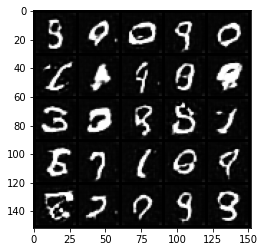

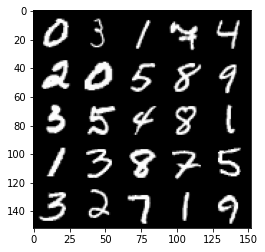

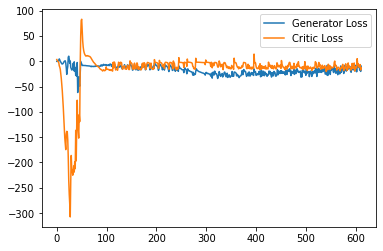

Step 12300: Generator loss: -12.32442232966423, critic loss: -11.315569606423376


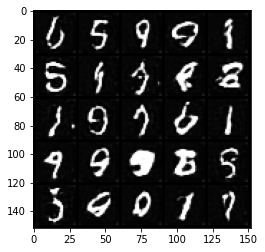

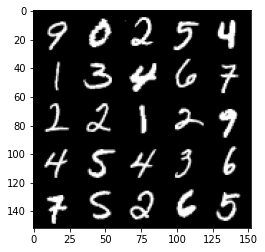

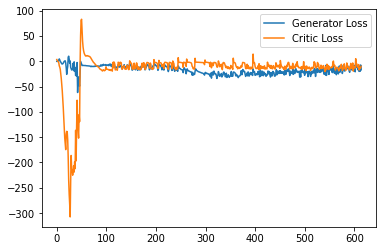

Step 12350: Generator loss: -15.23425887644291, critic loss: -12.454567830801011


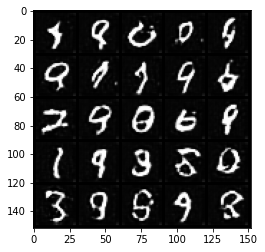

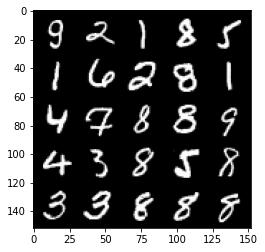

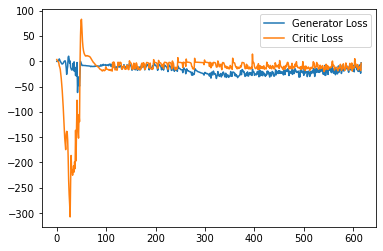

Step 12400: Generator loss: -7.159476759433747, critic loss: -15.002055954217912


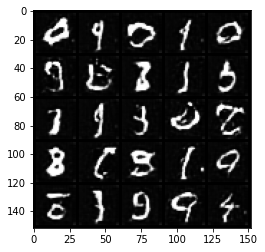

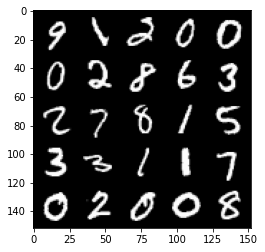

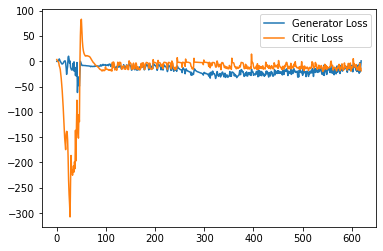

Step 12450: Generator loss: -20.99496552467346, critic loss: -12.984470849990846


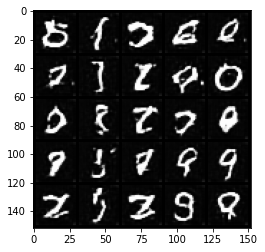

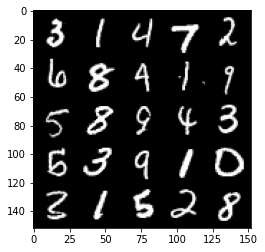

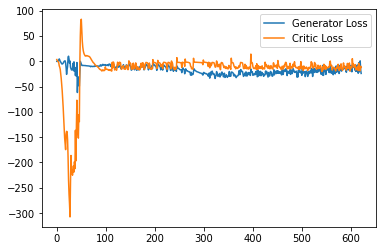

Step 12500: Generator loss: -16.72562224149704, critic loss: -15.689710659503938


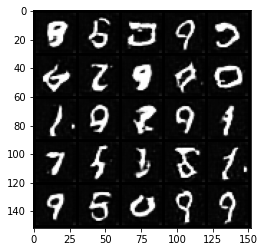

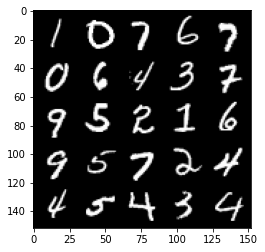

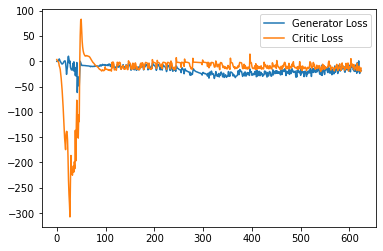

Step 12550: Generator loss: -10.800417236685753, critic loss: -4.447938196659088


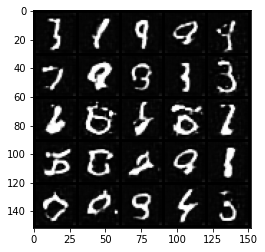

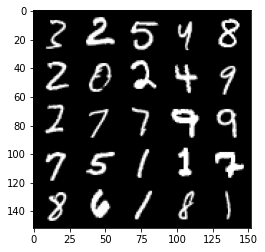

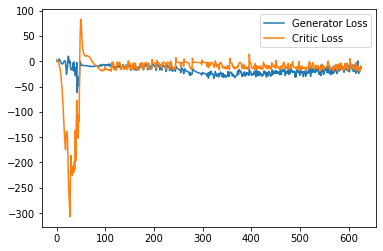

Step 12600: Generator loss: -8.370019154548645, critic loss: -7.092125954389572


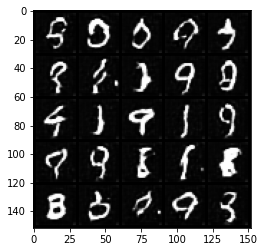

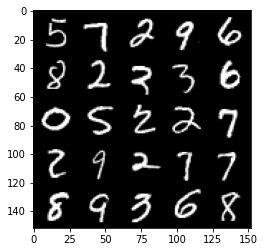

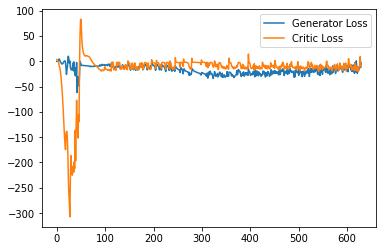

Step 12650: Generator loss: -18.61590145111084, critic loss: -18.163946245670317


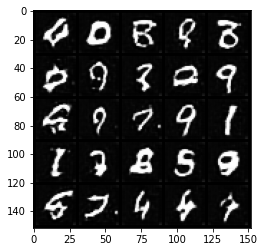

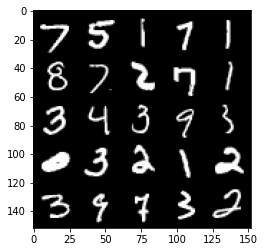

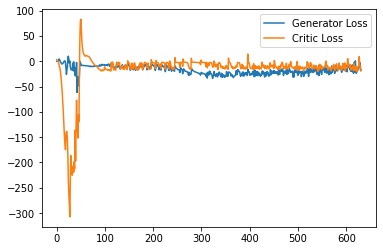

Step 12700: Generator loss: -8.335718214511871, critic loss: -12.245166384458539


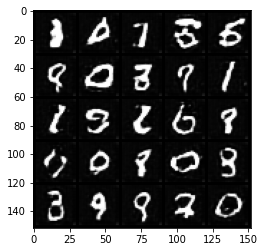

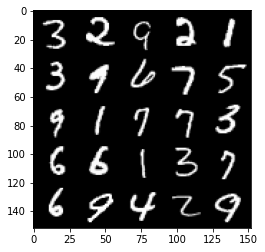

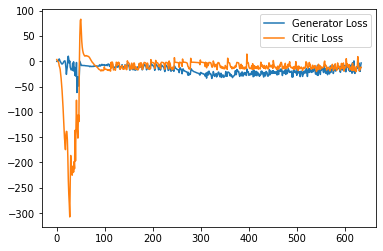

Step 12750: Generator loss: -9.547586523294449, critic loss: -9.658136756896972


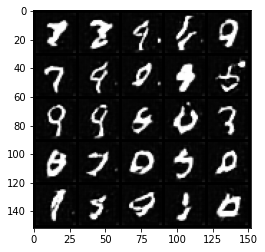

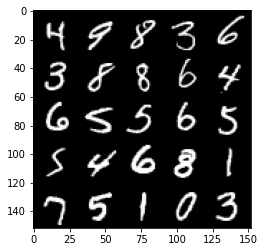

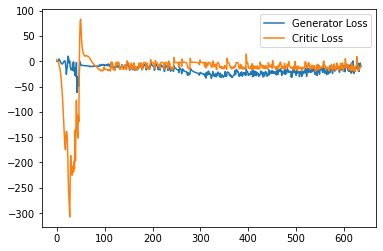

Step 12800: Generator loss: -11.194202250242233, critic loss: -12.485504705905914


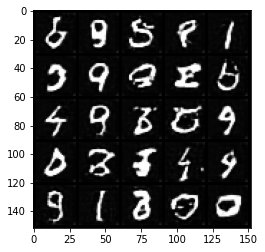

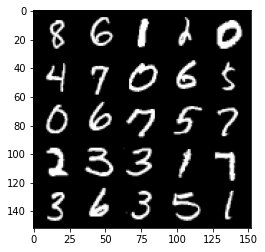

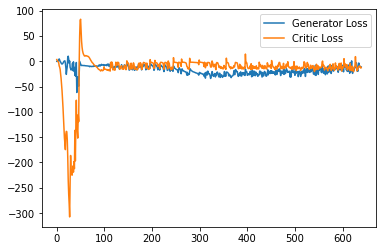

Step 12850: Generator loss: -19.121932094097136, critic loss: -16.37499552297592


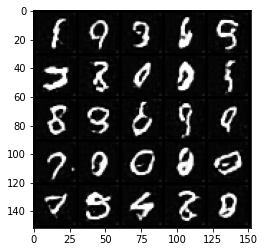

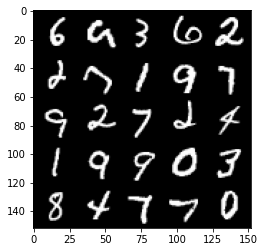

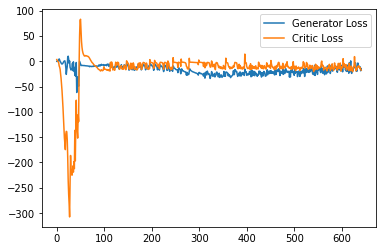

Step 12900: Generator loss: -7.361978434324264, critic loss: -11.771817696094512


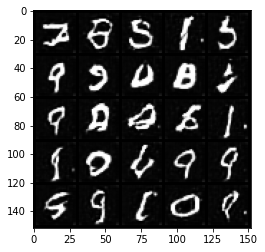

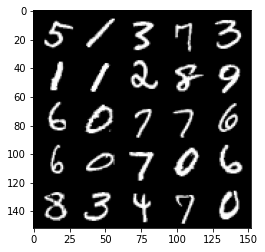

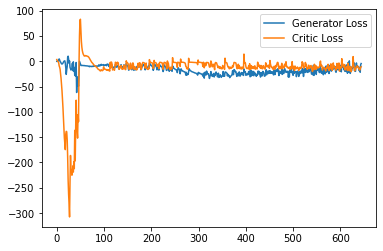

Step 12950: Generator loss: -17.488984689712524, critic loss: -12.020720552682874


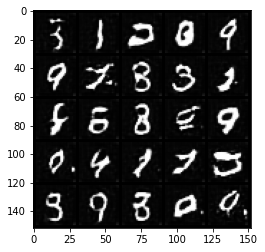

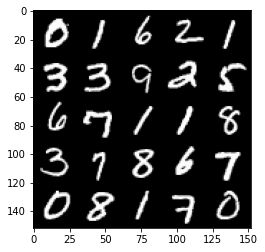

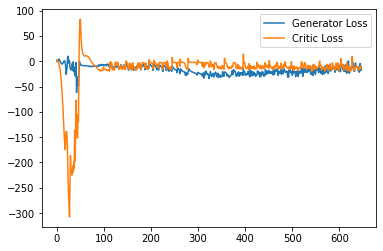

Step 13000: Generator loss: -12.091673309803008, critic loss: -15.325133655786518


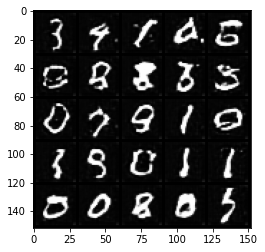

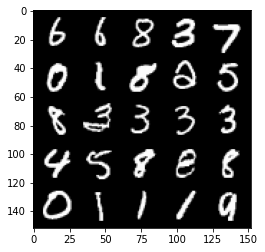

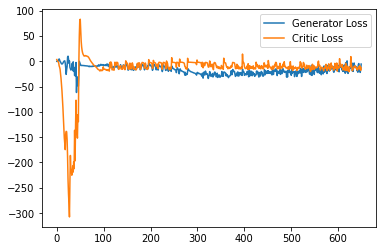

Step 13050: Generator loss: -9.109239526987075, critic loss: -9.993592702150346


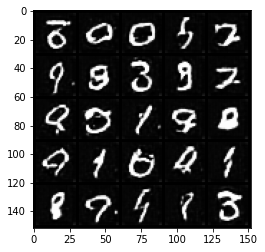

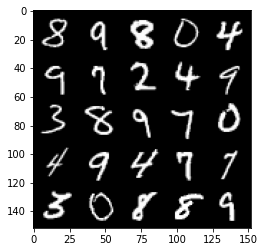

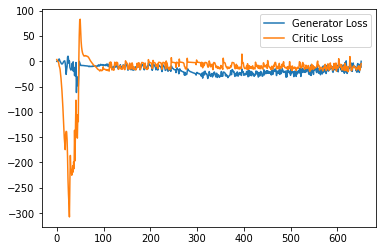

KeyboardInterrupt: 

In [29]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
